In [9]:
# Import libraries
import numpy as np
import pandas as pd
from obspy import read
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import os
import pywt

In [10]:
cat_directory = './data/lunar/training/catalogs/'
cat_file = cat_directory + 'apollo12_catalog_GradeA_final.csv'
cat = pd.read_csv(cat_file)
cat

,filename,time_abs(%Y-%m-%dT%H:%M:%S.%f),time_rel(sec),evid,mq_type
0,xa.s12.00.mhz.1970-01-19HR00_evid00002,1970-01-19T20:25:00.000000,73500.0,evid00002,impact_mq
1,xa.s12.00.mhz.1970-03-25HR00_evid00003,1970-03-25T03:32:00.000000,12720.0,evid00003,impact_mq
2,xa.s12.00.mhz.1970-03-26HR00_evid00004,1970-03-26T20:17:00.000000,73020.0,evid00004,impact_mq
3,xa.s12.00.mhz.1970-04-25HR00_evid00006,1970-04-25T01:14:00.000000,4440.0,evid00006,impact_mq
4,xa.s12.00.mhz.1970-04-26HR00_evid00007,1970-04-26T14:29:00.000000,52140.0,evid00007,deep_mq
...,...,...,...,...,...
71,xa.s12.00.mhz.1974-10-14HR00_evid00156,1974-10-14T17:43:00.000000,63780.0,evid00156,impact_mq
72,xa.s12.00.mhz.1975-04-12HR00_evid00191,1975-04-12T18:15:00.000000,65700.0,evid00191,impact_mq
73,xa.s12.00.mhz.1975-05-04HR00_evid00192,1975-05-04T10:05:00.000000,36300.0,evid00192,impact_mq
74,xa.s12.00.mhz.1975-06-24HR00_evid00196,1975-06-24T16:03:00.000000,57780.0,evid00196,impact_mq


In [11]:
row = cat.iloc[6]
arrival_time = datetime.strptime(row['time_abs(%Y-%m-%dT%H:%M:%S.%f)'],'%Y-%m-%dT%H:%M:%S.%f')
arrival_time

datetime.datetime(1970, 6, 26, 20, 1)

In [12]:
# If we want the value of relative time, we don't need to use datetime
arrival_time_rel = row['time_rel(sec)']
arrival_time_rel

72060.0

In [13]:
# Let's also get the name of the file
test_filename = row.filename
test_filename

'xa.s12.00.mhz.1970-06-26HR00_evid00009'

In [14]:
data_directory = './data/lunar/training/data/S12_GradeA/'
csv_file = f'{data_directory}{test_filename}.csv'
data_cat = pd.read_csv(csv_file)
data_cat

,time_abs(%Y-%m-%dT%H:%M:%S.%f),time_rel(sec),velocity(m/s)
0,1970-06-26T00:00:00.116000,0.000000,-6.727977e-16
1,1970-06-26T00:00:00.266943,0.150943,-8.646711e-16
2,1970-06-26T00:00:00.417887,0.301887,-9.298738e-16
3,1970-06-26T00:00:00.568830,0.452830,-8.589095e-16
4,1970-06-26T00:00:00.719774,0.603774,-7.139047e-16
...,...,...,...
572418,1970-06-27T00:00:02.832981,86402.716981,5.039820e-17
572419,1970-06-27T00:00:02.983925,86402.867925,-9.191068e-18
572420,1970-06-27T00:00:03.134868,86403.018868,-2.796955e-17
572421,1970-06-27T00:00:03.285811,86403.169811,-9.037156e-17


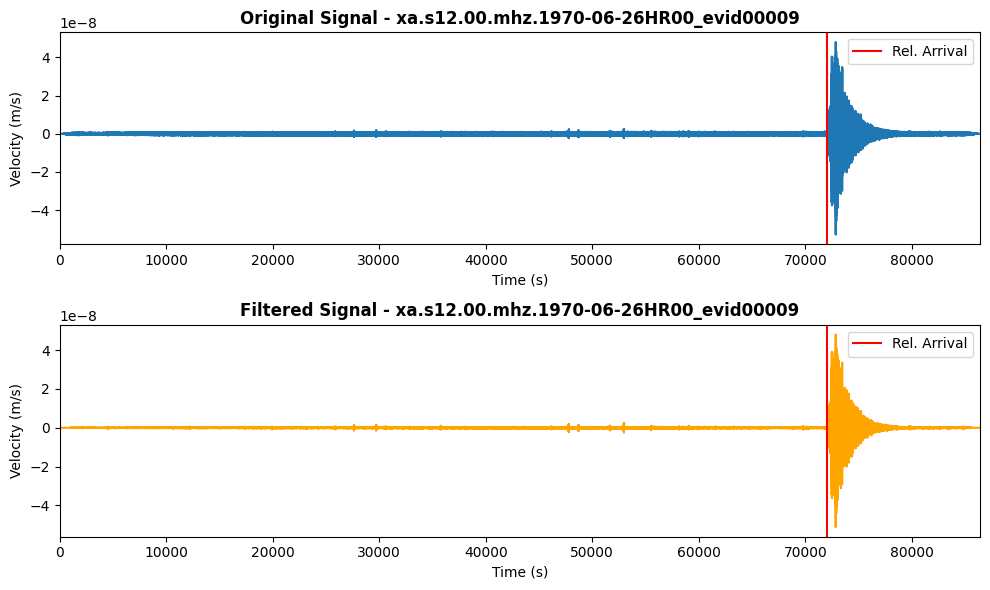

In [15]:
# Read in time steps and velocities
csv_times = np.array(data_cat['time_rel(sec)'].tolist())
csv_data = np.array(data_cat['velocity(m/s)'].tolist()) 

# Apply Wavelet filter using 'db4' wavelet and higher level decomposition
wavelet = 'db4'
level = 5  # Increased level of decomposition to capture more details
coeffs = pywt.wavedec(csv_data, wavelet, level=level)

# Set threshold for noise reduction based on the standard deviation of coefficients
threshold = np.std(coeffs[-level]) * 0.5  # Threshold proportional to noise level

# Apply soft thresholding to the coefficients
coeffs_filt = [pywt.threshold(c, threshold, mode='soft') for c in coeffs]

# Reconstruct the signal after filtering
csv_data_filt = pywt.waverec(coeffs_filt, wavelet)

# Ensure the filtered data length matches the original data length
csv_data_filt = csv_data_filt[:len(csv_data)]  # Truncate or adjust length

# Plot the original and filtered trace
fig, ax = plt.subplots(2, 1, figsize=(10, 6))

# Original data plot
ax[0].plot(csv_times, csv_data, label='Original Data')
ax[0].set_xlim([min(csv_times), max(csv_times)])
ax[0].set_ylabel('Velocity (m/s)')
ax[0].set_xlabel('Time (s)')
ax[0].set_title(f'Original Signal - {test_filename}', fontweight='bold')

# Plot arrival time on original signal
arrival_line = ax[0].axvline(x=arrival_time_rel, c='red', label='Rel. Arrival')
ax[0].legend(handles=[arrival_line])

# Filtered data plot
ax[1].plot(csv_times, csv_data_filt, color='orange', label='Filtered Data')
ax[1].set_xlim([min(csv_times), max(csv_times)])
ax[1].set_ylabel('Velocity (m/s)')
ax[1].set_xlabel('Time (s)')
ax[1].set_title(f'Filtered Signal - {test_filename}', fontweight='bold')

# Plot arrival time on filtered signal
arrival_line = ax[1].axvline(x=arrival_time_rel, c='red', label='Rel. Arrival')
ax[1].legend(handles=[arrival_line])

plt.tight_layout()
plt.show()


In [16]:
# Importar las bibliotecas necesarias
import numpy as np
import pandas as pd
import pywt
import matplotlib.pyplot as plt
from datetime import datetime
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.callbacks import EarlyStopping

# Directorio de catálogo y carga del archivo de entrenamiento
cat_directory = './data/lunar/training/catalogs/'
cat_file = cat_directory + 'apollo12_catalog_GradeA_final.csv'
cat = pd.read_csv(cat_file)
row = cat.iloc[6]
arrival_time_rel = row['time_rel(sec)']  # Tiempo relativo de llegada
test_filename = row.filename
data_directory = './data/lunar/training/data/S12_GradeA/'
csv_file = f'{data_directory}{test_filename}.csv'
data_cat = pd.read_csv(csv_file)


Epoch 1/50


/Users/Alduino/Desktop/space_apps_2024_seismic_detection/.venv/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


16098/16098 ━━━━━━━━━━━━━━━━━━━━ 277s 17ms/step - accuracy: 0.9992 - loss: 0.0041 - val_accuracy: 1.0000 - val_loss: 2.9088e-05
Epoch 2/50
16098/16098 ━━━━━━━━━━━━━━━━━━━━ 277s 17ms/step - accuracy: 0.9999 - loss: 0.0012 - val_accuracy: 1.0000 - val_loss: 4.1289e-05
Epoch 3/50
16098/16098 ━━━━━━━━━━━━━━━━━━━━ 265s 16ms/step - accuracy: 0.9999 - loss: 0.0011 - val_accuracy: 1.0000 - val_loss: 4.2215e-05
Epoch 4/50
16098/16098 ━━━━━━━━━━━━━━━━━━━━ 323s 20ms/step - accuracy: 0.9999 - loss: 0.0010 - val_accuracy: 1.0000 - val_loss: 3.5703e-05
Epoch 5/50
16098/16098 ━━━━━━━━━━━━━━━━━━━━ 278s 17ms/step - accuracy: 0.9999 - loss: 9.2698e-04 - val_accuracy: 1.0000 - val_loss: 1.6036e-04
Epoch 6/50
16098/16098 ━━━━━━━━━━━━━━━━━━━━ 285s 18ms/step - accuracy: 0.9999 - loss: 0.0011 - val_accuracy: 1.0000 - val_loss: 5.6140e-05
17887/17887 ━━━━━━━━━━━━━━━━━━━━ 69s 4ms/step - accuracy: 0.9998 - loss: 0.0018
Accuracy: 0.9999
17887/17887 ━━━━━━━━━━━━━━━━━━━━ 75s 4ms/step


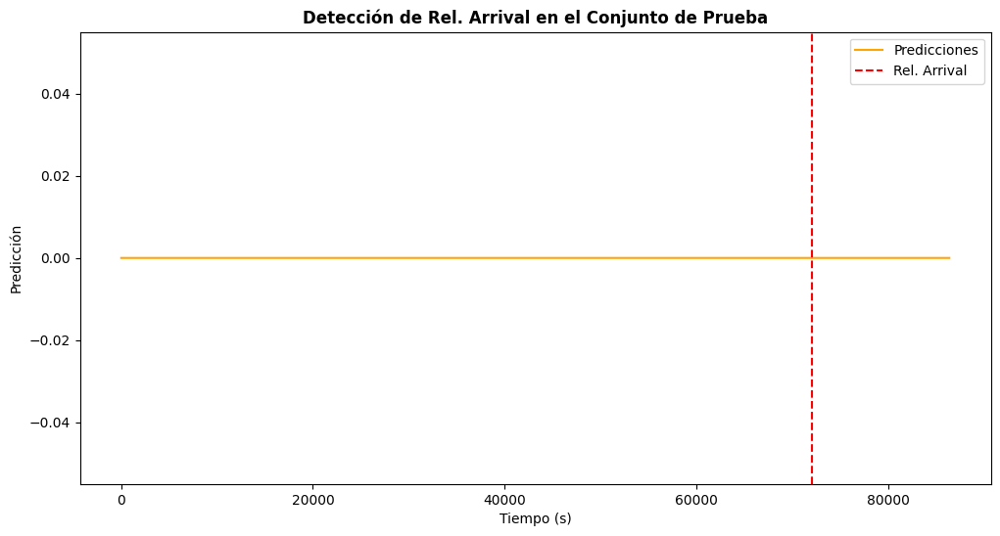

In [17]:

# Leer pasos de tiempo y velocidades del conjunto de entrenamiento
csv_times = np.array(data_cat['time_rel(sec)'].tolist())
csv_data = np.array(data_cat['velocity(m/s)'].tolist())

# Aplicar Wavelet filter usando 'db4' wavelet
wavelet = 'db4'
level = 5
coeffs = pywt.wavedec(csv_data, wavelet, level=level)
threshold = np.std(coeffs[-level]) * 0.5
coeffs_filt = [pywt.threshold(c, threshold, mode='soft') for c in coeffs]
csv_data_filt = pywt.waverec(coeffs_filt, wavelet)[:len(csv_data)]

# Normalizar los datos
scaler = MinMaxScaler()
csv_data_filt_scaled = scaler.fit_transform(csv_data_filt.reshape(-1, 1))

# Crear etiquetas para la detección de "Rel. Arrival"
window_size = 50  # Tamaño de la ventana para la RNN
X_train, y_train = [], []

# Llenar datos de entrenamiento
for i in range(len(csv_data_filt_scaled) - window_size):
    X_train.append(csv_data_filt_scaled[i:i + window_size])
    # Etiqueta 1 si está dentro de la ventana; de lo contrario, 0
    y_train.append(1 if (i < arrival_time_rel < i + window_size) else 0)

X_train, y_train = np.array(X_train), np.array(y_train)

# Cargar datos de prueba desde otra carpeta
test_directory = './data/lunar/test/data/S12_GradeB/'  # Modifica este directorio según sea necesario
test_filename = 'xa.s12.00.mhz.1969-12-16HR00_evid00006.csv'  # Cambia esto por el nombre real del archivo de prueba
csv_test_file = f'{test_directory}{test_filename}'
data_cat_test = pd.read_csv(csv_test_file)

# Leer pasos de tiempo y velocidades del conjunto de prueba
csv_times_test = np.array(data_cat_test['time_rel(sec)'].tolist())
csv_data_test = np.array(data_cat_test['velocity(m/s)'].tolist())

# Aplicar el mismo procesamiento a los datos de prueba
coeffs_test = pywt.wavedec(csv_data_test, wavelet, level=level)
coeffs_filt_test = [pywt.threshold(c, threshold, mode='soft') for c in coeffs_test]
csv_data_filt_test = pywt.waverec(coeffs_filt_test, wavelet)[:len(csv_data_test)]
csv_data_filt_test_scaled = scaler.transform(csv_data_filt_test.reshape(-1, 1))

X_test, y_test = [], []

# Llenar datos de prueba
for i in range(len(csv_data_filt_test_scaled) - window_size):
    X_test.append(csv_data_filt_test_scaled[i:i + window_size])
    # Etiqueta 1 si está dentro de la ventana; de lo contrario, 0
    y_test.append(1 if (i < arrival_time_rel < i + window_size) else 0)

X_test, y_test = np.array(X_test), np.array(y_test)

# Definir la RNN
model = Sequential()
model.add(LSTM(50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model.add(Dropout(0.2))
model.add(LSTM(50))
model.add(Dropout(0.2))
model.add(Dense(1, activation='sigmoid'))  # Activación sigmoide para salida binaria

# Compilar el modelo
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Entrenar el modelo
early_stopping = EarlyStopping(monitor='val_loss', patience=5)
model.fit(X_train, y_train, validation_split=0.1, epochs=50, batch_size=32, callbacks=[early_stopping])

# Evaluar el modelo
loss, accuracy = model.evaluate(X_test, y_test)
print(f'Accuracy: {accuracy:.4f}')

# Hacer predicciones
predictions = model.predict(X_test)
predictions = (predictions > 0.5).astype(int)  # Convertir a etiquetas binarias

# Visualizar las predicciones
plt.figure(figsize=(12, 6))
plt.plot(csv_times_test[window_size:], predictions, label='Predicciones', color='orange')
plt.axvline(x=arrival_time_rel, color='red', linestyle='--', label='Rel. Arrival')
plt.title('Detección de Rel. Arrival en el Conjunto de Prueba', fontweight='bold')
plt.xlabel('Tiempo (s)')
plt.ylabel('Predicción')
plt.legend()
plt.show()



In [18]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Cargar los datos del catálogo
cat_directory = './data/lunar/training/catalogs/'
cat_file = cat_directory + 'apollo12_catalog_GradeA_final.csv'
cat = pd.read_csv(cat_file)

# Cargar los datos de la señal sísmica de entrenamiento
data_train_directory = './data/lunar/training/data/S12_GradeA/'

# Listas para almacenar los datos de entrenamiento cargados
all_train_csv_times = []
all_train_csv_data = []
arrival_times = []  # Lista para almacenar los tiempos de llegada

# Iterar sobre cada fila en el catálogo para cargar datos de entrenamiento
for index, row in cat.iterrows():
    test_filename = row['filename'].strip()  # Limpiar cualquier espacio en blanco
    arrival_time_rel = row['time_rel(sec)']  # Tiempo de llegada

    # Crear la ruta completa del archivo CSV
    csv_file = f'{data_train_directory}{test_filename}.csv'
    
    try:
        # Cargar el archivo CSV correspondiente
        data_cat = pd.read_csv(csv_file)

        # Leer pasos de tiempo y velocidades
        csv_times = np.array(data_cat['time_rel(sec)'].tolist())
        csv_data = np.array(data_cat['velocity(m/s)'].tolist())
        
        # Almacenar los datos en las listas
        all_train_csv_times.append(csv_times)
        all_train_csv_data.append(csv_data)
        arrival_times.append(arrival_time_rel)  # Añadir tiempo de llegada
        
        print(f'Cargado (Entrenamiento): {test_filename}')
    
    except FileNotFoundError:
        print(f'Archivo no encontrado (Entrenamiento): {csv_file}')
    except Exception as e:
        print(f'Error al procesar (Entrenamiento) {csv_file}: {e}')

# Convertir las listas a arreglos de NumPy
all_train_csv_times = np.array(all_train_csv_times)
all_train_csv_data = np.array(all_train_csv_data)
arrival_times = np.array(arrival_times)




Cargado (Entrenamiento): xa.s12.00.mhz.1970-01-19HR00_evid00002
Cargado (Entrenamiento): xa.s12.00.mhz.1970-03-25HR00_evid00003
Cargado (Entrenamiento): xa.s12.00.mhz.1970-03-26HR00_evid00004
Cargado (Entrenamiento): xa.s12.00.mhz.1970-04-25HR00_evid00006
Cargado (Entrenamiento): xa.s12.00.mhz.1970-04-26HR00_evid00007
Cargado (Entrenamiento): xa.s12.00.mhz.1970-06-15HR00_evid00008
Cargado (Entrenamiento): xa.s12.00.mhz.1970-06-26HR00_evid00009
Cargado (Entrenamiento): xa.s12.00.mhz.1970-07-20HR00_evid00010
Cargado (Entrenamiento): xa.s12.00.mhz.1970-07-20HR00_evid00011
Cargado (Entrenamiento): xa.s12.00.mhz.1970-09-26HR00_evid00013
Cargado (Entrenamiento): xa.s12.00.mhz.1970-10-24HR00_evid00014
Cargado (Entrenamiento): xa.s12.00.mhz.1970-11-12HR00_evid00015
Cargado (Entrenamiento): xa.s12.00.mhz.1970-12-11HR00_evid00017
Cargado (Entrenamiento): xa.s12.00.mhz.1970-12-27HR00_evid00019
Cargado (Entrenamiento): xa.s12.00.mhz.1970-12-31HR00_evid00021
Cargado (Entrenamiento): xa.s12.00.mhz.1

ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (76,) + inhomogeneous part.

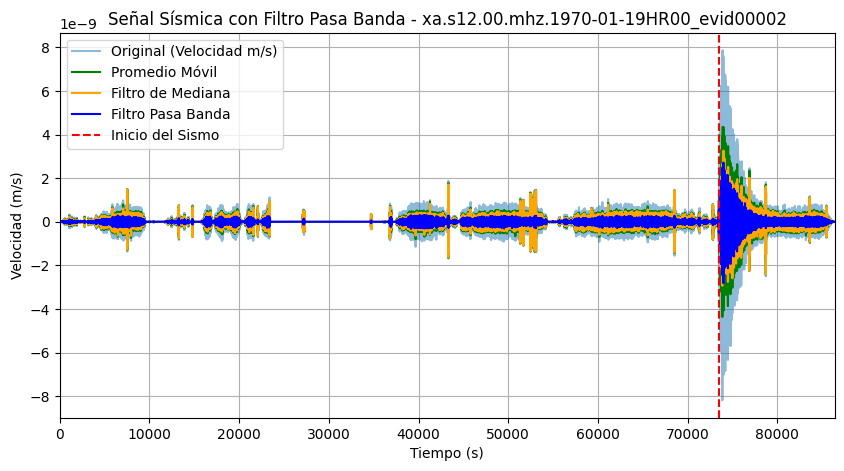

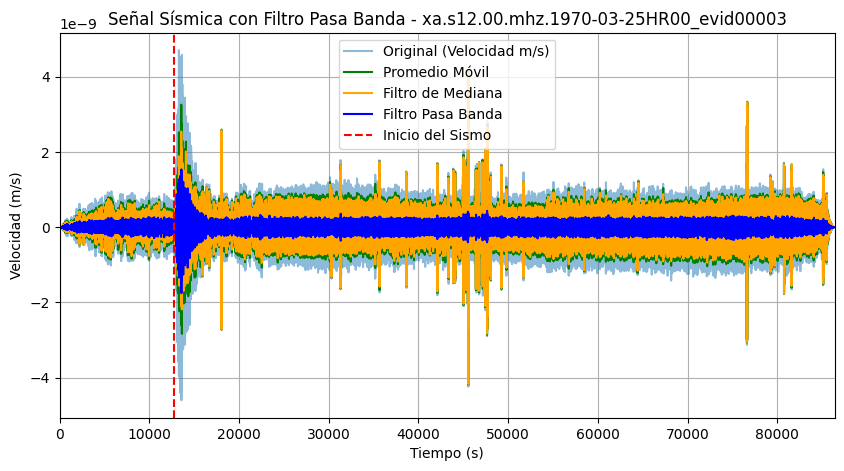

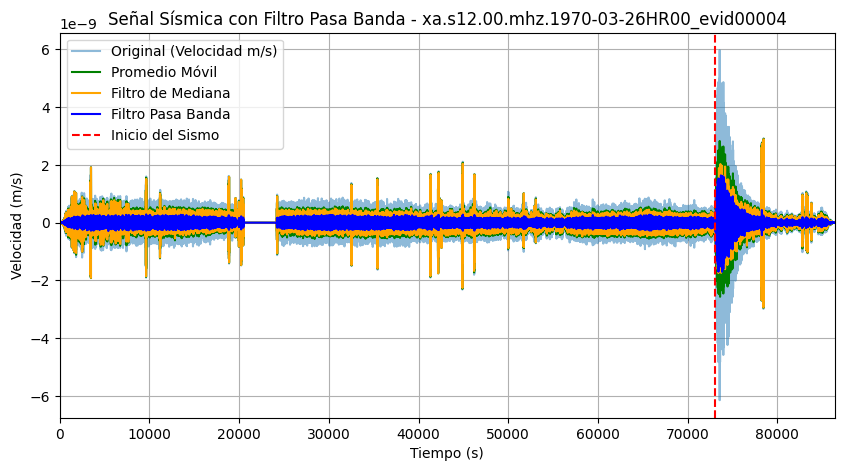

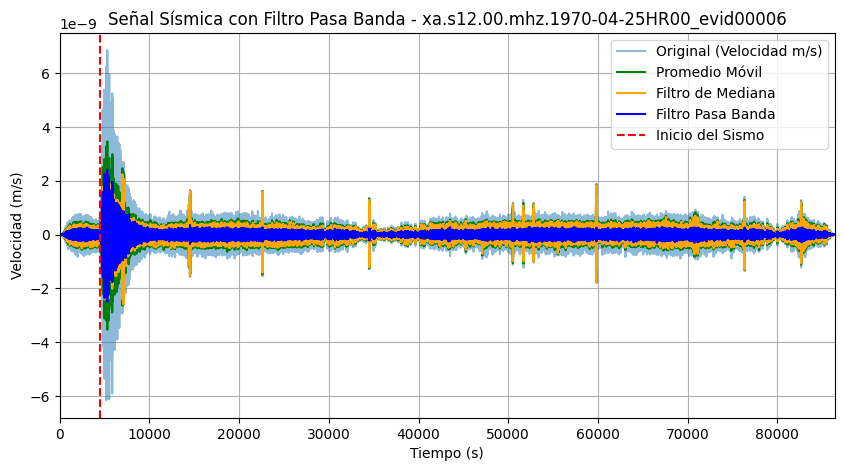

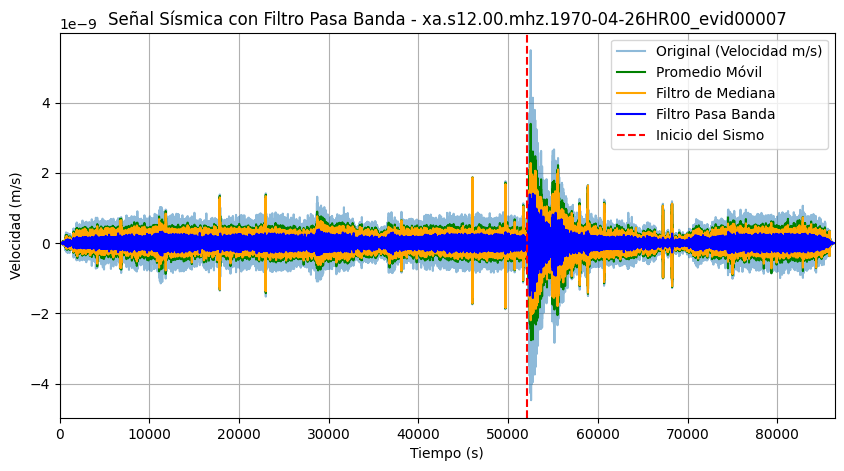

...

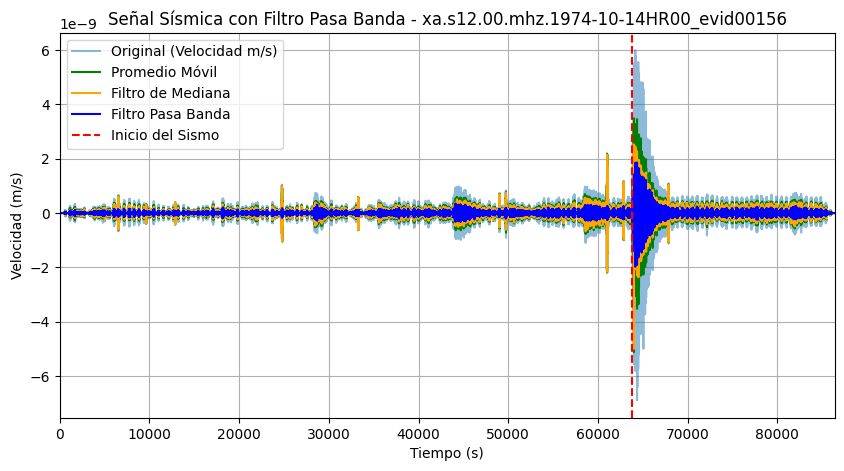

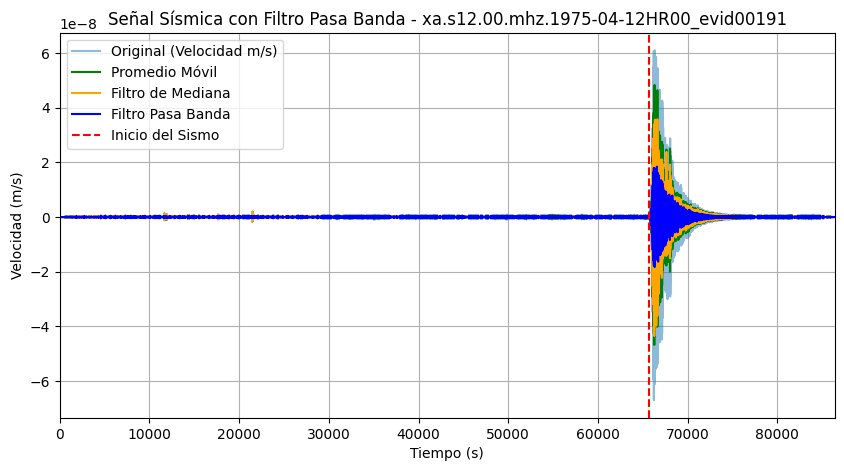

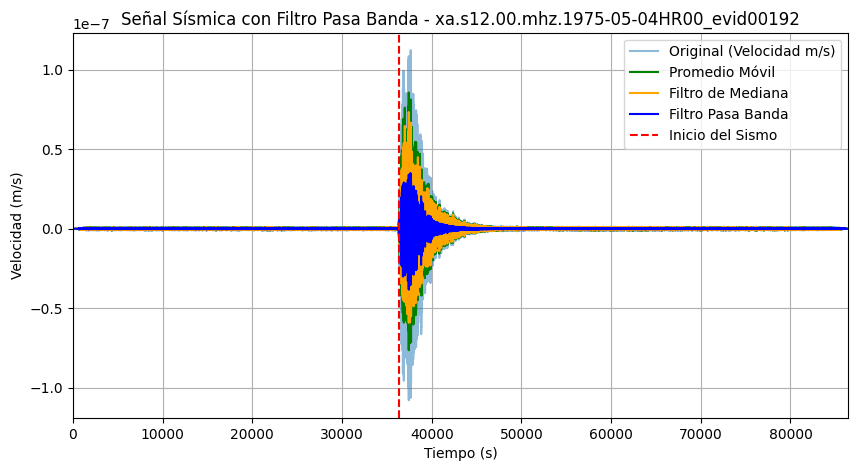

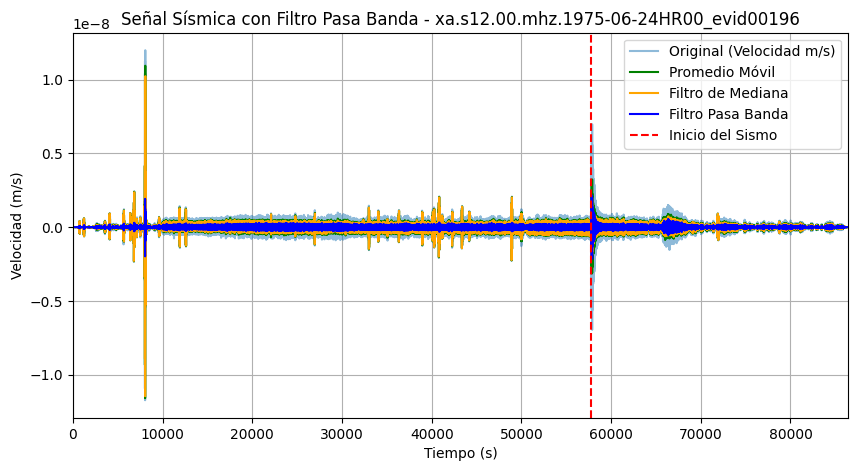

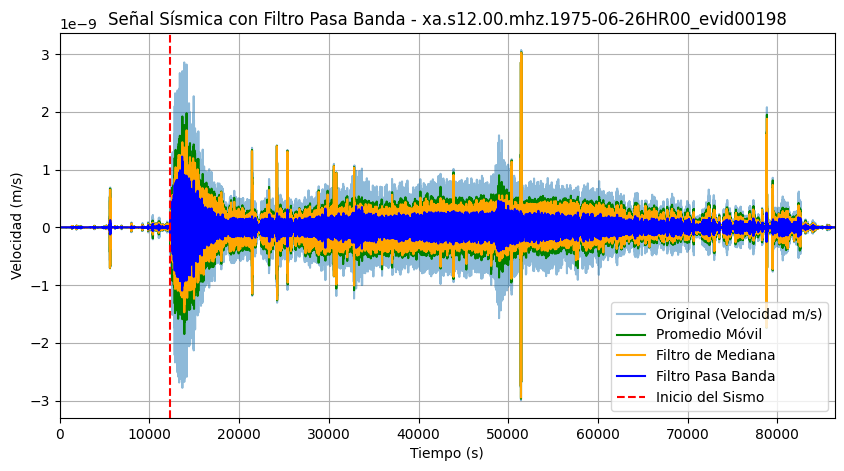

In [19]:
from scipy.signal import medfilt, butter, filtfilt
import numpy as np
import matplotlib.pyplot as plt

# Definir el tamaño de la ventana del promedio móvil
window_size = 5  # Ajusta según sea necesario

# Definir el tamaño del kernel para el filtro de mediana
kernel_size = 5  # Ajusta el tamaño del kernel del filtro de mediana según sea necesario

# Función para aplicar un filtro pasa banda
def bandpass_filter(data, lowcut, highcut, fs, order=2):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, data)

# Definir las frecuencias del filtro pasa banda
lowcut = 0.5  # Frecuencia de corte inferior
highcut = 1.0  # Frecuencia de corte superior
fs = 1.0 / (all_train_csv_times[0][1] - all_train_csv_times[0][0])  # Frecuencia de muestreo

# Graficar cada señal sísmica con promedio móvil, filtro de mediana, y filtro pasa banda
for i in range(len(all_train_csv_data)):
    # Aplicar el filtro de promedio móvil
    smoothed_data = np.convolve(all_train_csv_data[i], np.ones(window_size)/window_size, mode='same')
    
    # Aplicar el filtro de mediana sobre el resultado del promedio móvil
    smoothed_data_median = medfilt(smoothed_data, kernel_size=kernel_size)
    
    # Aplicar el filtro pasa banda
    filtered_data = bandpass_filter(smoothed_data_median, lowcut, highcut, fs)

    plt.figure(figsize=(10, 5))
    
    # Graficar la señal original
    plt.plot(all_train_csv_times[i], all_train_csv_data[i], label='Original (Velocidad m/s)', alpha=0.5)
    
    # Graficar la señal suavizada con promedio móvil
    plt.plot(all_train_csv_times[i], smoothed_data, label='Promedio Móvil', color='green')
    
    # Graficar la señal suavizada con mediana
    plt.plot(all_train_csv_times[i], smoothed_data_median, label='Filtro de Mediana', color='orange')
    
    # Graficar la señal filtrada con el filtro pasa banda
    plt.plot(all_train_csv_times[i], filtered_data, label='Filtro Pasa Banda', color='blue')
    
    # Agregar la línea de llegada del sismo
    plt.axvline(x=arrival_times[i], color='red', linestyle='--', label='Inicio del Sismo')
    
    # Títulos y etiquetas
    plt.title(f'Señal Sísmica con Filtro Pasa Banda - {cat.iloc[i]["filename"].strip()}')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Velocidad (m/s)')
    plt.xlim([min(all_train_csv_times[i]), max(all_train_csv_times[i])])  # Ajustar los límites del eje x
    plt.legend()
    plt.grid()
    
    # Mostrar la gráfica
    plt.show()



In [20]:
# con las columnas del original
from scipy.signal import butter, filtfilt, gaussian
import numpy as np
import matplotlib.pyplot as plt
import os

# Definir el tamaño de la ventana del promedio móvil
window_size = 5  # Ajusta según sea necesario

# Función para aplicar un filtro pasa banda
def bandpass_filter(data, lowcut, highcut, fs, order=2):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, data)

# Función para aplicar un filtro gaussiano
def gaussian_filter(data, sigma=1):
    kernel_size = int(4 * sigma + 1)
    kernel = gaussian(kernel_size, std=sigma)
    kernel /= np.sum(kernel)  # Normalizar el kernel
    return np.convolve(data, kernel, mode='same')

# Definir las frecuencias del filtro pasa banda
lowcut = 0.5  # Frecuencia de corte inferior
highcut = 1.0  # Frecuencia de corte superior
fs = 1.0 / (all_train_csv_times[0][1] - all_train_csv_times[0][0])  # Frecuencia de muestreo

# Crear la carpeta para guardar los datos filtrados si no existe
output_folder = 'data_filtrada'
os.makedirs(output_folder, exist_ok=True)

# Graficar cada señal sísmica
for i in range(len(all_train_csv_data)):
    # Aplicar el filtro de promedio móvil
    smoothed_data = np.convolve(all_train_csv_data[i], np.ones(window_size)/window_size, mode='same')
    
    # Aplicar el filtro pasa banda
    filtered_data = bandpass_filter(smoothed_data, lowcut, highcut, fs)

    # Aplicar filtro gaussiano
    smoothed_gaussian = gaussian_filter(filtered_data, sigma=1)

    # Aplicar segundo filtro de promedio móvil con ventana de 5
    final_smoothed_data = np.convolve(smoothed_gaussian, np.ones(5)/5, mode='same')

    # Calcular el tiempo absoluto y el tiempo relativo
    time_abs = all_train_csv_times[i]
    time_rel = time_abs - time_abs[0]  # Tiempo relativo desde el inicio

    # Preparar los datos para guardar en el CSV
    data_to_save = np.column_stack((time_abs, time_rel, final_smoothed_data))

    plt.figure(figsize=(10, 5))
    
    # Graficar la señal original
    plt.plot(all_train_csv_times[i], all_train_csv_data[i], label='Original (Velocidad m/s)', alpha=0.5)
    
    # Graficar la señal suavizada con promedio móvil
    plt.plot(all_train_csv_times[i], smoothed_data, label='Promedio Móvil', color='green')
    
    # Graficar la señal filtrada con el filtro pasa banda
    plt.plot(all_train_csv_times[i], filtered_data, label='Filtro Pasa Banda', color='blue')
    
    # Graficar la señal suavizada con filtro gaussiano
    plt.plot(all_train_csv_times[i], smoothed_gaussian, label='Filtro Gaussiano', color='orange')
    
    # Graficar la señal final suavizada con el segundo promedio móvil
    plt.plot(all_train_csv_times[i], final_smoothed_data, label='Promedio Móvil Final', color='purple')

    # Agregar la línea de llegada del sismo
    plt.axvline(x=arrival_times[i], color='red', linestyle='--', label='Inicio del Sismo')
    
    # Títulos y etiquetas
    plt.title(f'Señal Sísmica con Filtros - {cat.iloc[i]["filename"].strip()}')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Velocidad (m/s)')
    plt.xlim([min(all_train_csv_times[i]), max(all_train_csv_times[i])])  # Ajustar los límites del eje x
    plt.legend()
    plt.grid()
    
    # Mostrar la gráfica
    plt.show()

    # Guardar los datos finales en un archivo CSV
    output_file = os.path.join(output_folder, f'{cat.iloc[i]["filename"].strip()}_filtrada.csv')
    np.savetxt(output_file, data_to_save, delimiter=',', 
               header='time_abs, time_rel, velocity', comments='')  # Guardar con las columnas deseadas



ImportError: cannot import name 'gaussian' from 'scipy.signal' (/Users/Alduino/Desktop/space_apps_2024_seismic_detection/.venv/lib/python3.11/site-packages/scipy/signal/__init__.py)

Procesando archivo: xa.s12.00.mhz.1970-01-19HR00_evid00002_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


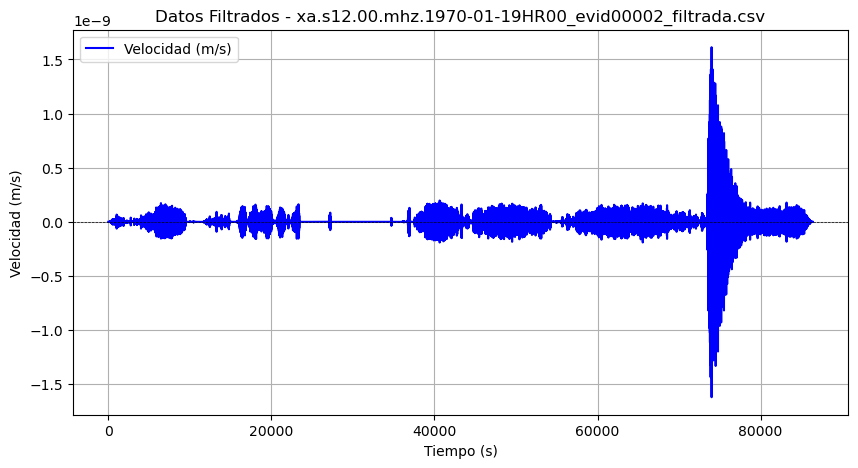

Procesando archivo: xa.s12.00.mhz.1970-03-25HR00_evid00003_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


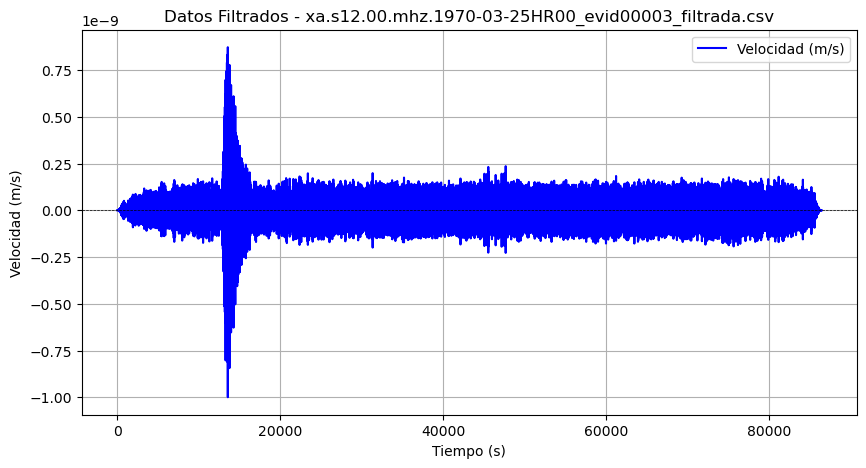

Procesando archivo: xa.s12.00.mhz.1970-03-26HR00_evid00004_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


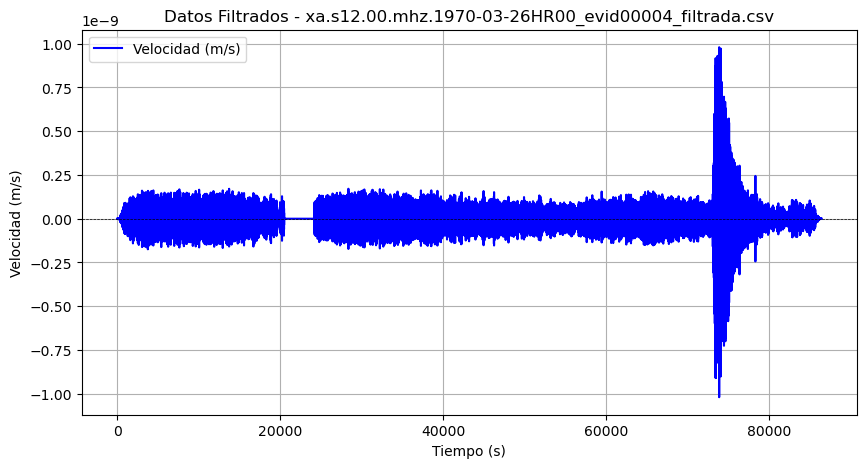

Procesando archivo: xa.s12.00.mhz.1970-04-25HR00_evid00006_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


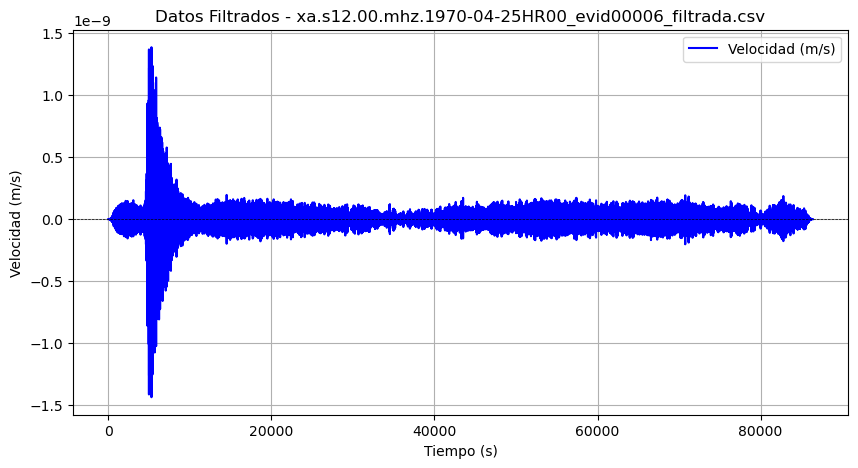

Procesando archivo: xa.s12.00.mhz.1970-04-26HR00_evid00007_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


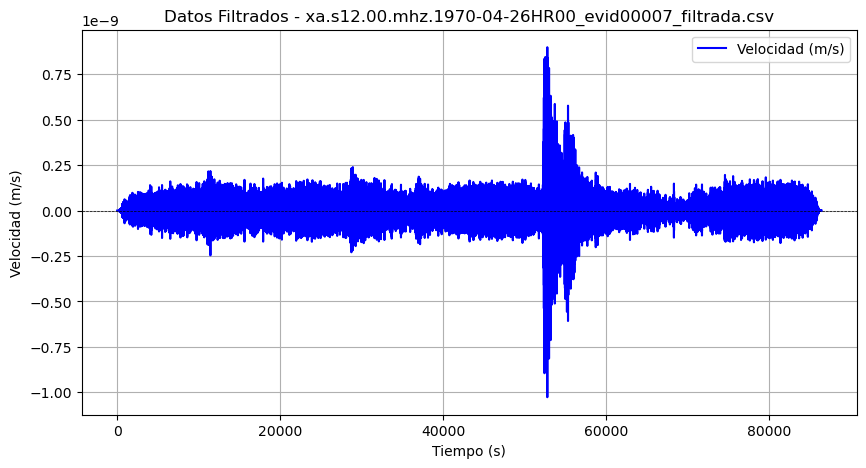

Procesando archivo: xa.s12.00.mhz.1970-06-15HR00_evid00008_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


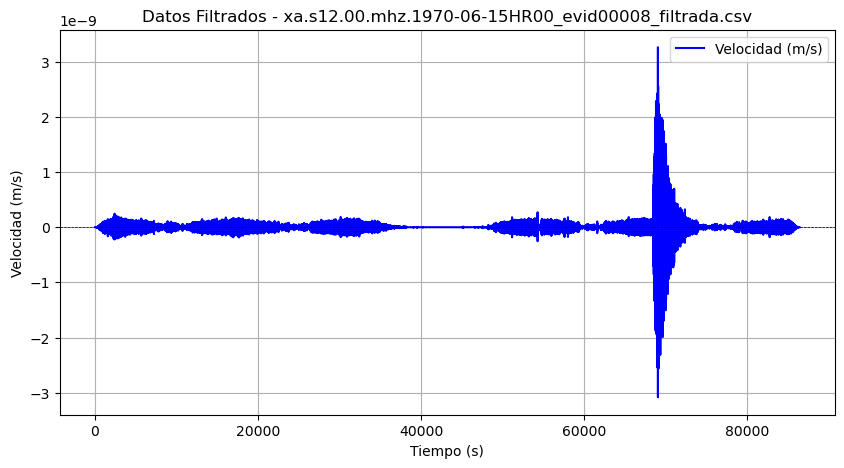

Procesando archivo: xa.s12.00.mhz.1970-06-26HR00_evid00009_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


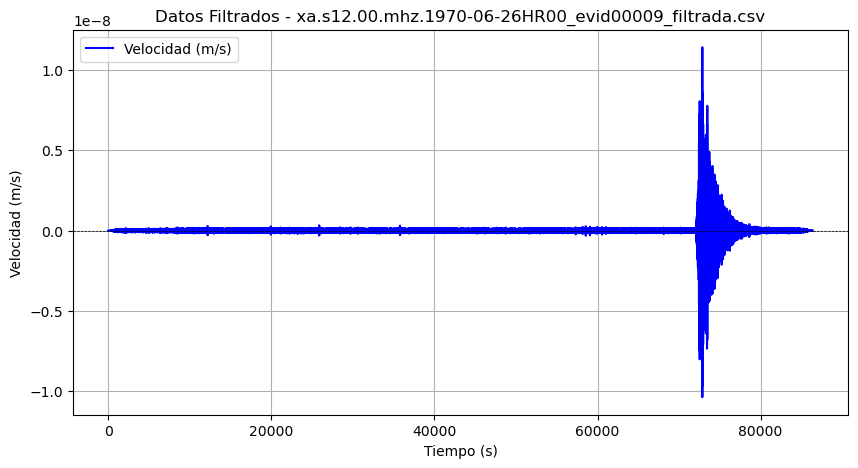

Procesando archivo: xa.s12.00.mhz.1970-07-20HR00_evid00010_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


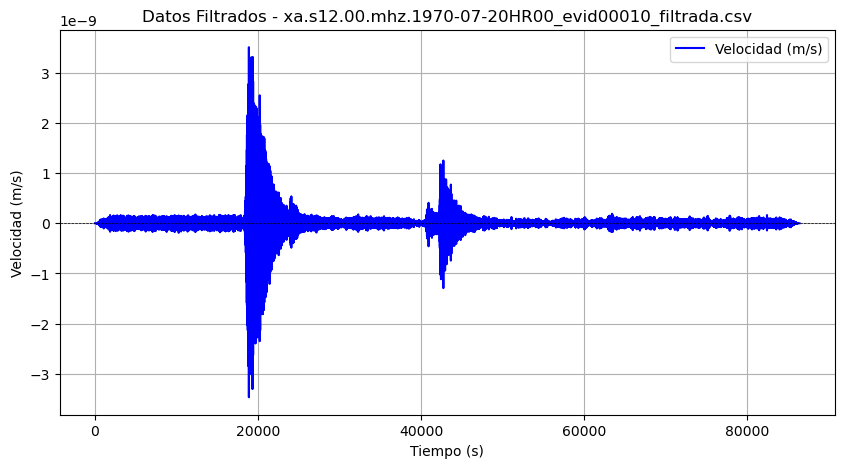

Procesando archivo: xa.s12.00.mhz.1970-07-20HR00_evid00011_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


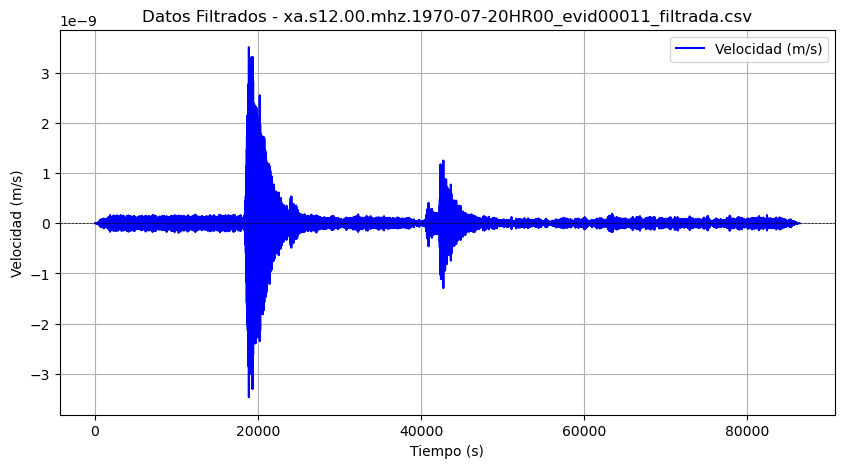

Procesando archivo: xa.s12.00.mhz.1970-09-26HR00_evid00013_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


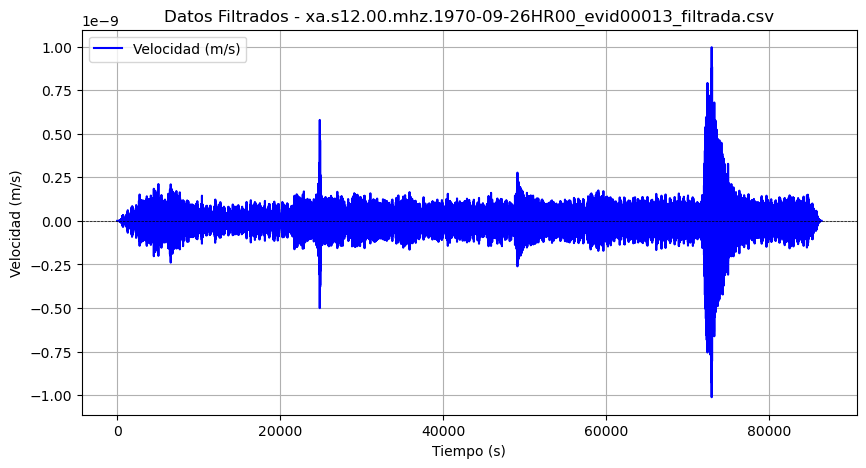

Procesando archivo: xa.s12.00.mhz.1970-10-24HR00_evid00014_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


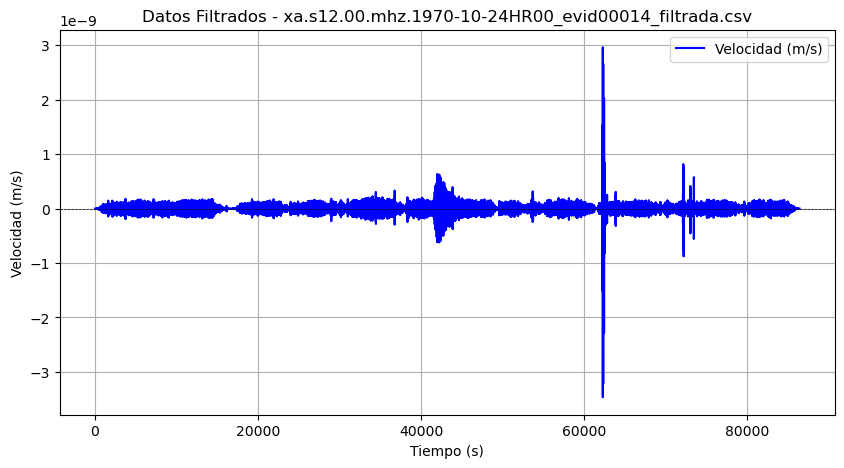

Procesando archivo: xa.s12.00.mhz.1970-11-12HR00_evid00015_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


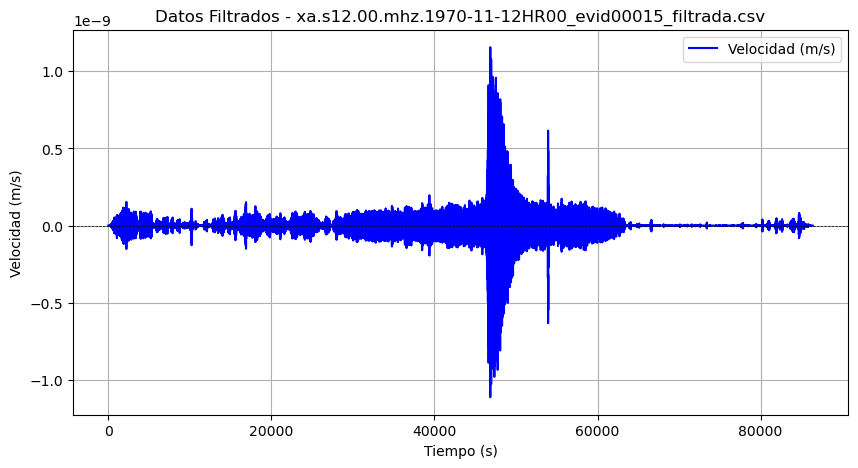

Procesando archivo: xa.s12.00.mhz.1970-12-11HR00_evid00017_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


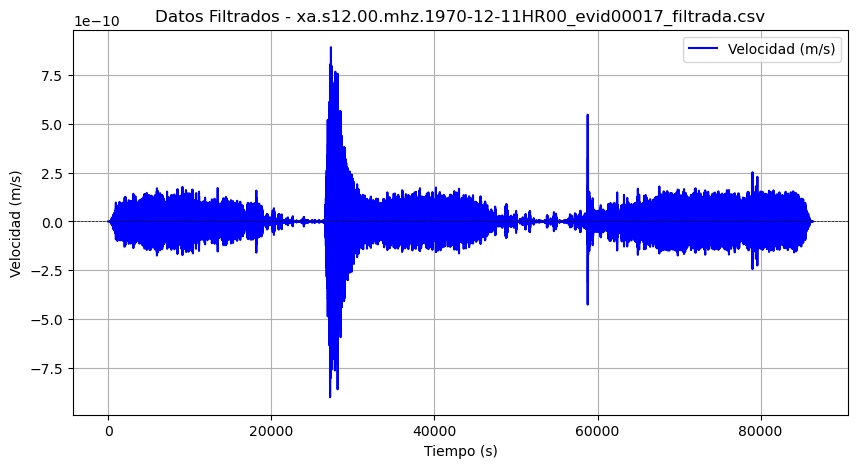

Procesando archivo: xa.s12.00.mhz.1970-12-27HR00_evid00019_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


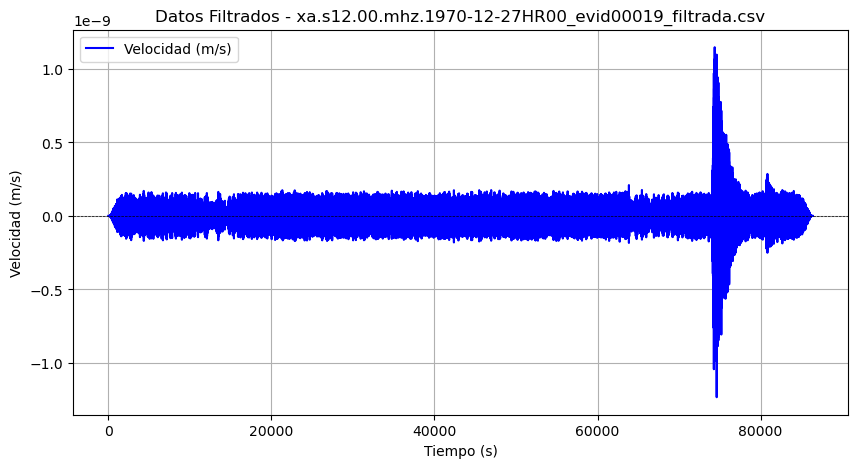

Procesando archivo: xa.s12.00.mhz.1970-12-31HR00_evid00021_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


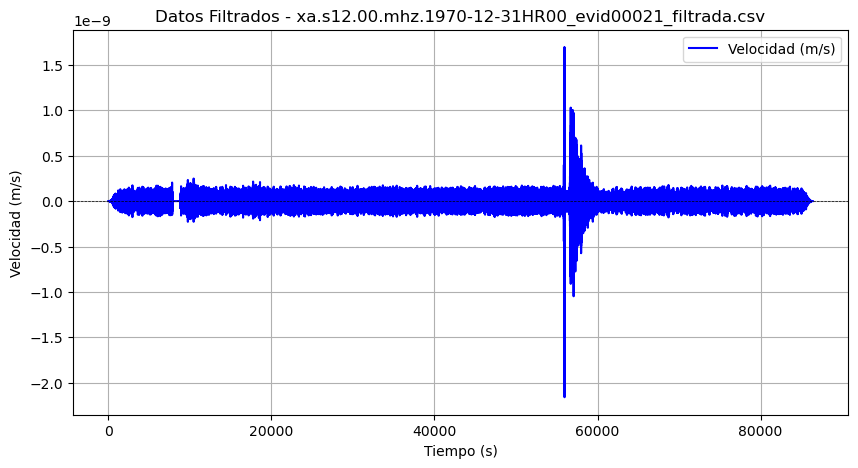

Procesando archivo: xa.s12.00.mhz.1971-01-15HR00_evid00022_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


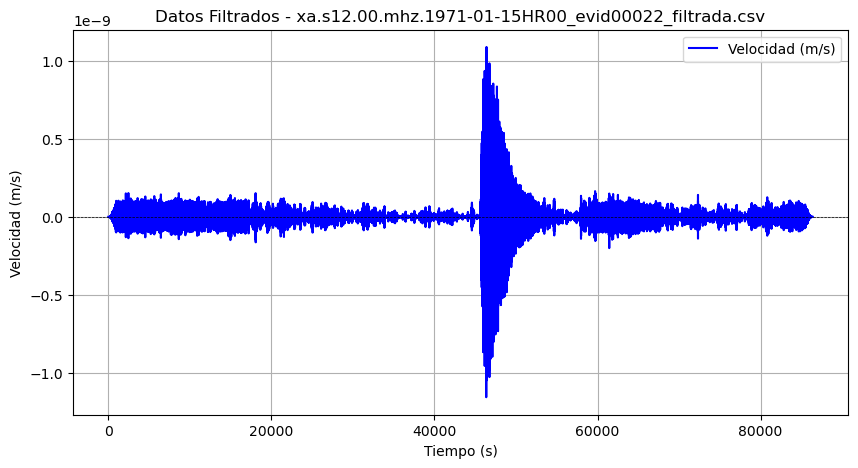

Procesando archivo: xa.s12.00.mhz.1971-01-28HR00_evid00023_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


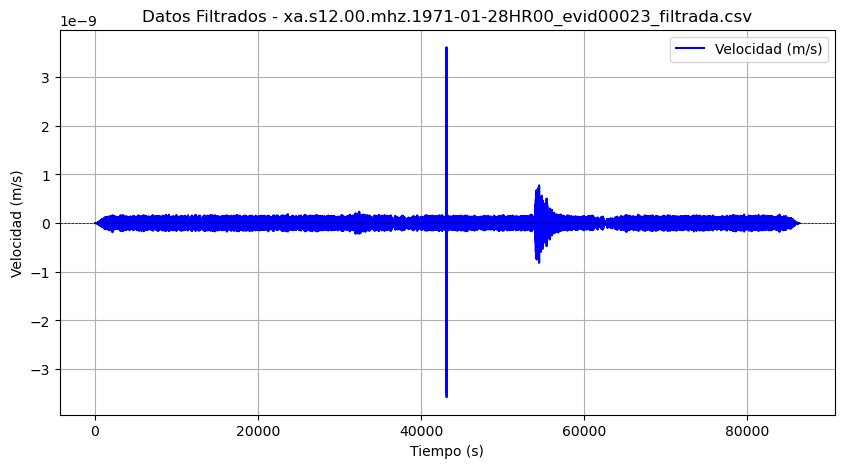

Procesando archivo: xa.s12.00.mhz.1971-01-29HR00_evid00024_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


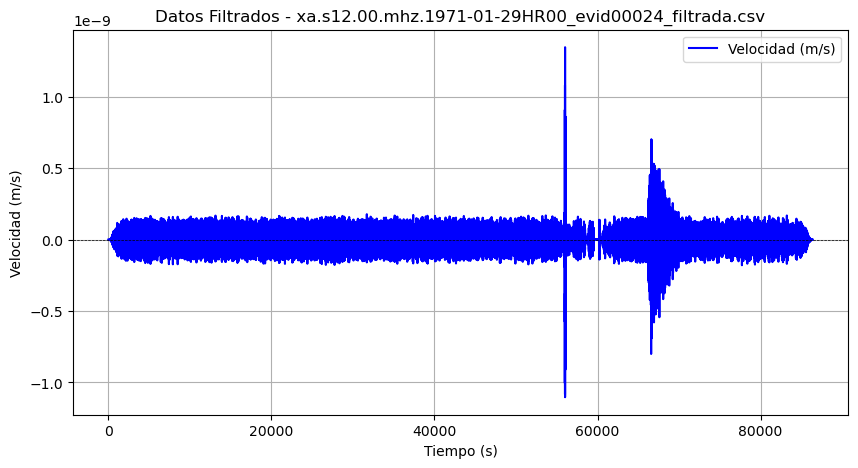

Procesando archivo: xa.s12.00.mhz.1971-02-09HR00_evid00026_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


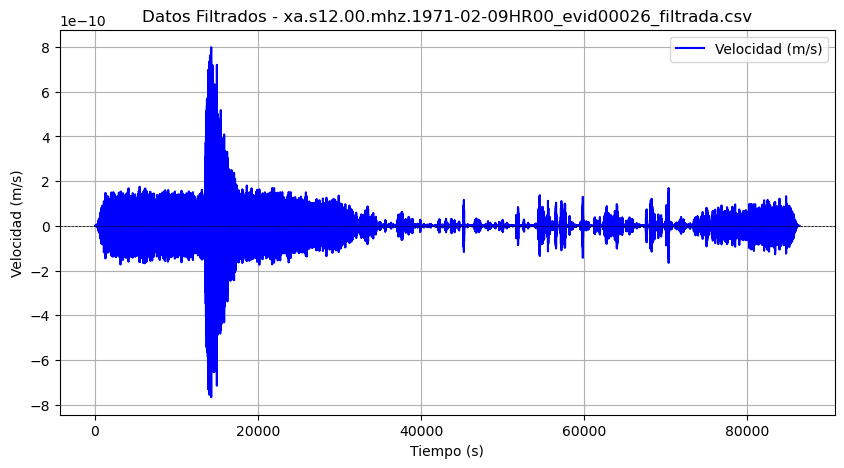

Procesando archivo: xa.s12.00.mhz.1971-03-25HR00_evid00028_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


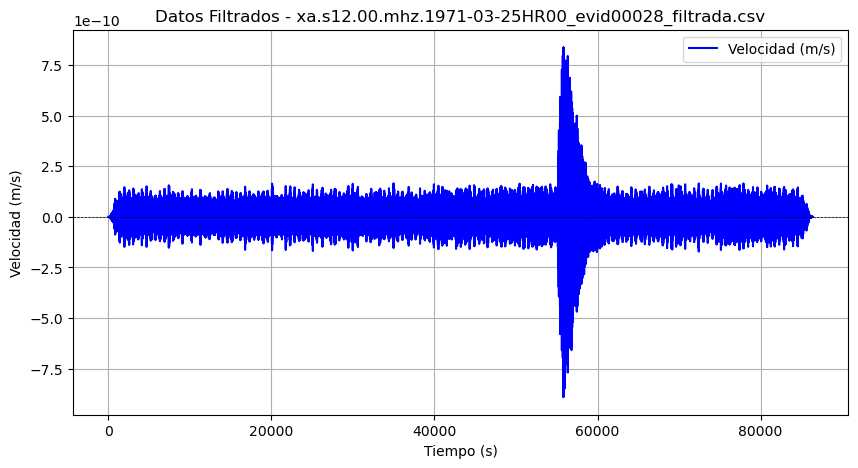

Procesando archivo: xa.s12.00.mhz.1971-04-13HR00_evid00029_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


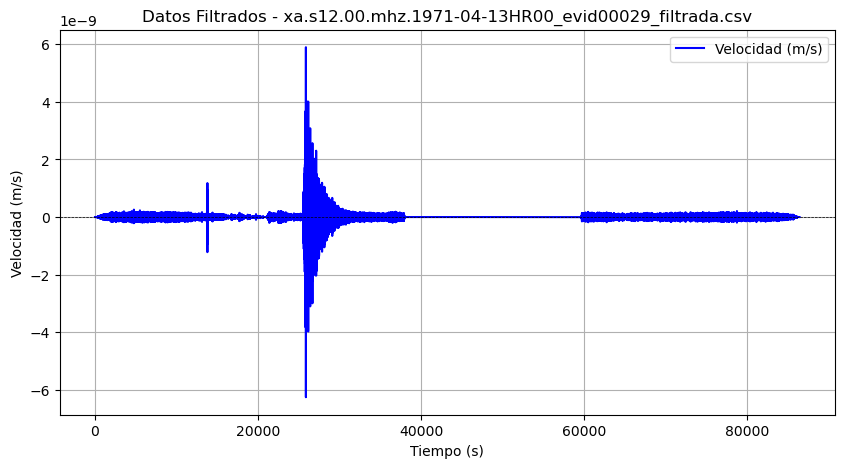

Procesando archivo: xa.s12.00.mhz.1971-04-17HR00_evid00030_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


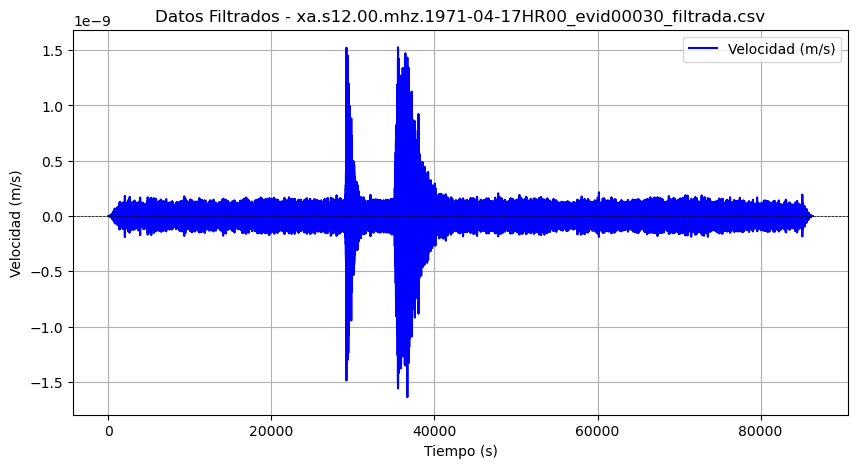

Procesando archivo: xa.s12.00.mhz.1971-05-12HR00_evid00031_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


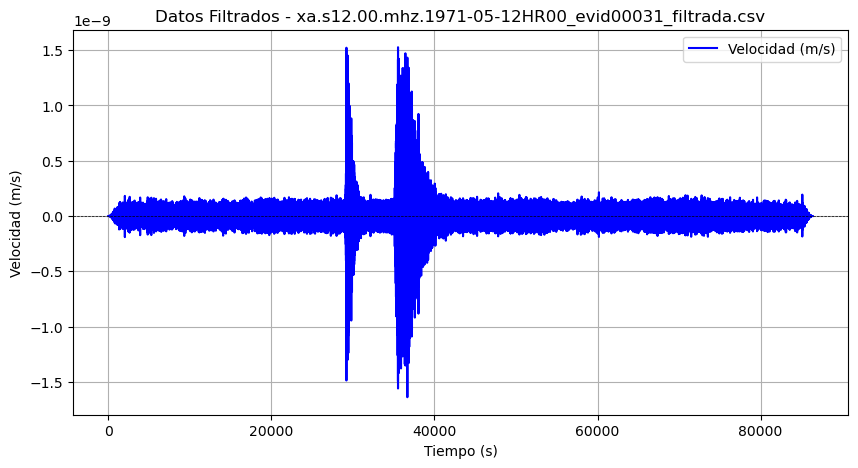

Procesando archivo: xa.s12.00.mhz.1971-05-12HR00_evid00032_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


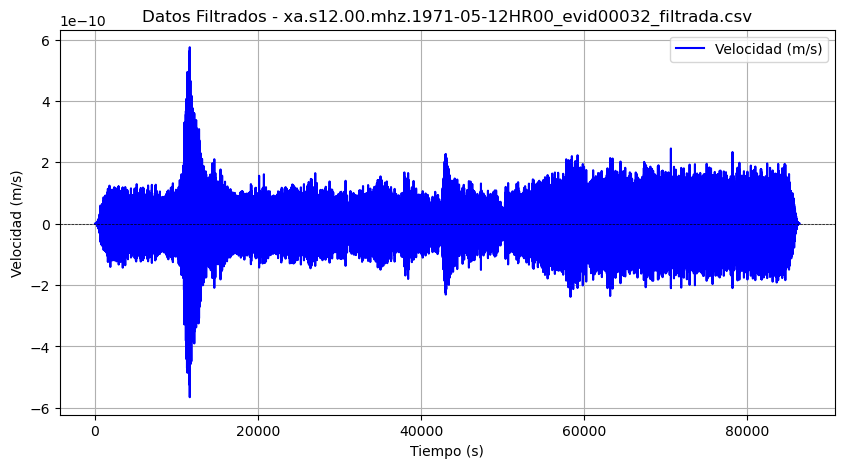

Procesando archivo: xa.s12.00.mhz.1971-05-13HR00_evid00033_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


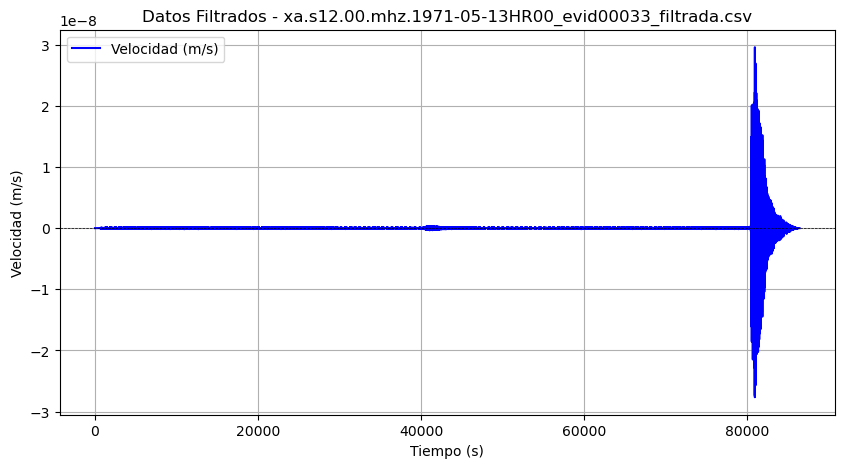

Procesando archivo: xa.s12.00.mhz.1971-05-23HR00_evid00034_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


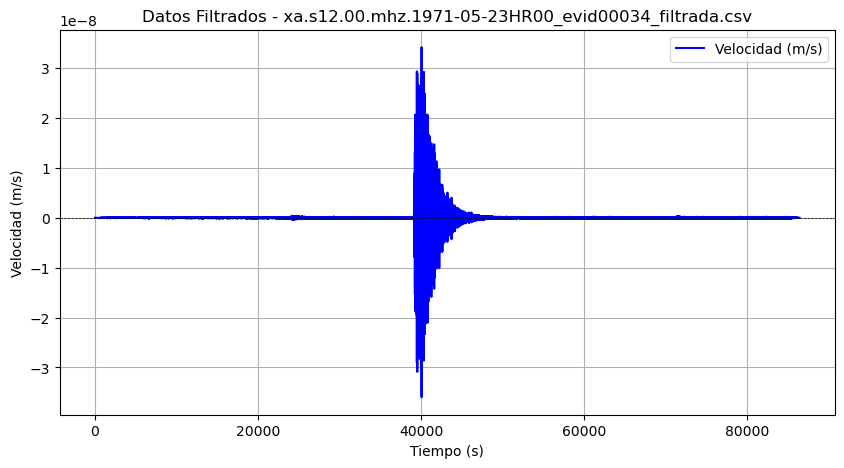

Procesando archivo: xa.s12.00.mhz.1971-06-12HR00_evid00035_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


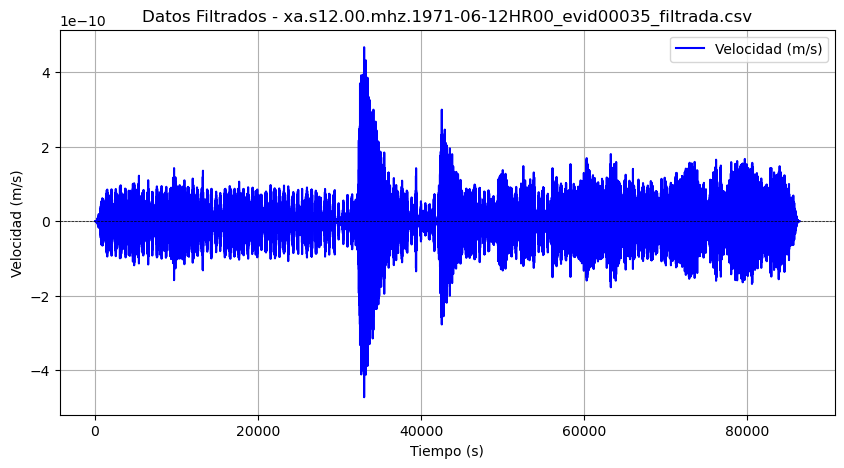

Procesando archivo: xa.s12.00.mhz.1971-09-25HR00_evid00042_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


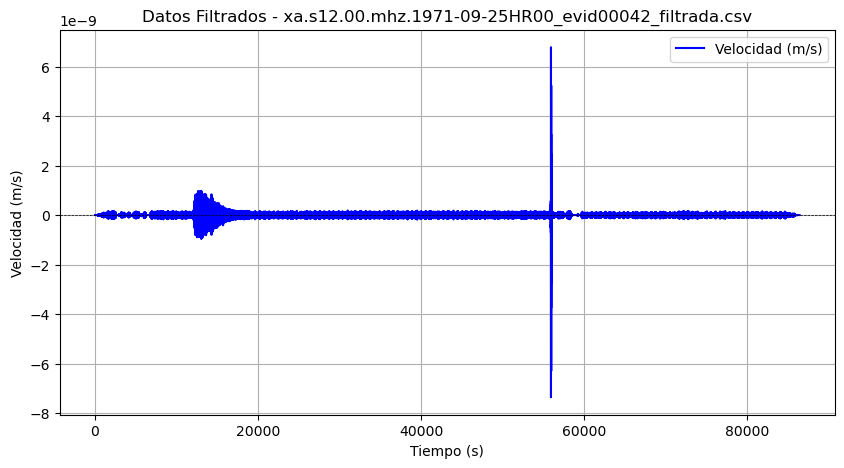

Procesando archivo: xa.s12.00.mhz.1971-10-18HR00_evid00043_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


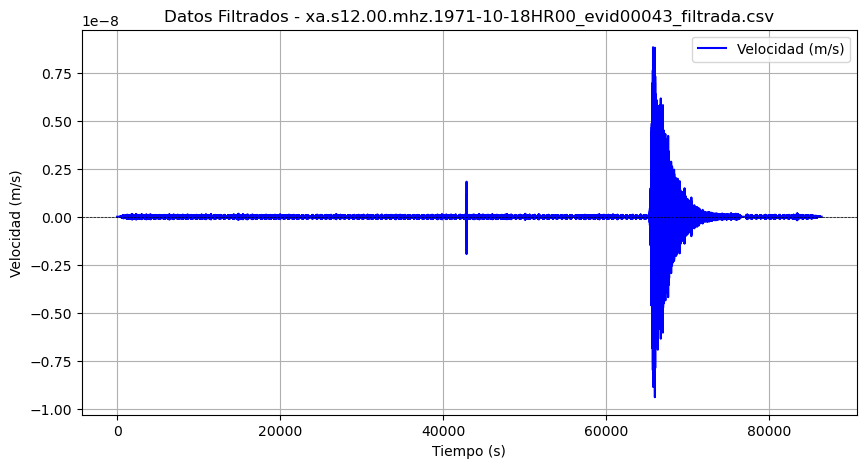

Procesando archivo: xa.s12.00.mhz.1971-10-20HR00_evid00044_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


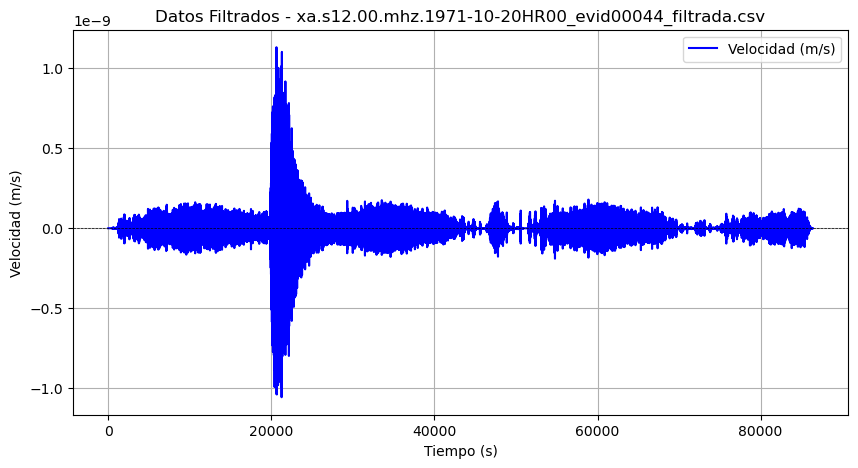

Procesando archivo: xa.s12.00.mhz.1971-10-31HR00_evid00045_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


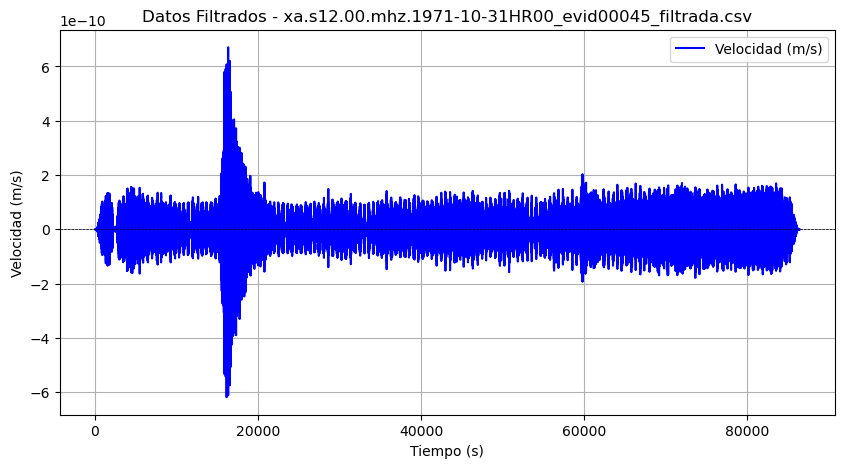

Procesando archivo: xa.s12.00.mhz.1971-11-14HR00_evid00046_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


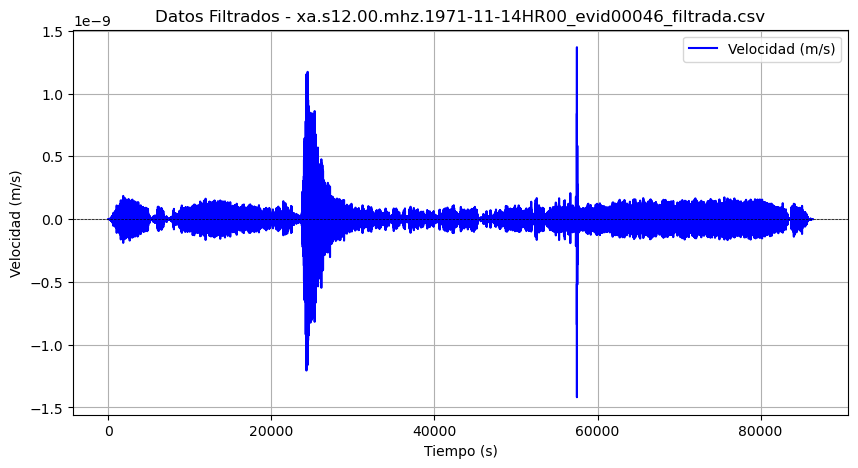

Procesando archivo: xa.s12.00.mhz.1972-01-04HR00_evid00049_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


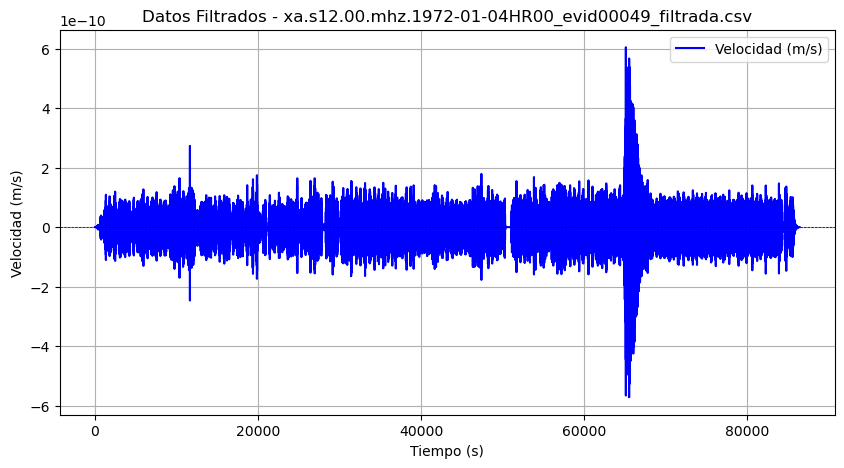

Procesando archivo: xa.s12.00.mhz.1972-03-12HR00_evid00052_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


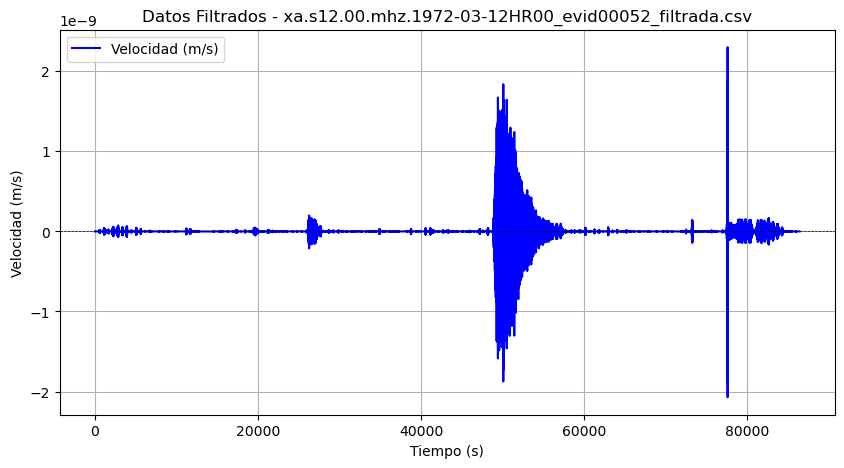

Procesando archivo: xa.s12.00.mhz.1972-05-11HR00_evid00055_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


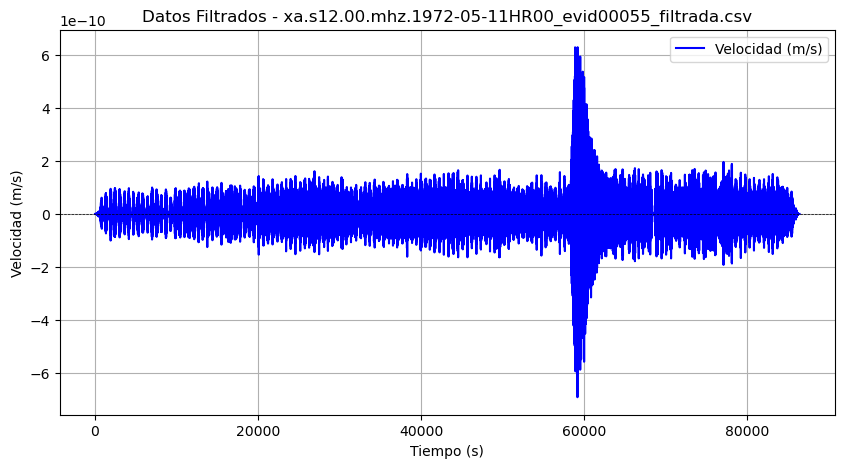

Procesando archivo: xa.s12.00.mhz.1972-06-16HR00_evid00060_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


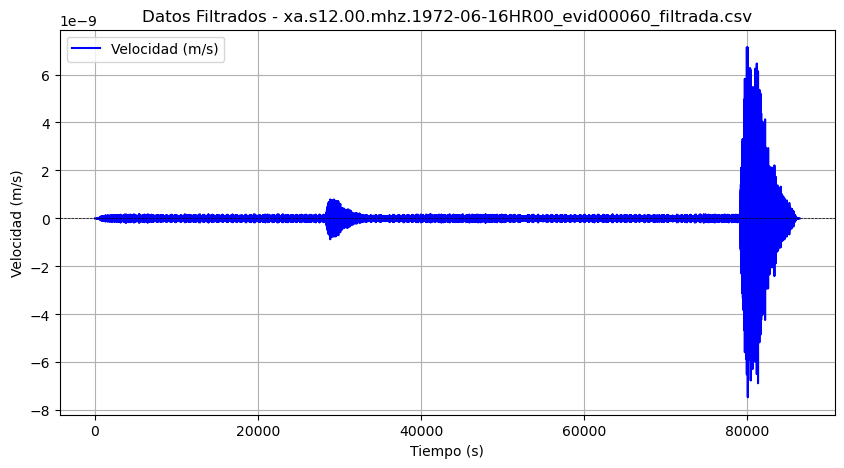

Procesando archivo: xa.s12.00.mhz.1972-07-17HR00_evid00067_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


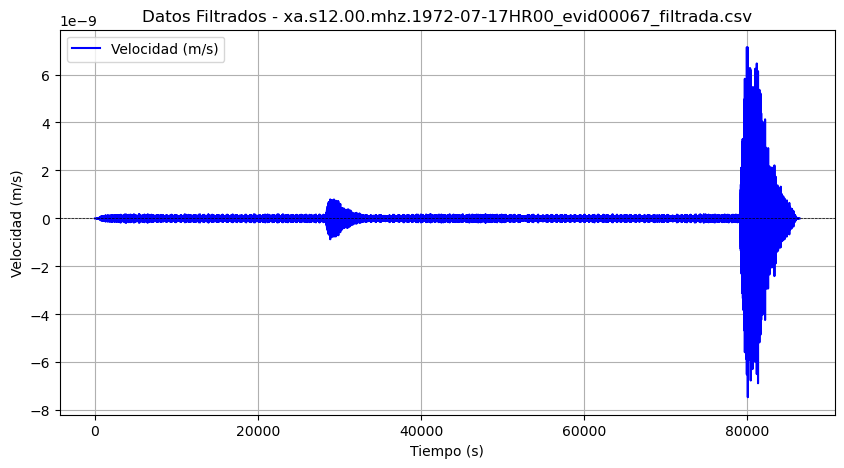

Procesando archivo: xa.s12.00.mhz.1972-07-17HR00_evid00068_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


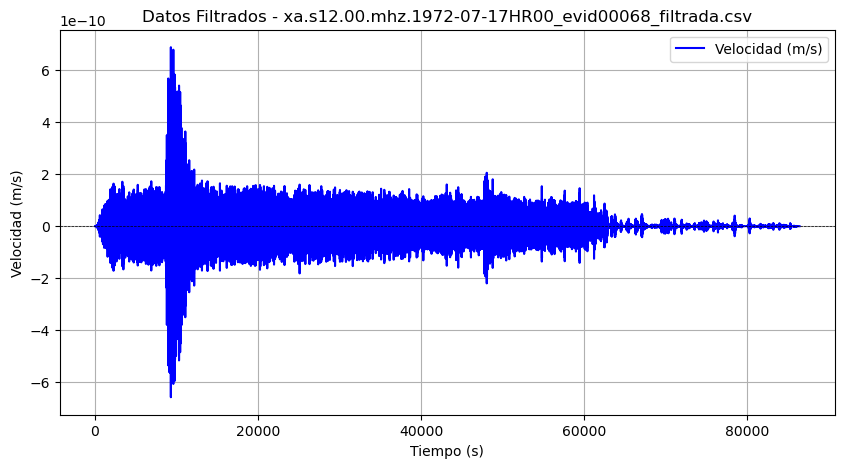

Procesando archivo: xa.s12.00.mhz.1972-07-28HR00_evid00070_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


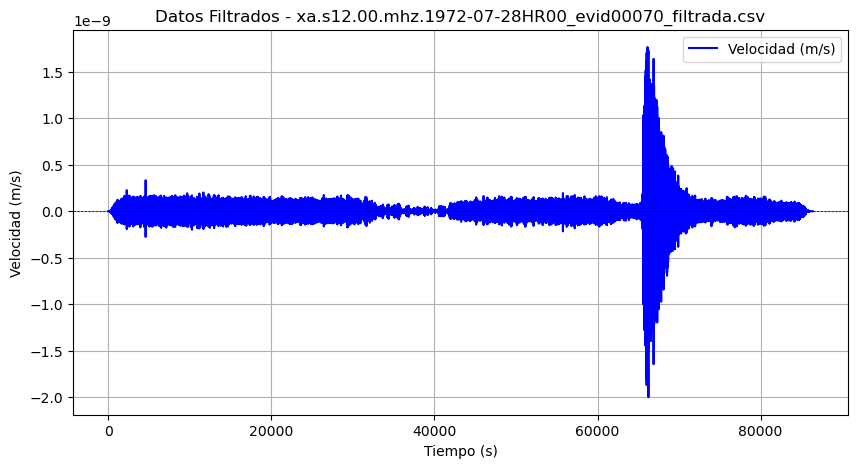

Procesando archivo: xa.s12.00.mhz.1972-07-31HR00_evid00071_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


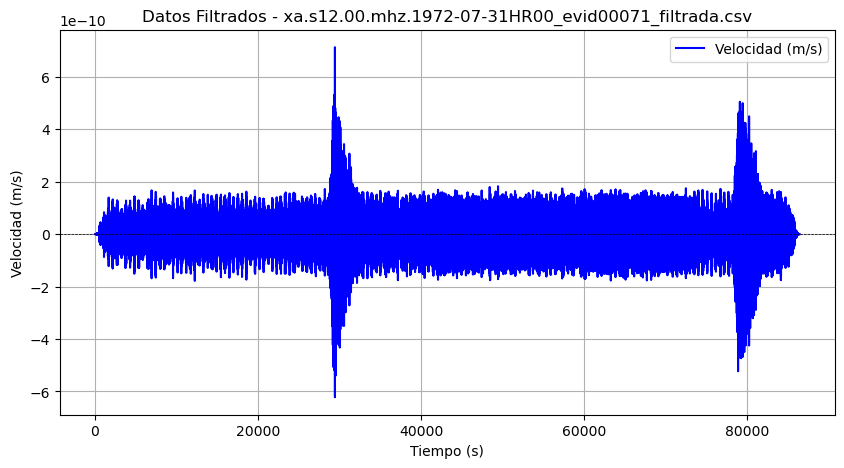

Procesando archivo: xa.s12.00.mhz.1972-12-02HR00_evid00083_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


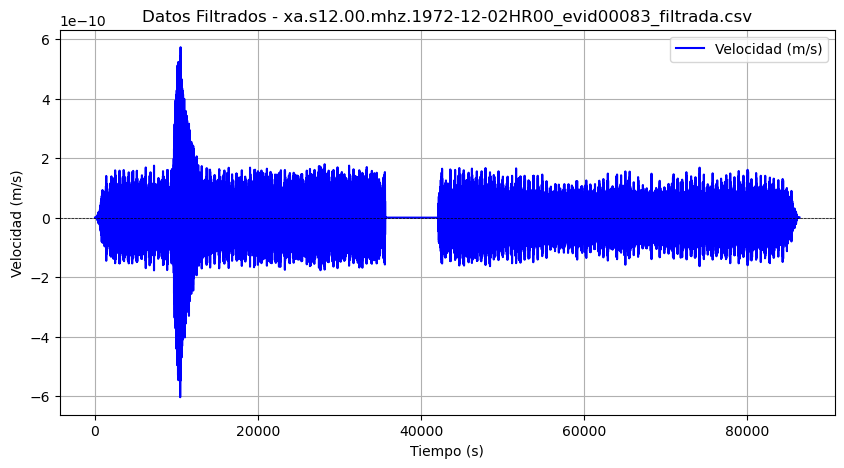

Procesando archivo: xa.s12.00.mhz.1972-12-03HR00_evid00084_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


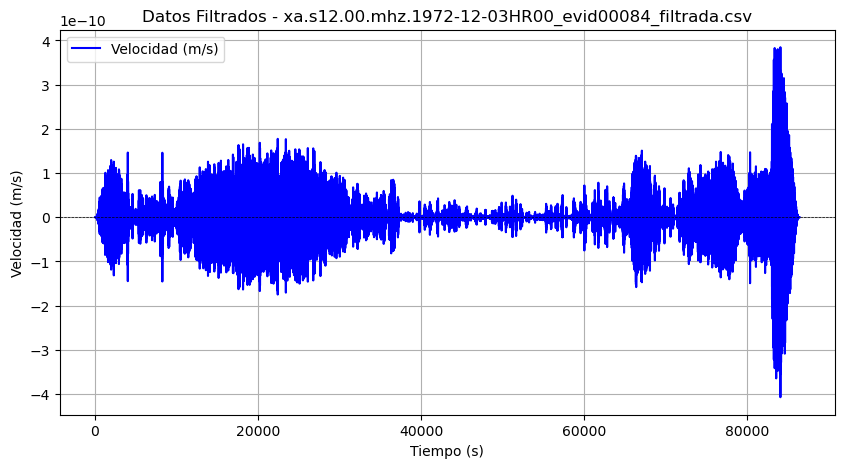

Procesando archivo: xa.s12.00.mhz.1973-01-18HR00_evid00088_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


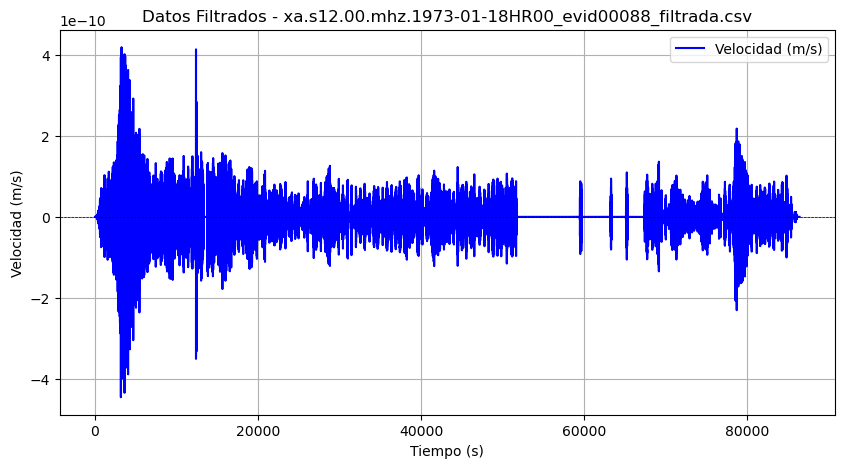

Procesando archivo: xa.s12.00.mhz.1973-01-31HR00_evid00091_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


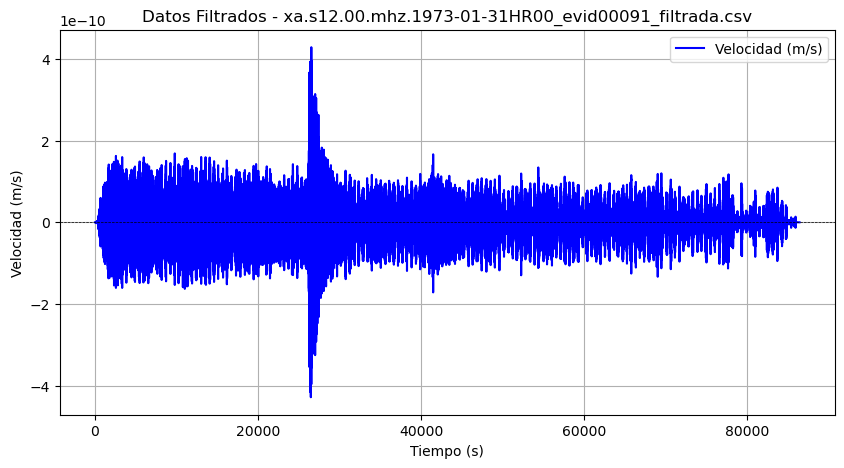

Procesando archivo: xa.s12.00.mhz.1973-03-01HR00_evid00093_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


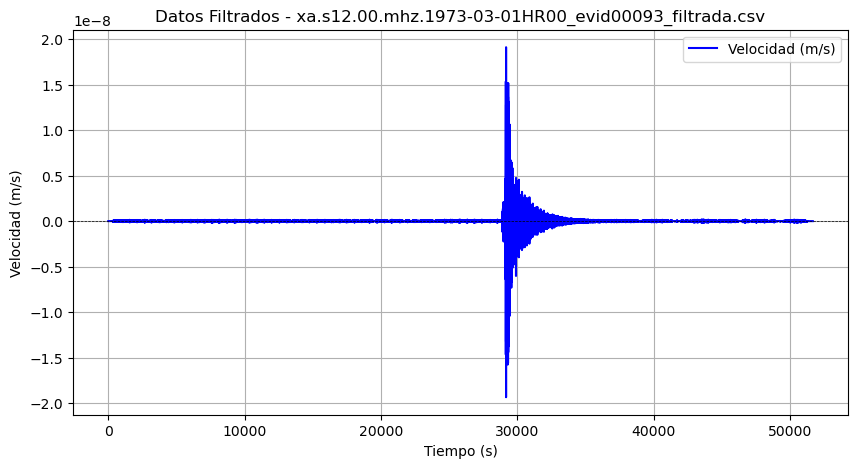

Procesando archivo: xa.s12.00.mhz.1973-03-13HR00_evid00094_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


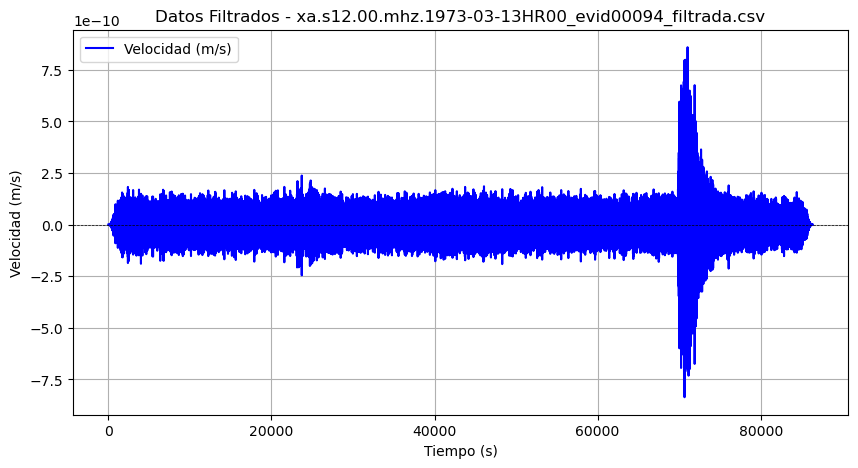

Procesando archivo: xa.s12.00.mhz.1973-03-24HR00_evid00097_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


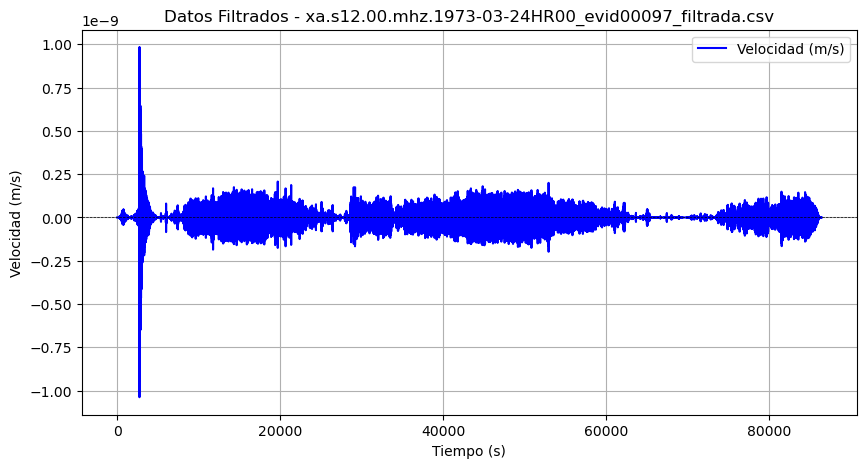

Procesando archivo: xa.s12.00.mhz.1973-05-14HR00_evid00104_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


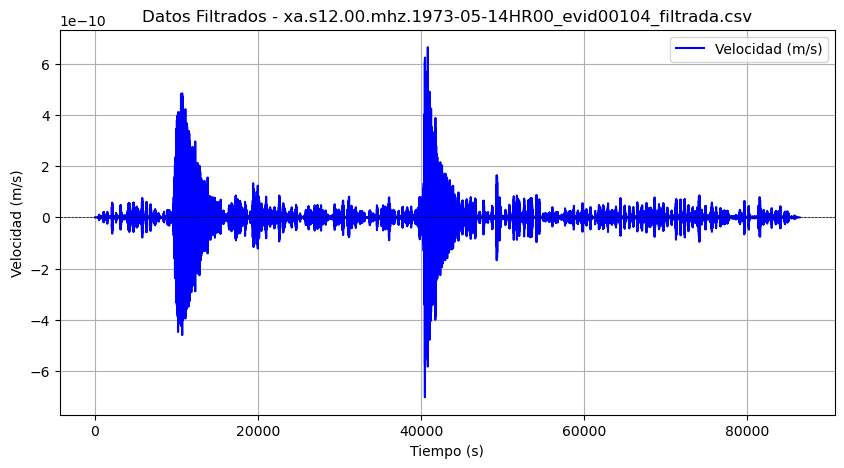

Procesando archivo: xa.s12.00.mhz.1973-06-05HR00_evid00107_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


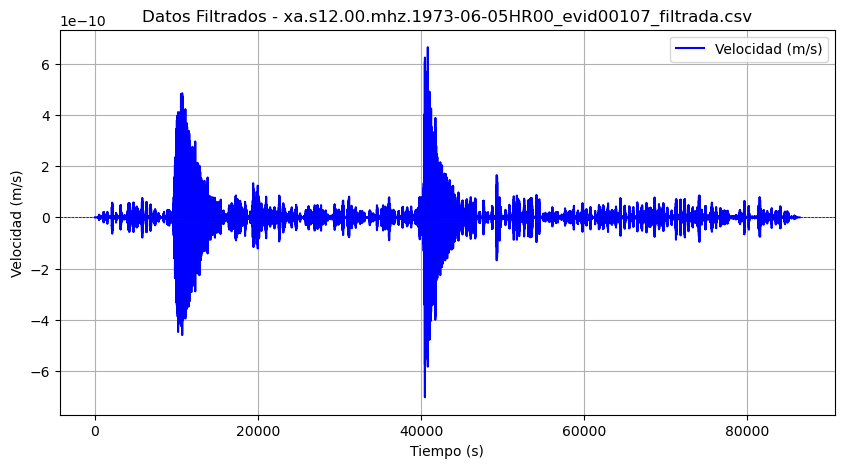

Procesando archivo: xa.s12.00.mhz.1973-06-05HR00_evid00108_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


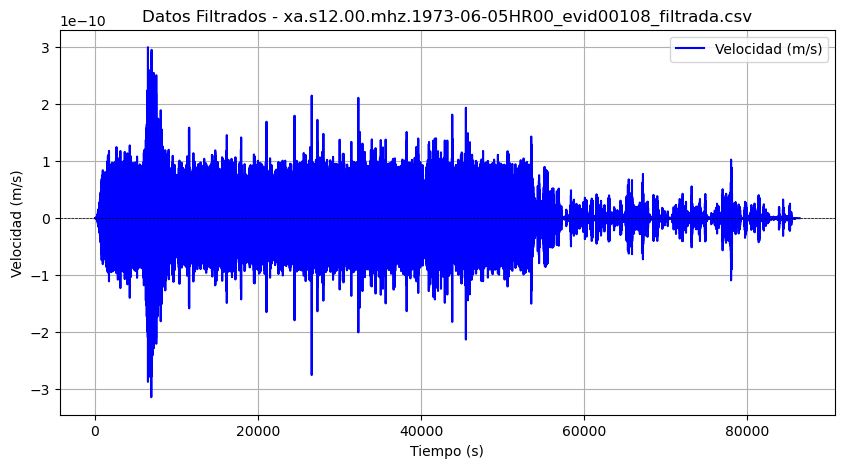

Procesando archivo: xa.s12.00.mhz.1973-06-18HR00_evid00109_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


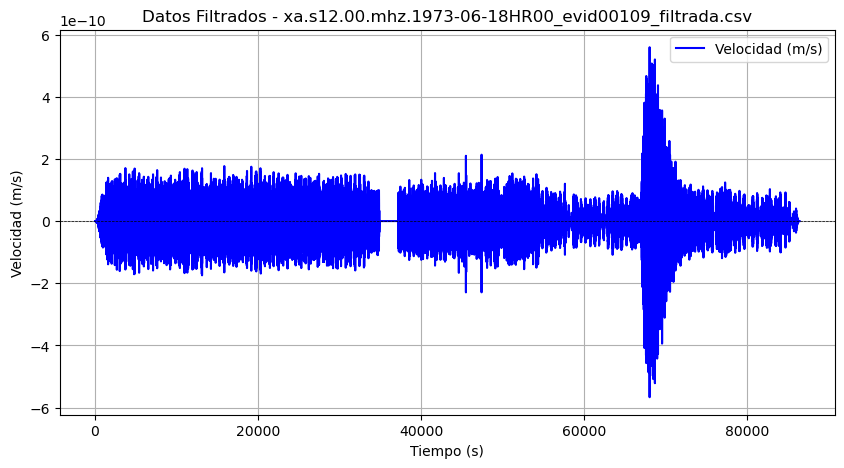

Procesando archivo: xa.s12.00.mhz.1973-06-27HR00_evid00112_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


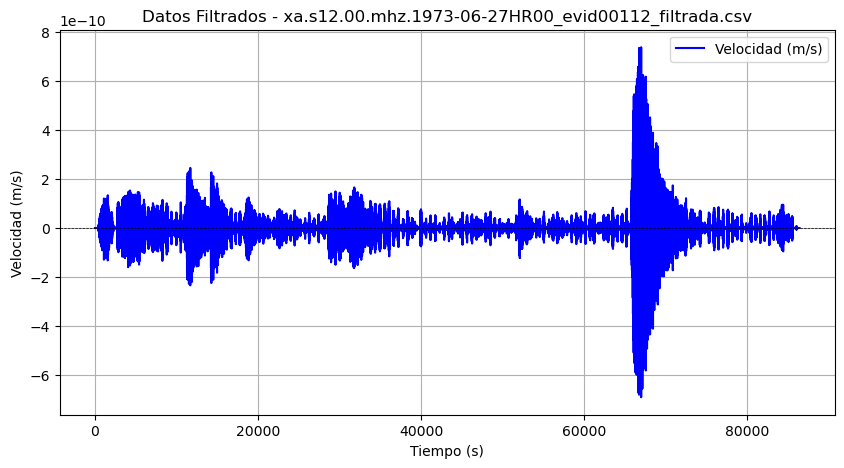

Procesando archivo: xa.s12.00.mhz.1973-07-03HR00_evid00113_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


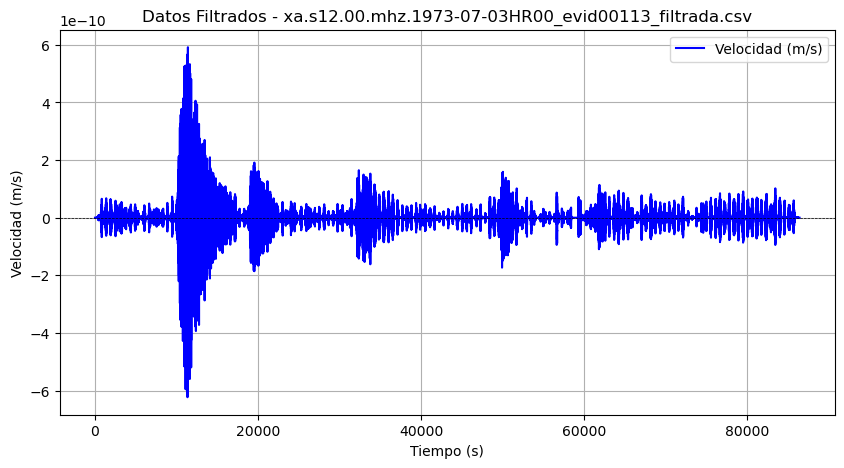

Procesando archivo: xa.s12.00.mhz.1973-07-04HR00_evid00114_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


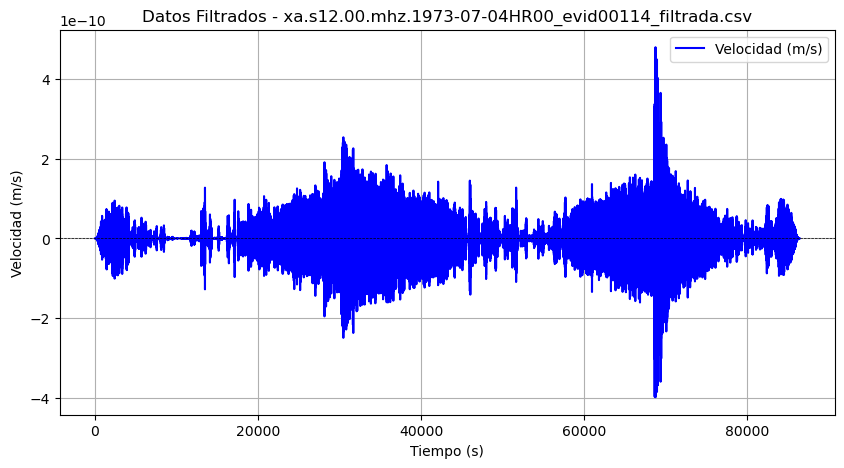

Procesando archivo: xa.s12.00.mhz.1973-07-20HR00_evid00117_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


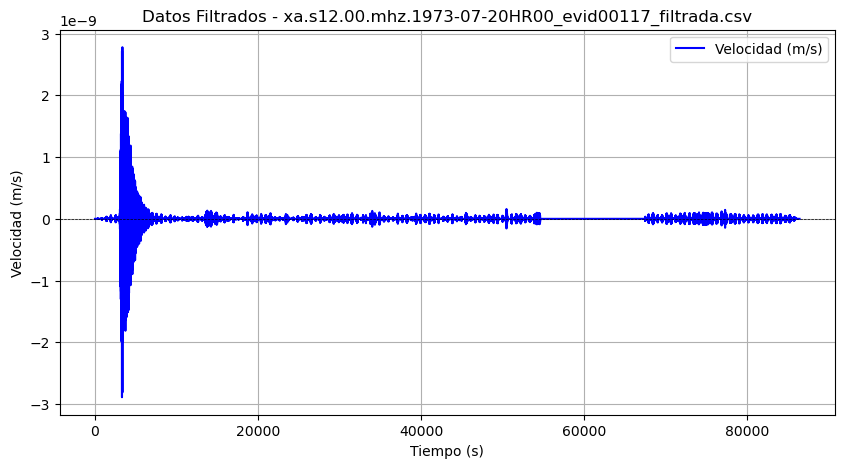

Procesando archivo: xa.s12.00.mhz.1973-07-28HR00_evid00120_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


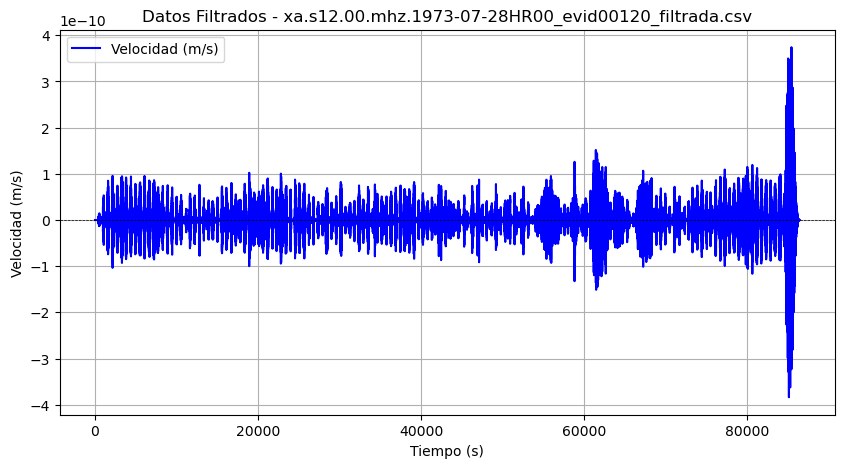

Procesando archivo: xa.s12.00.mhz.1973-07-29HR00_evid00121_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


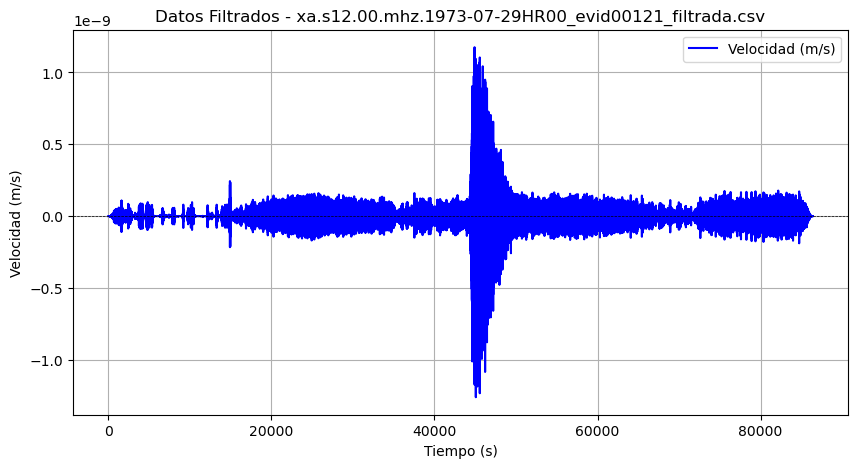

Procesando archivo: xa.s12.00.mhz.1973-08-21HR00_evid00127_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


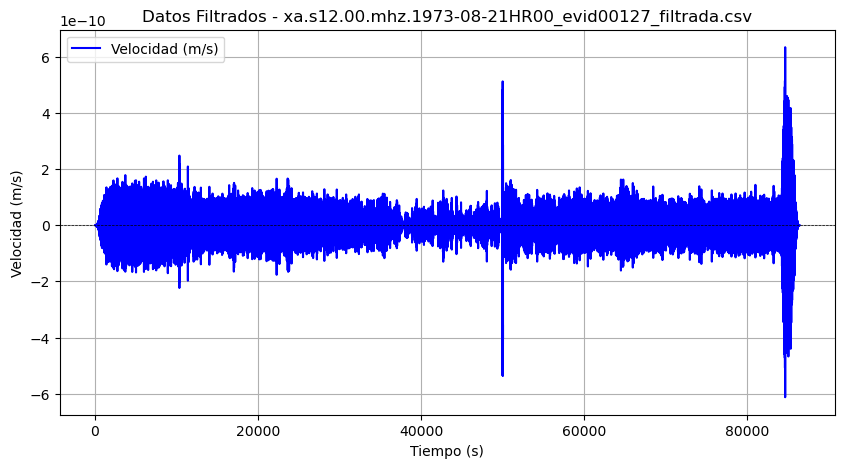

Procesando archivo: xa.s12.00.mhz.1974-01-10HR00_evid00136_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


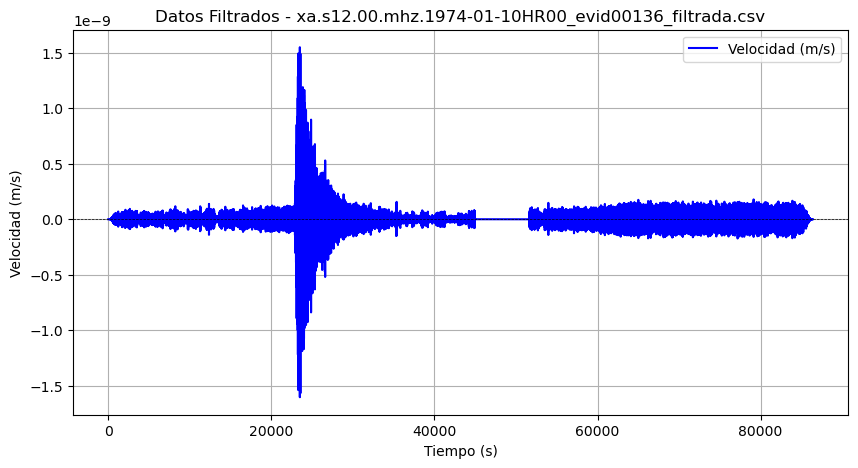

Procesando archivo: xa.s12.00.mhz.1974-02-07HR00_evid00137_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


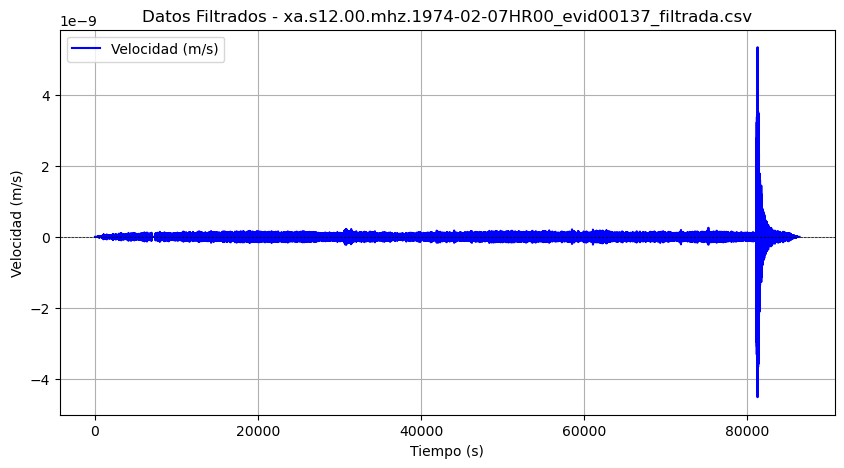

Procesando archivo: xa.s12.00.mhz.1974-02-12HR00_evid00138_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


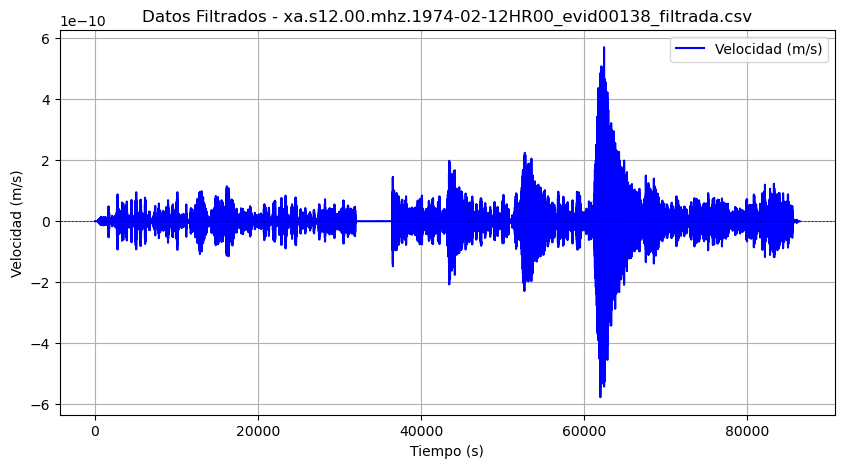

Procesando archivo: xa.s12.00.mhz.1974-03-25HR00_evid00140_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


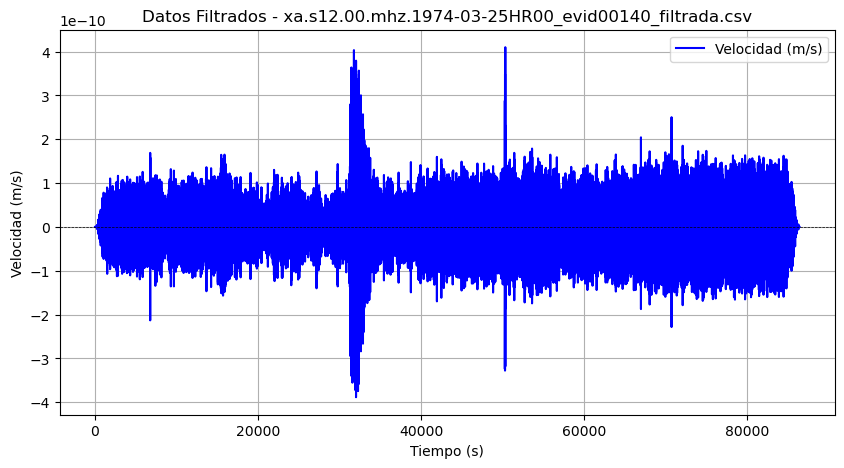

Procesando archivo: xa.s12.00.mhz.1974-04-08HR00_evid00141_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


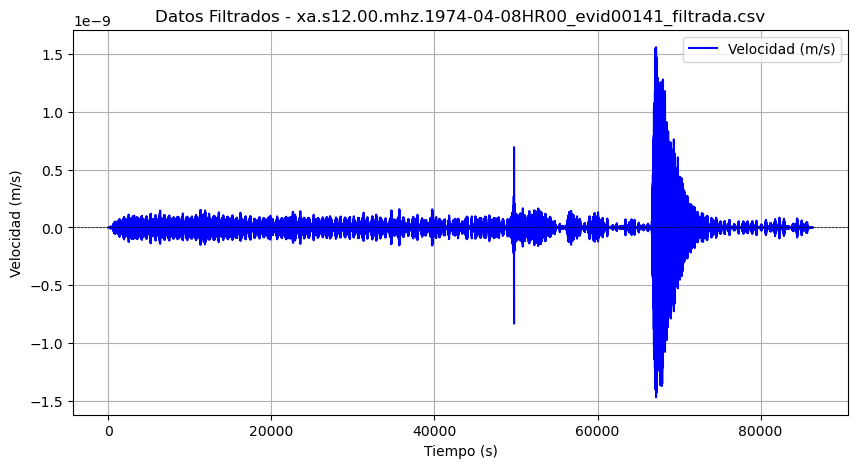

Procesando archivo: xa.s12.00.mhz.1974-04-19HR00_evid00142_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


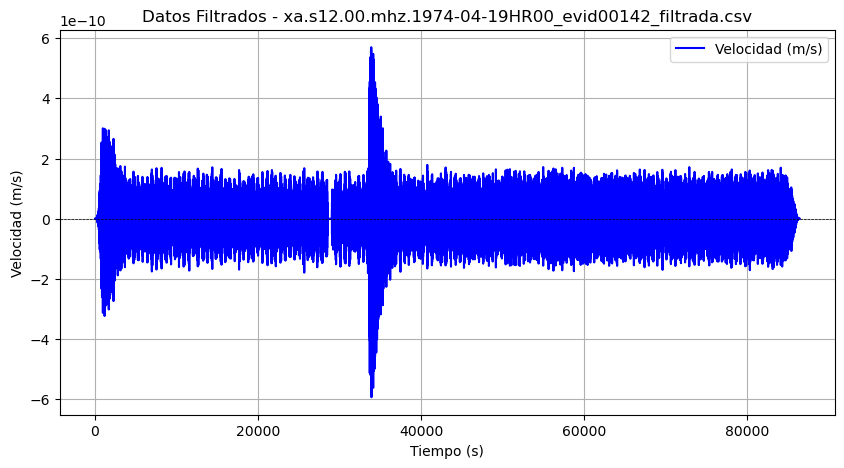

Procesando archivo: xa.s12.00.mhz.1974-04-26HR00_evid00144_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


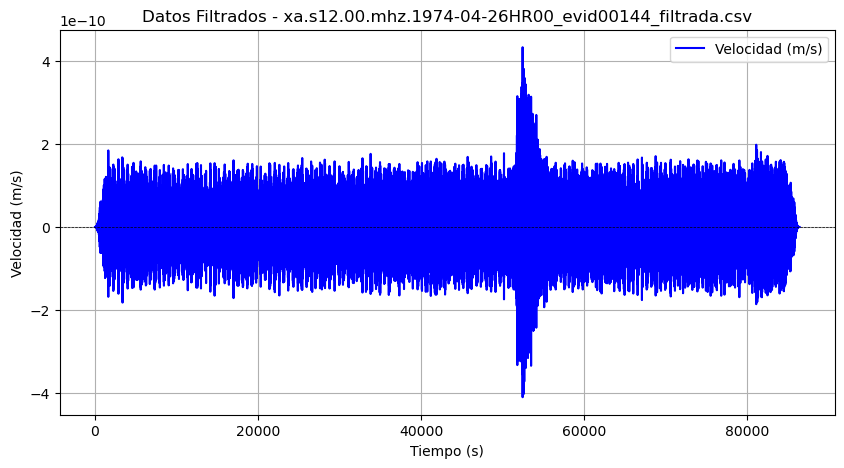

Procesando archivo: xa.s12.00.mhz.1974-04-27HR00_evid00145_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


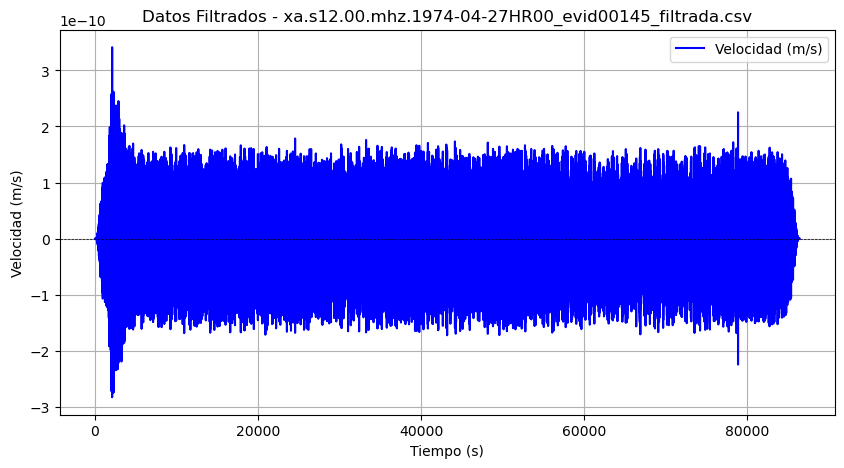

Procesando archivo: xa.s12.00.mhz.1974-06-25HR00_evid00149_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


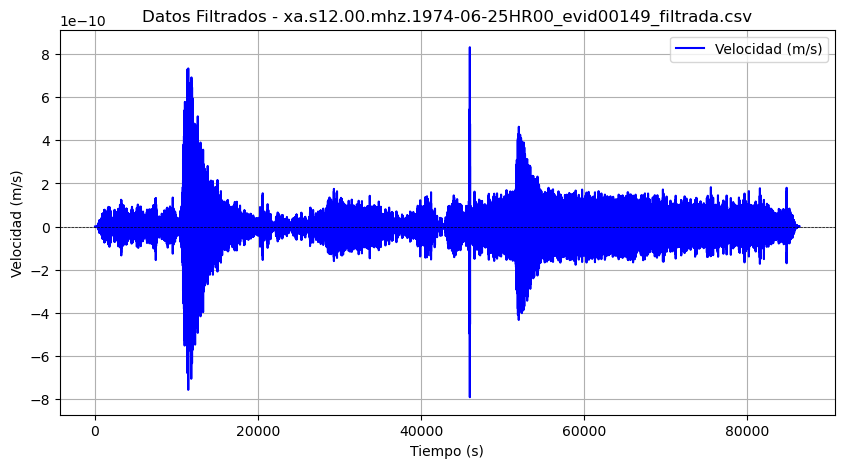

Procesando archivo: xa.s12.00.mhz.1974-07-06HR00_evid00150_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


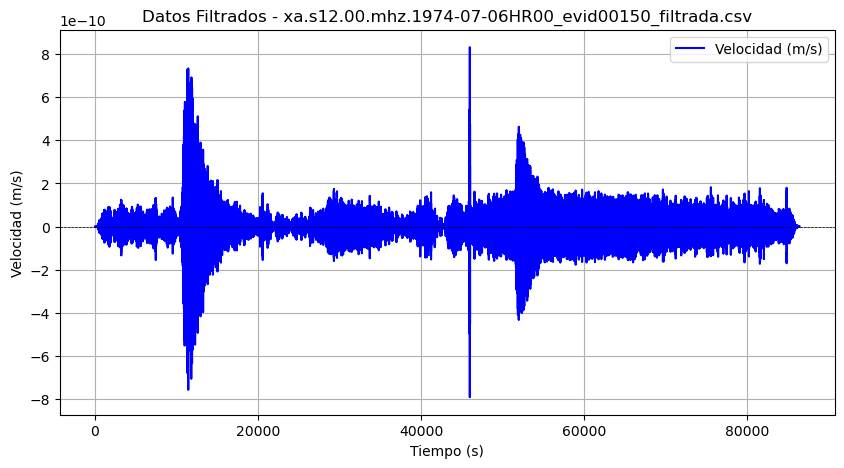

Procesando archivo: xa.s12.00.mhz.1974-07-06HR00_evid00151_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


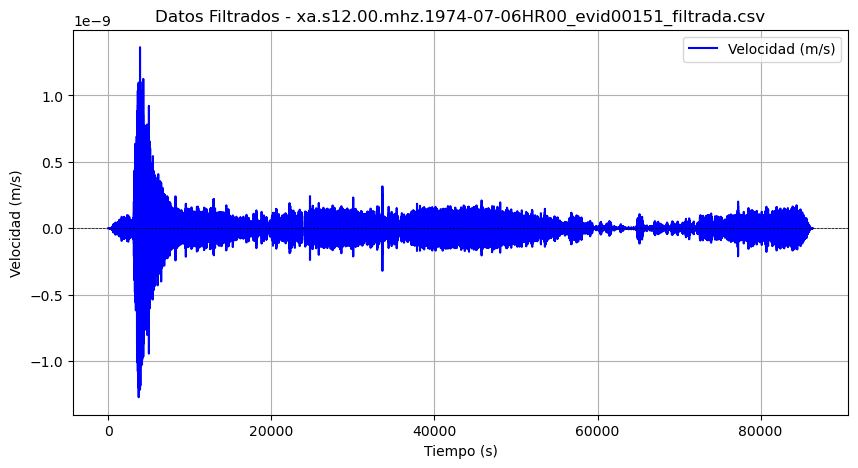

Procesando archivo: xa.s12.00.mhz.1974-07-11HR00_evid00152_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


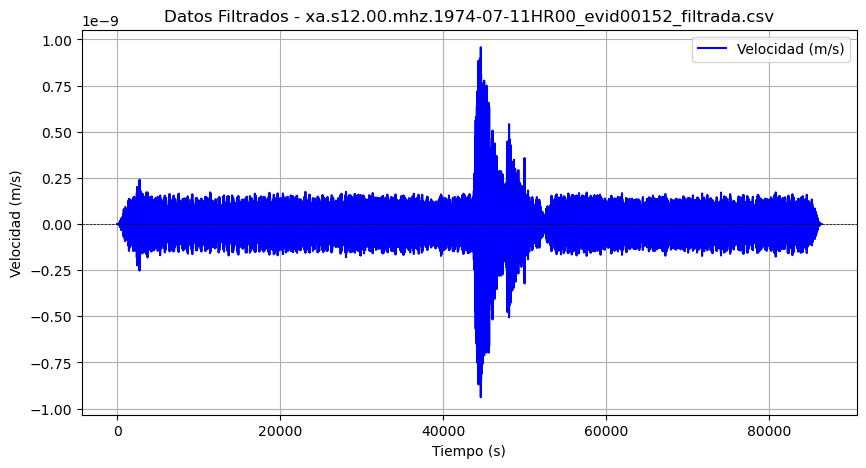

Procesando archivo: xa.s12.00.mhz.1974-07-17HR00_evid00153_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


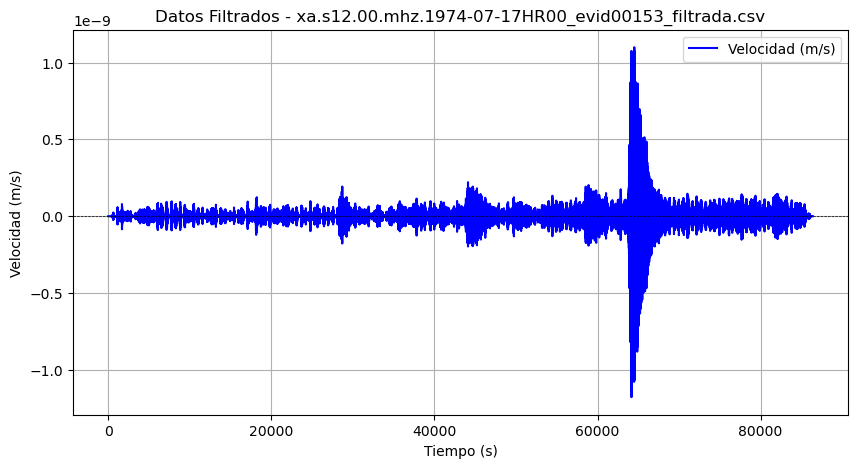

Procesando archivo: xa.s12.00.mhz.1974-10-14HR00_evid00156_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


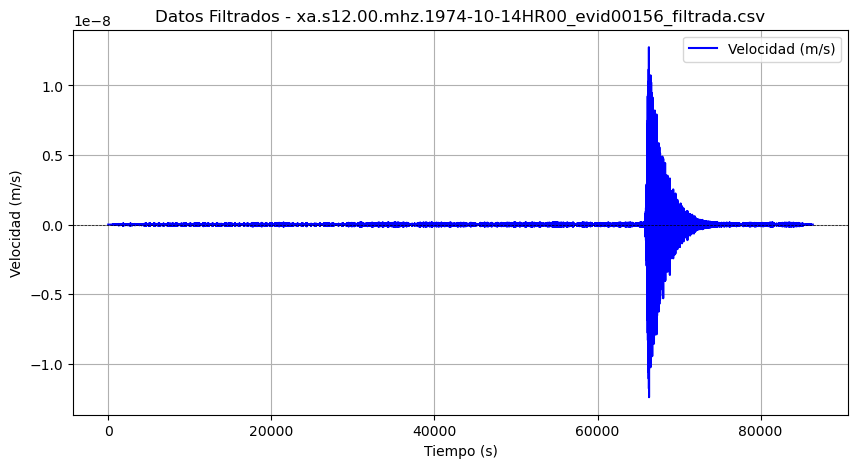

Procesando archivo: xa.s12.00.mhz.1975-04-12HR00_evid00191_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


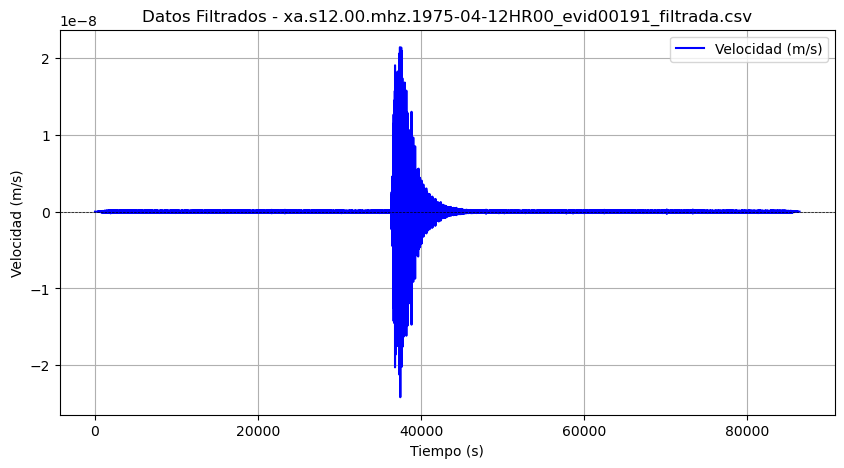

Procesando archivo: xa.s12.00.mhz.1975-05-04HR00_evid00192_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


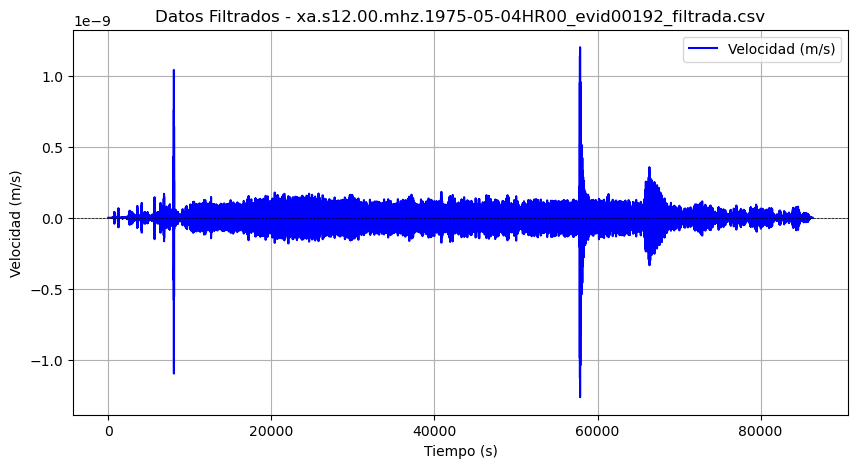

Procesando archivo: xa.s12.00.mhz.1975-06-24HR00_evid00196_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


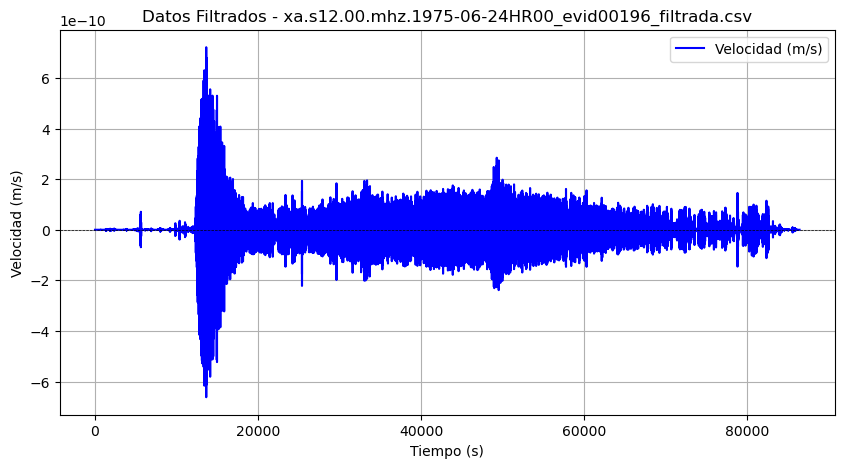

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Ruta a la carpeta con los archivos filtrados
input_folder = 'data_filtrada'

# Listar todos los archivos CSV en la carpeta
files = [f for f in os.listdir(input_folder) if f.endswith('.csv')]

# Iterar sobre cada archivo CSV
for file in files:
    # Leer el archivo CSV
    df = pd.read_csv(os.path.join(input_folder, file))

    # Imprimir los nombres de las columnas y el contenido del DataFrame
    print(f"Procesando archivo: {file}")
    print("Nombres de las columnas:", df.columns.tolist())
    
    # Eliminar espacios en blanco de los nombres de las columnas
    df.columns = df.columns.str.strip()

    # Graficar los datos si 'velocity' está presente
    if 'velocity' in df.columns:
        plt.figure(figsize=(10, 5))
        plt.plot(df['time_abs'], df['velocity'], label='Velocidad (m/s)', color='blue')
        plt.title(f'Datos Filtrados - {file}')
        plt.xlabel('Tiempo (s)')
        plt.ylabel('Velocidad (m/s)')
        plt.axhline(0, color='black', linewidth=0.5, linestyle='--')  # Línea horizontal en y=0
        plt.grid()
        plt.legend()
        plt.show()
    else:
        print("La columna 'velocity' no se encuentra en el DataFrame.")


Procesando archivo: xa.s12.00.mhz.1970-01-19HR00_evid00002_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


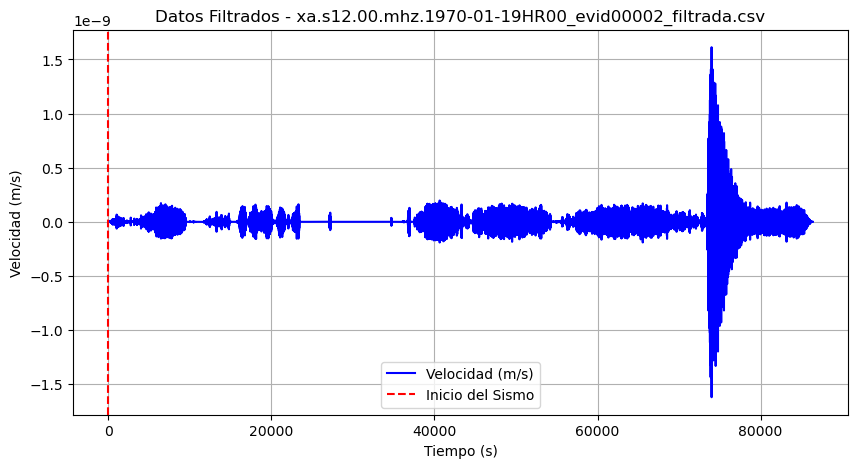

Procesando archivo: xa.s12.00.mhz.1970-03-25HR00_evid00003_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


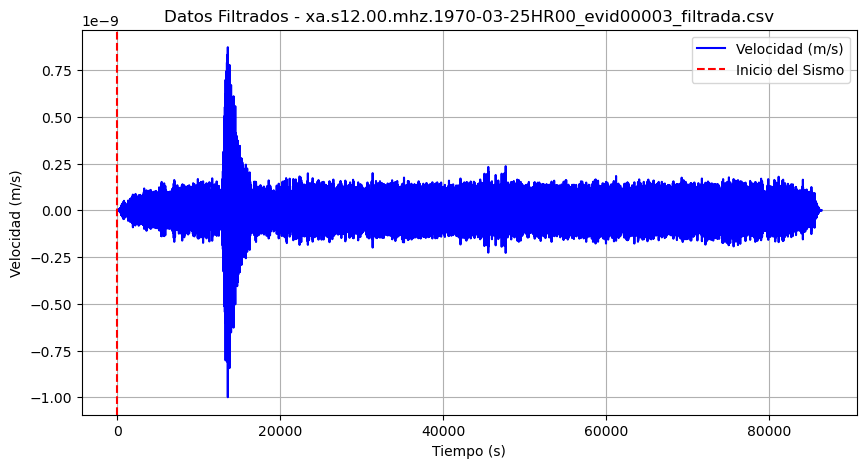

Procesando archivo: xa.s12.00.mhz.1970-03-26HR00_evid00004_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


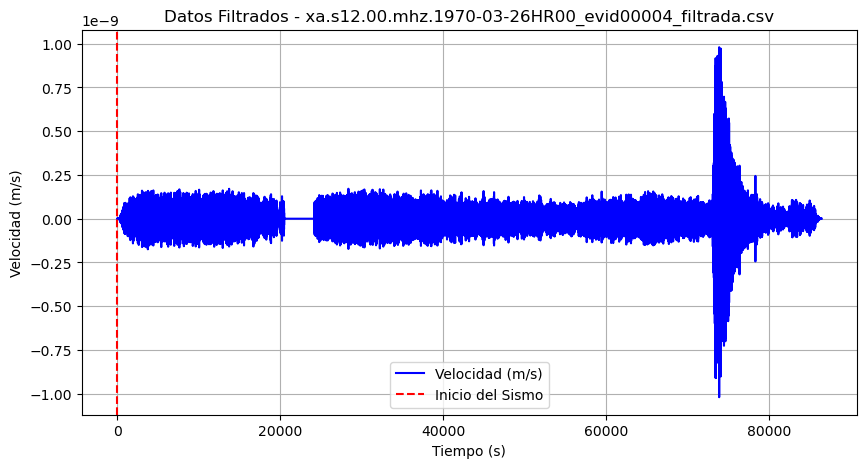

Procesando archivo: xa.s12.00.mhz.1970-04-25HR00_evid00006_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


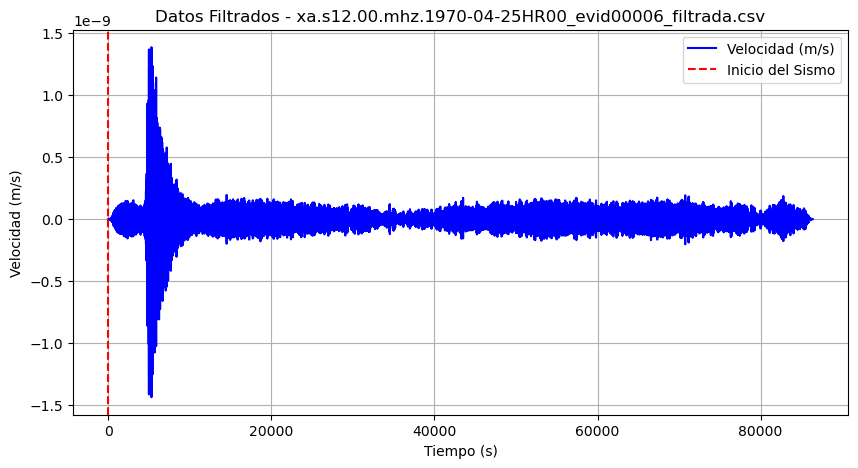

Procesando archivo: xa.s12.00.mhz.1970-04-26HR00_evid00007_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


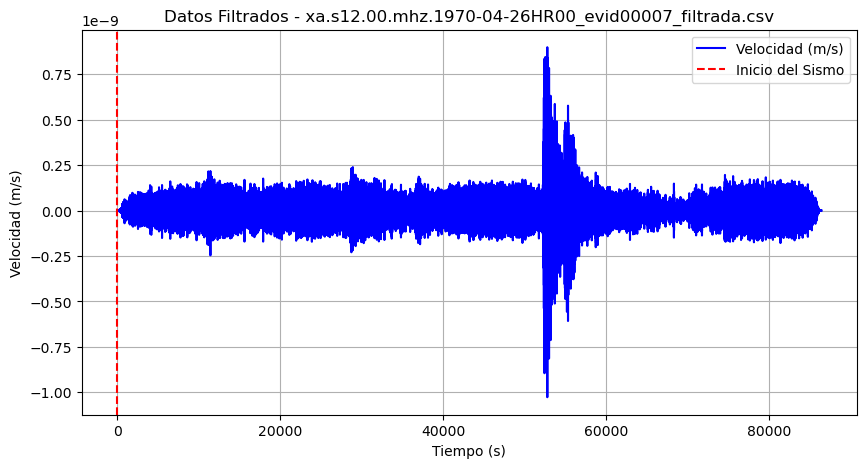

Procesando archivo: xa.s12.00.mhz.1970-06-15HR00_evid00008_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


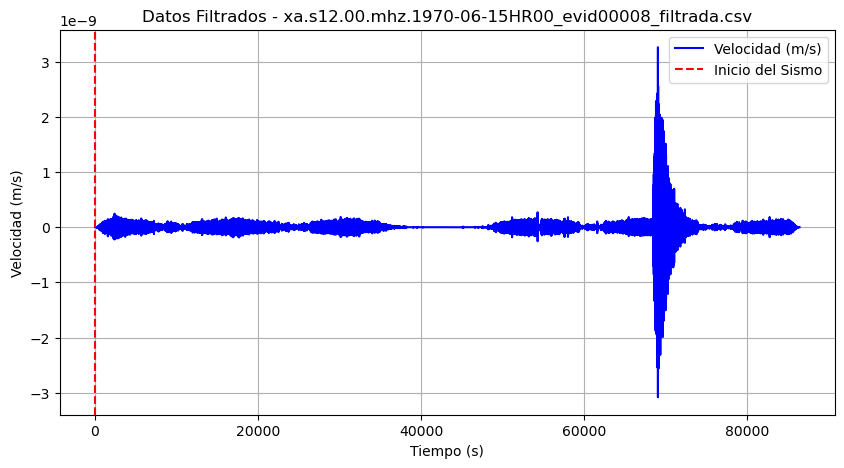

Procesando archivo: xa.s12.00.mhz.1970-06-26HR00_evid00009_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


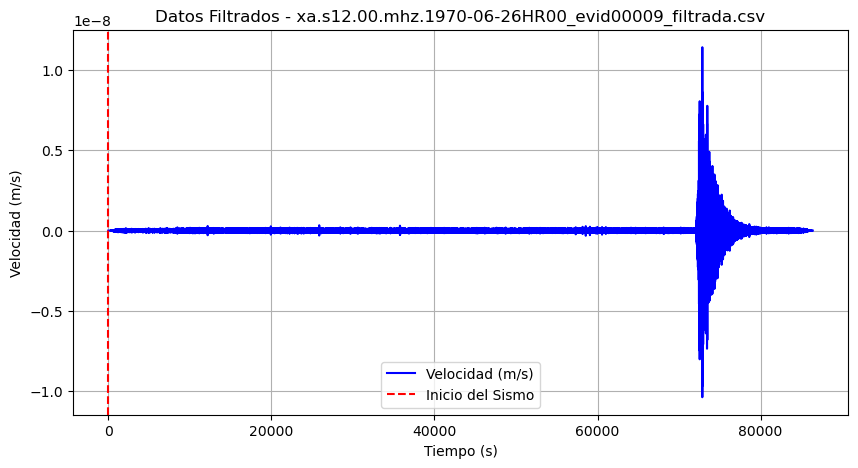

Procesando archivo: xa.s12.00.mhz.1970-07-20HR00_evid00010_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


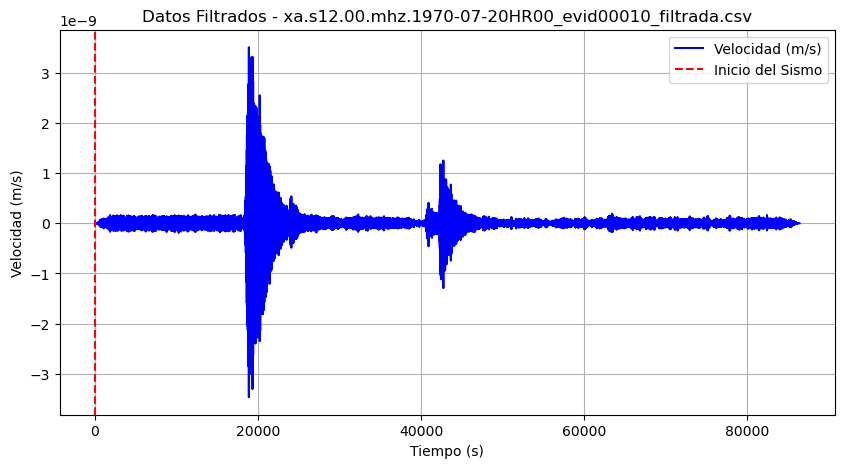

Procesando archivo: xa.s12.00.mhz.1970-07-20HR00_evid00011_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


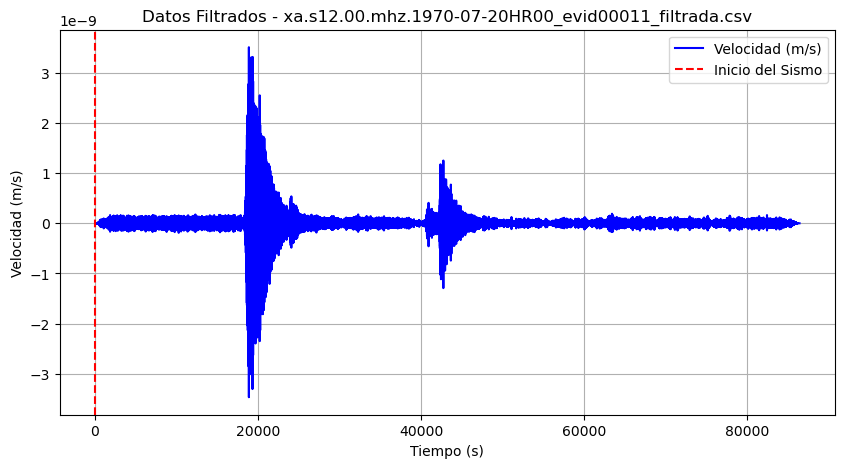

Procesando archivo: xa.s12.00.mhz.1970-09-26HR00_evid00013_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


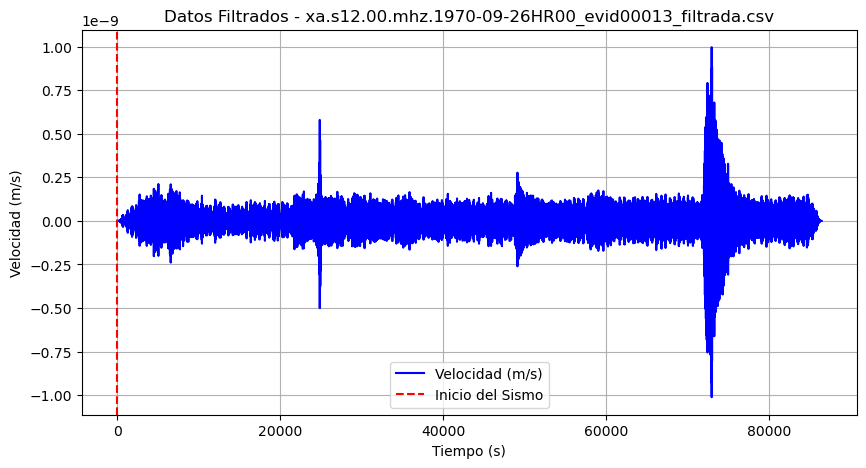

Procesando archivo: xa.s12.00.mhz.1970-10-24HR00_evid00014_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


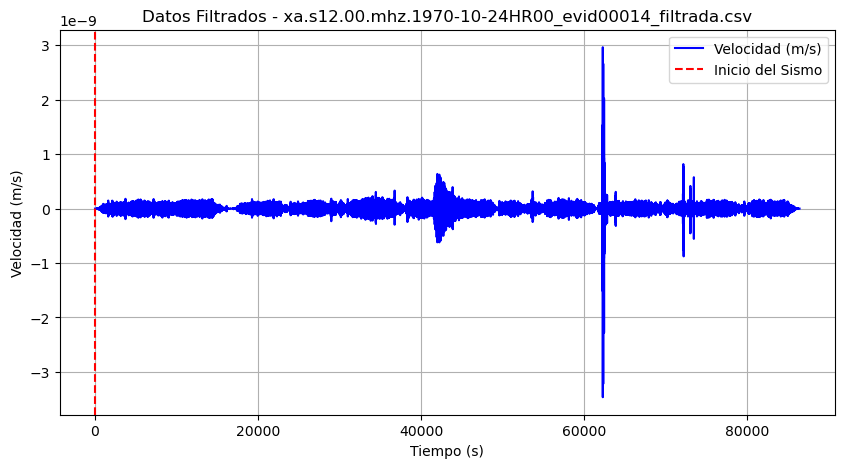

Procesando archivo: xa.s12.00.mhz.1970-11-12HR00_evid00015_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


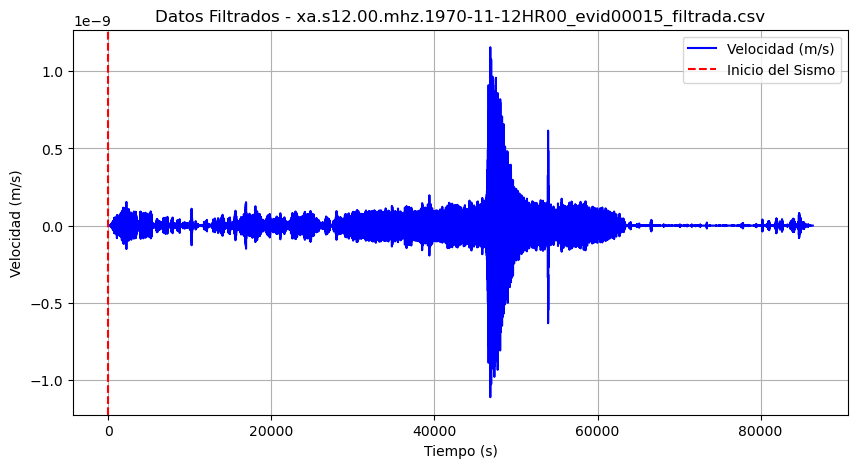

Procesando archivo: xa.s12.00.mhz.1970-12-11HR00_evid00017_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']


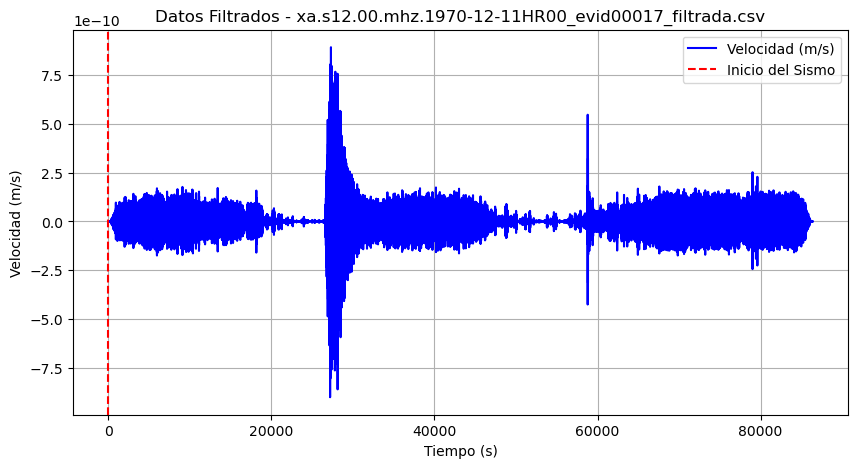

Procesando archivo: xa.s12.00.mhz.1970-12-27HR00_evid00019_filtrada.csv
Nombres de las columnas: ['time_abs', ' time_rel', ' velocity']



KeyboardInterrupt



In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Ruta a la carpeta con los archivos filtrados
input_folder = 'data_filtrada'

# Listar todos los archivos CSV en la carpeta
files = [f for f in os.listdir(input_folder) if f.endswith('.csv')]

# Iterar sobre cada archivo CSV
for file in files:
    # Leer el archivo CSV
    df = pd.read_csv(os.path.join(input_folder, file))

    # Imprimir los nombres de las columnas y el contenido del DataFrame
    print(f"Procesando archivo: {file}")
    print("Nombres de las columnas:", df.columns.tolist())
    
    # Eliminar espacios en blanco de los nombres de las columnas
    df.columns = df.columns.str.strip()

    # Graficar los datos si 'velocity' está presente
    if 'velocity' in df.columns:
        plt.figure(figsize=(10, 5))

        # Graficar los datos originales
        plt.plot(df['time_abs'], df['velocity'], label='Velocidad (m/s)', color='blue')

        # Agregar línea de inicio del sismo (especifica el tiempo en el que comienza el sismo)
        start_time = df['time_abs'].iloc[0]  # Cambia este índice según el momento real de inicio del sismo
        plt.axvline(x=start_time, color='red', linestyle='--', label='Inicio del Sismo')

        # Títulos y etiquetas
        plt.title(f'Datos Filtrados - {file}')
        plt.xlabel('Tiempo (s)')
        plt.ylabel('Velocidad (m/s)')
        plt.grid()
        plt.legend()
        
        # Mostrar la gráfica
        plt.show()
    else:
        print("La columna 'velocity' no se encuentra en el DataFrame.")


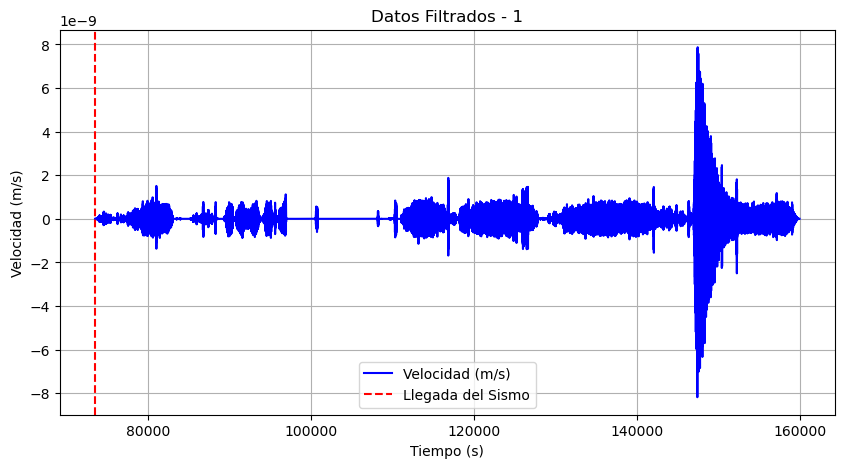

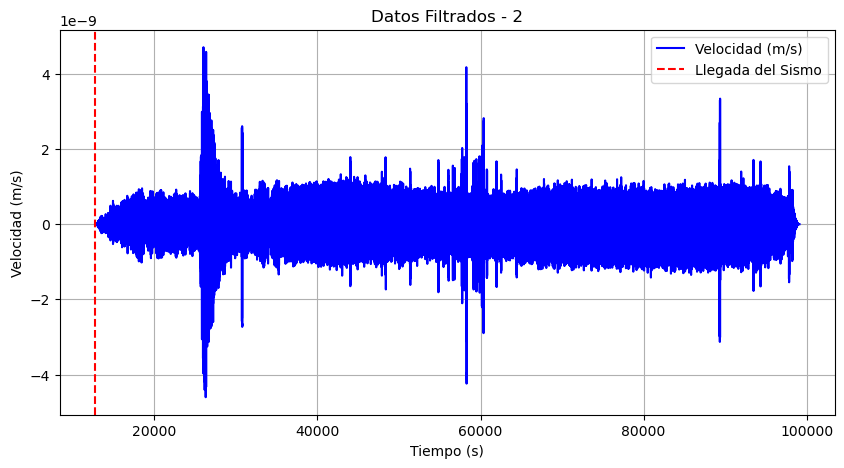

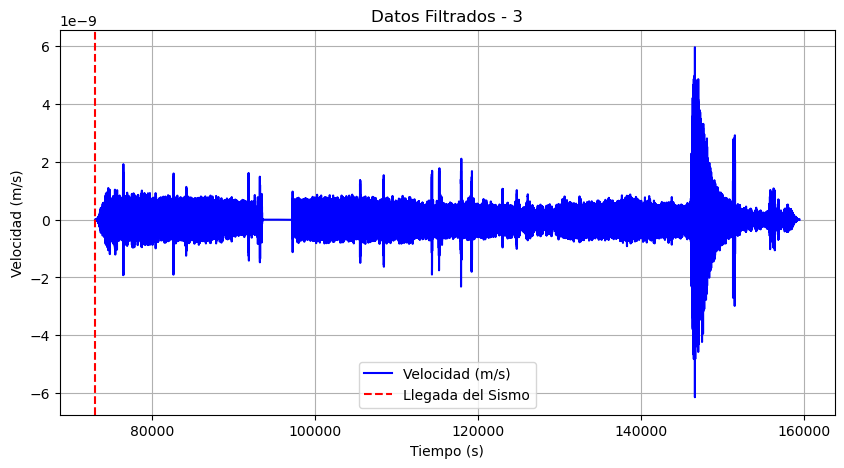

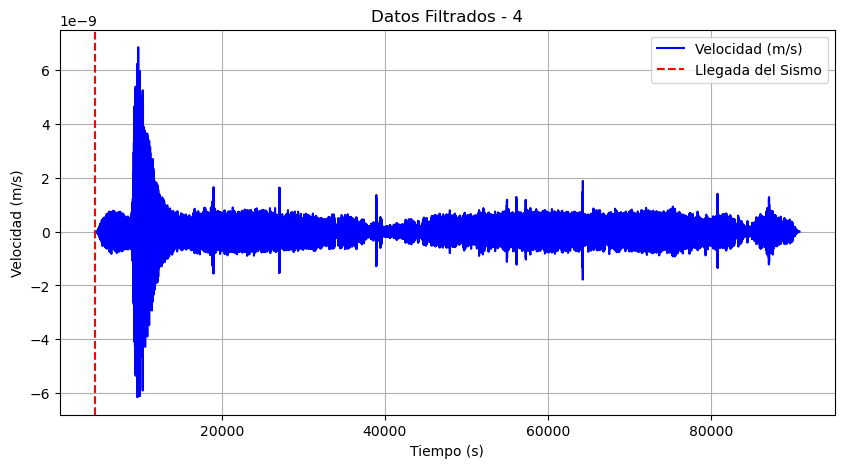

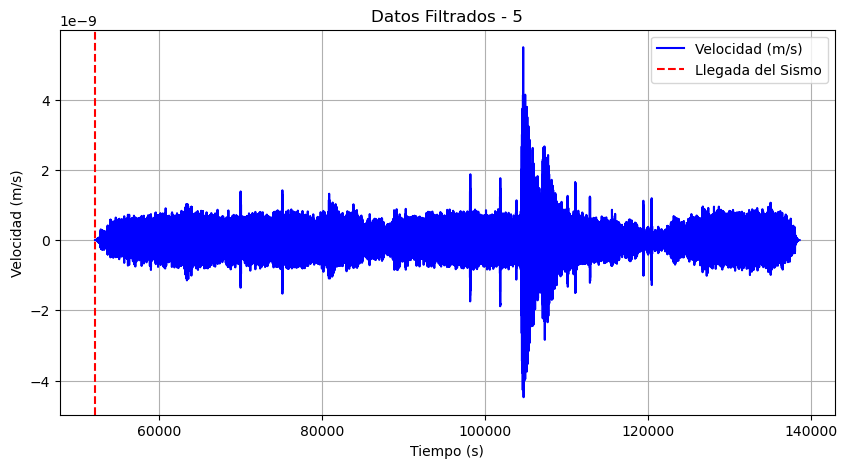

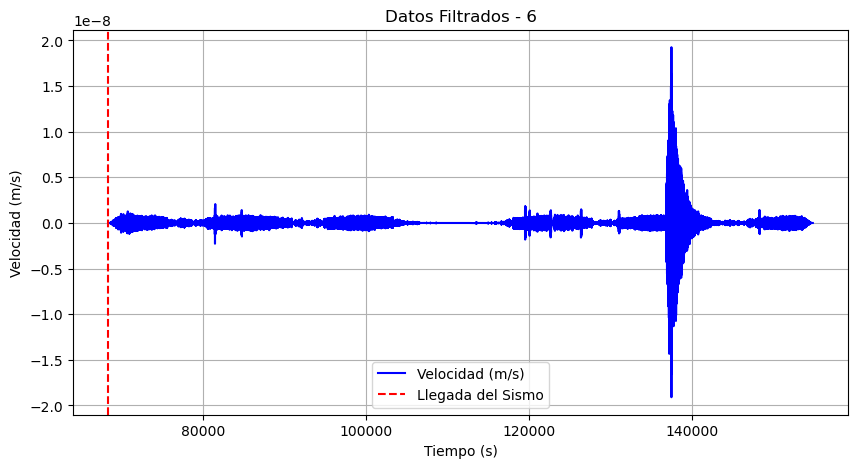

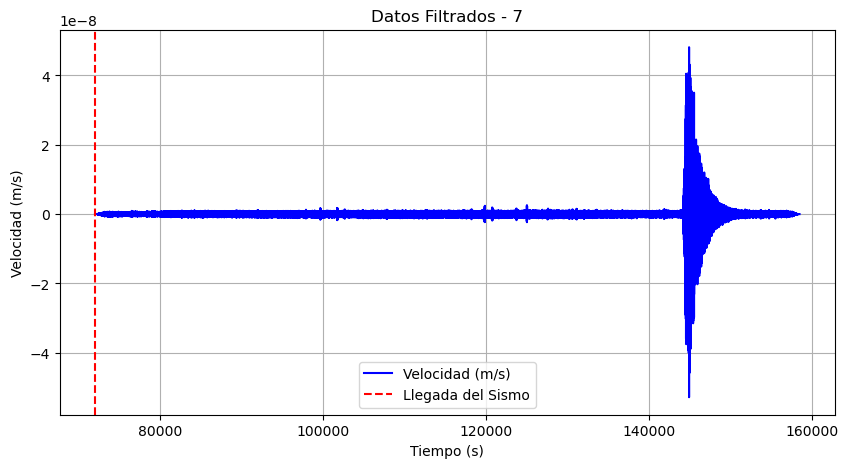

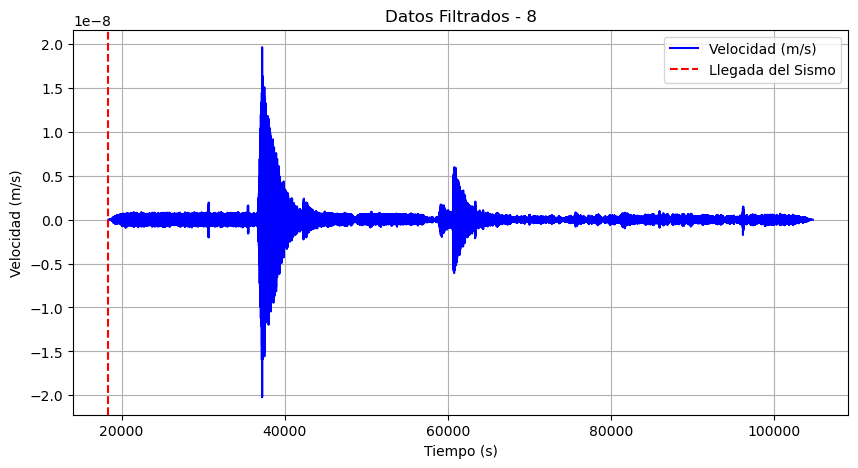

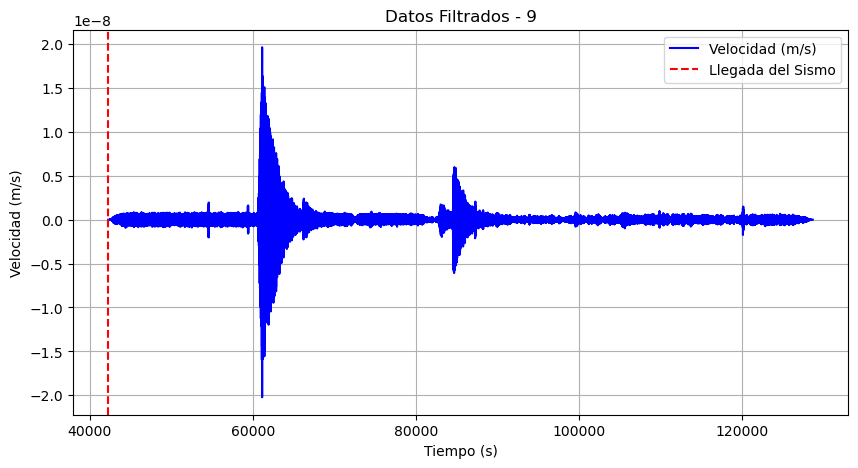


KeyboardInterrupt



In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Graficar los datos
for i in range(len(all_train_csv_data)):
    plt.figure(figsize=(10, 5))

    # Obtener los tiempos de llegada del sismo
    arrival_time = arrival_times[i]

    # Ajustar los tiempos relativos a partir del tiempo de llegada
    adjusted_times = all_train_csv_times[i] + arrival_time

    # Graficar los datos originales
    plt.plot(adjusted_times, all_train_csv_data[i], label='Velocidad (m/s)', color='blue')

    # Agregar línea de llegada del sismo
    plt.axvline(x=arrival_time, color='red', linestyle='--', label='Llegada del Sismo')

    # Títulos y etiquetas
    plt.title(f'Datos Filtrados - {i + 1}')  # Usar índice o un nombre específico si está disponible
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Velocidad (m/s)')
    plt.grid()
    plt.legend()

    # Mostrar la gráfica
    plt.show()




In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

# Cargar los datos originales del catálogo
cat_directory = '/KEVIN/SISMIC/data/lunar/training/catalogs/'
cat_file = os.path.join(cat_directory, 'apollo12_catalog_GradeA_final.csv')
catalog = pd.read_csv(cat_file)

# Ruta a la carpeta con los archivos filtrados
input_folder = 'data_filtrada'

# Crear un diccionario con los tiempos de inicio de los sismos
sismo_inicios = {row['filename'].strip(): row['time_rel(sec)'] for index, row in catalog.iterrows()}

# Listar todos los archivos CSV en la carpeta de datos filtrados
files = [f for f in os.listdir(input_folder) if f.endswith('.csv')]

# Iterar sobre cada archivo CSV filtrado
for file in files:
    # Leer el archivo CSV filtrado
    filtered_data = pd.read_csv(os.path.join(input_folder, file))
    filtered_data.columns = filtered_data.columns.str.strip()  # Limpiar nombres de columnas

    # Comprobar que 'velocity' y 'time_abs' están presentes
    if 'velocity' in filtered_data.columns and 'time_abs' in filtered_data.columns:
        plt.figure(figsize=(10, 5))

        # Graficar los datos originales
        original_file = file.replace('.csv', '')
        original_data = pd.read_csv(os.path.join(input_folder, original_file + '_original.csv'))  # Cambiar según cómo se llame el archivo original
        plt.plot(original_data['time_abs'], original_data['velocity'], label='Datos Originales', color='blue')

        # Graficar los datos filtrados
        plt.plot(filtered_data['time_abs'], filtered_data['velocity'], label='Datos Filtrados', color='orange')

        # Obtener el tiempo de inicio del sismo
        sismo_inicio = sismo_inicios.get(original_file, None)

        if sismo_inicio is not None:
            # Agregar línea de inicio del sismo
            plt.axvline(x=sismo_inicio, color='red', linestyle='--', label='Inicio del Sismo')

        # Títulos y etiquetas
        plt.title(f'Comparación de Datos - {file}')
        plt.xlabel('Tiempo (s)')
        plt.ylabel('Velocidad (m/s)')
        plt.grid()
        plt.legend()

        # Mostrar la gráfica
        plt.show()
    else:
        print(f"La columna 'velocity' o 'time_abs' no se encuentra en el archivo: {file}")



FileNotFoundError: [Errno 2] No such file or directory: 'data_filtrada\\xa.s12.00.mhz.1970-01-19HR00_evid00002_filtrada_original.csv'

<Figure size 1000x500 with 0 Axes>

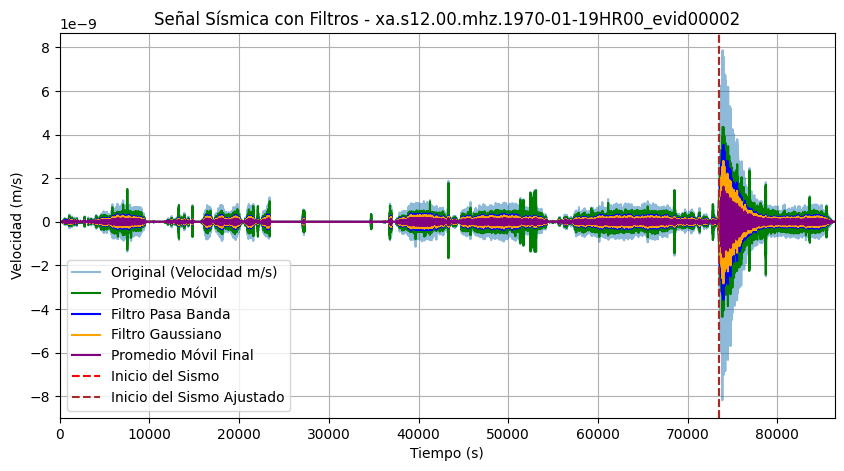

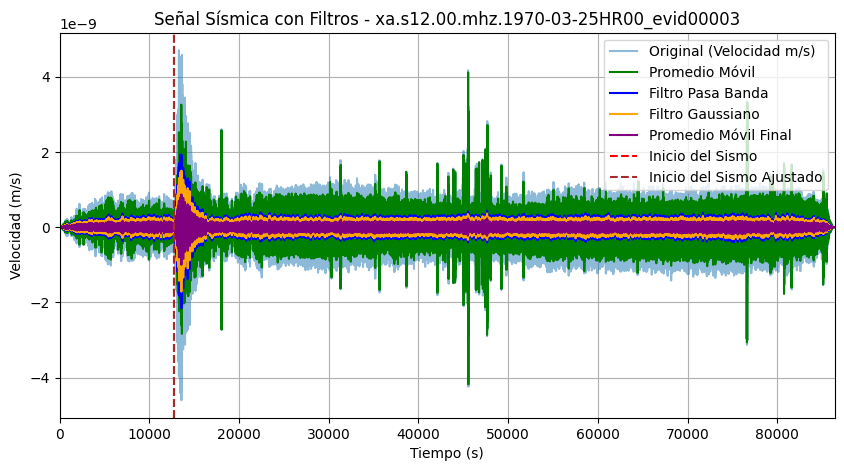

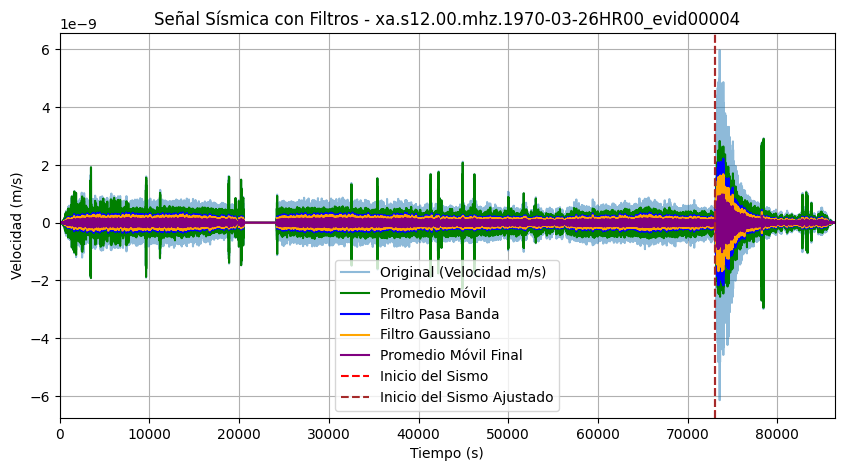

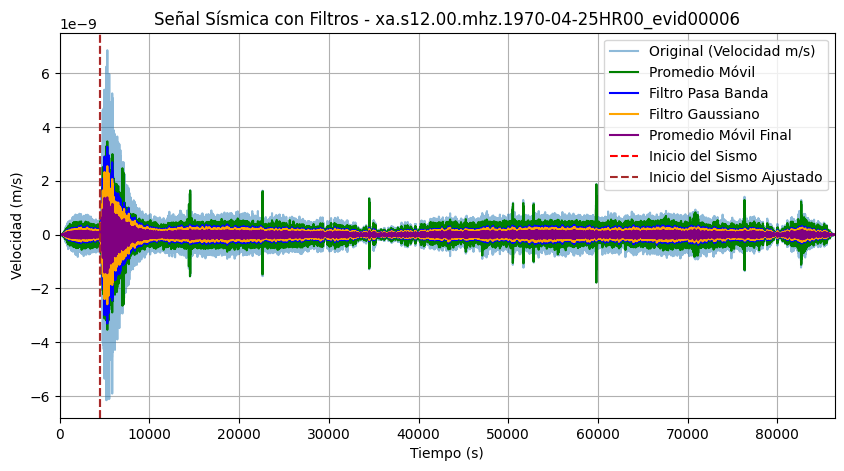

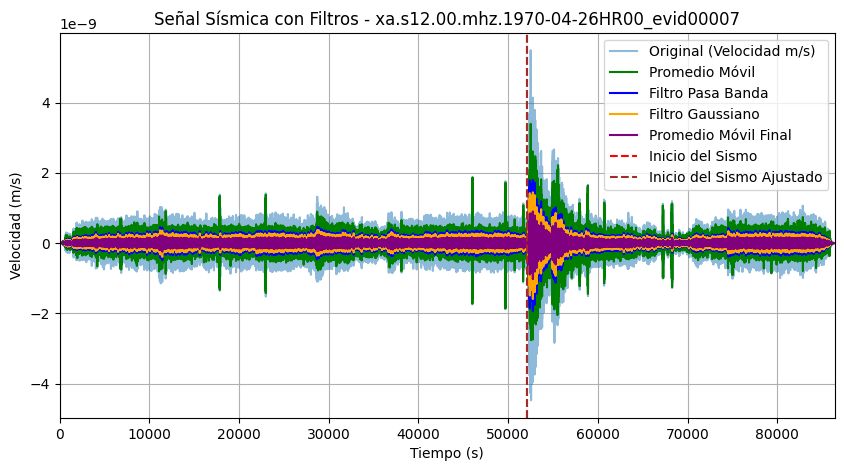

...

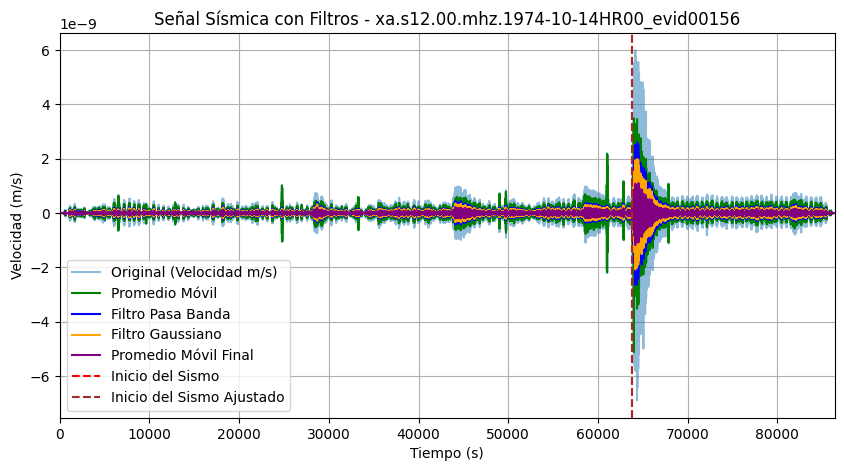

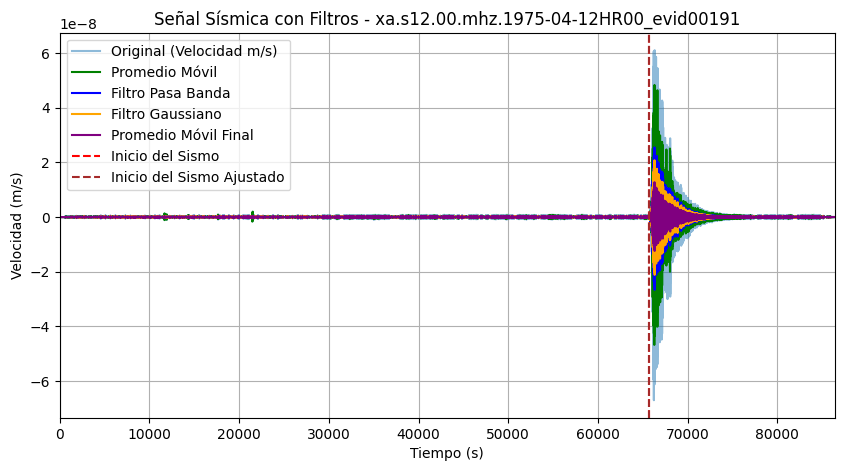

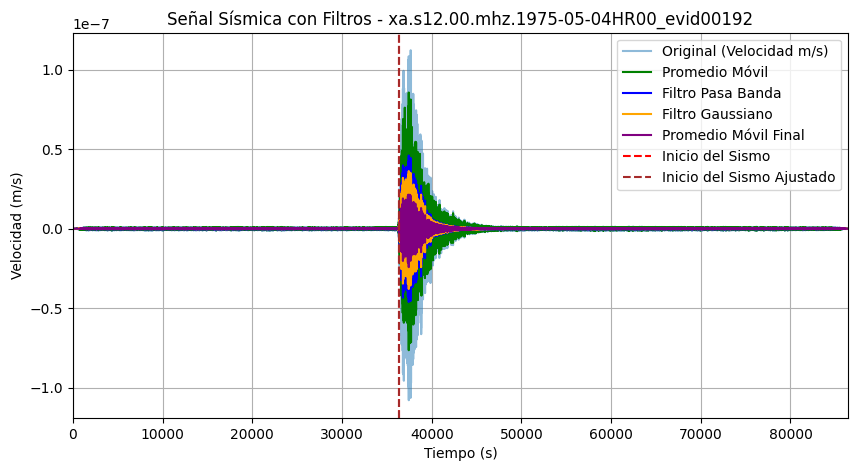

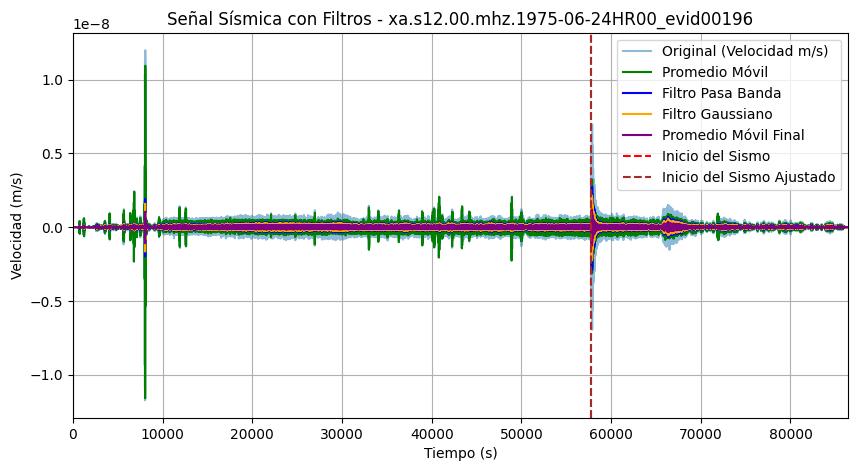

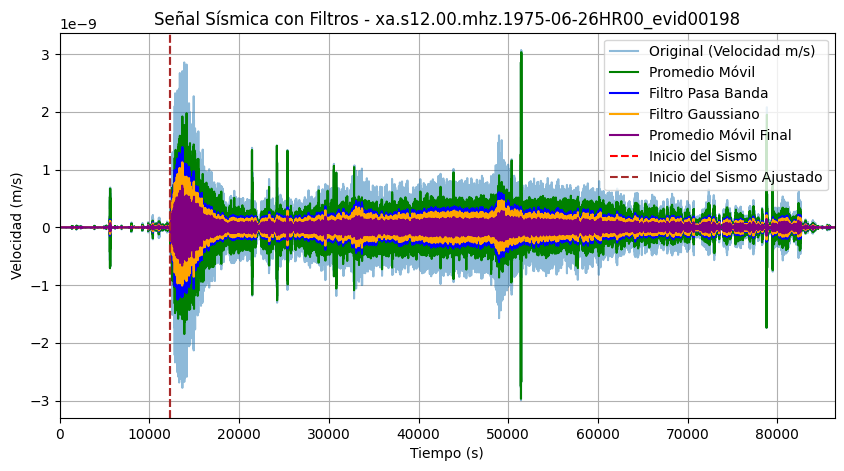

Proceso completado.


In [26]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
from scipy.signal.windows import gaussian
from sklearn.metrics import roc_curve, auc


# Definir el tamaño de la ventana del promedio móvil
window_size = 5  # Ajusta según sea necesario

# Función para aplicar un filtro pasa banda
def bandpass_filter(data, lowcut, highcut, fs, order=2):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, data)

# Función para aplicar un filtro gaussiano
def gaussian_filter(data, sigma=1):
    kernel_size = int(4 * sigma + 1)
    kernel = gaussian(kernel_size, std=sigma)
    kernel /= np.sum(kernel)  # Normalizar el kernel
    return np.convolve(data, kernel, mode='same')

# Definir las frecuencias del filtro pasa banda
lowcut = 0.5  # Frecuencia de corte inferior
highcut = 1.0  # Frecuencia de corte superior
fs = 1.0 / (all_train_csv_times[0][1] - all_train_csv_times[0][0])  # Frecuencia de muestreo

# Crear la carpeta para guardar los datos filtrados si no existe
output_folder = 'data_filtrada1'
os.makedirs(output_folder, exist_ok=True)

# Crear la carpeta para guardar los tiempos de inicio de sismos ajustados
adjusted_arrivals_folder = 'tiempos_inicio_sismos_ajustados'
os.makedirs(adjusted_arrivals_folder, exist_ok=True)

# Graficar cada señal sísmica
for i in range(len(all_train_csv_data)):
    # Aplicar el filtro de promedio móvil
    smoothed_data = np.convolve(all_train_csv_data[i], np.ones(window_size)/window_size, mode='same')
    
    # Aplicar el filtro pasa banda
    filtered_data = bandpass_filter(smoothed_data, lowcut, highcut, fs)

    # Aplicar filtro gaussiano
    smoothed_gaussian = gaussian_filter(filtered_data, sigma=1)

    # Aplicar segundo filtro de promedio móvil con ventana de 5
    final_smoothed_data = np.convolve(smoothed_gaussian, np.ones(5)/5, mode='same')

    # Calcular el tiempo absoluto y el tiempo relativo
    time_abs = all_train_csv_times[i]
    time_rel = time_abs - time_abs[0]  # Tiempo relativo desde el inicio

    # Ajustar el tiempo de llegada del sismo
    adjusted_arrival = arrival_times[i] - time_abs[0]  # Convertir a tiempo relativo

    # Preparar los datos para guardar en el CSV
    data_to_save = np.column_stack((time_abs, time_rel, final_smoothed_data))

    plt.figure(figsize=(10, 5))
    
    # Graficar la señal original
    plt.plot(all_train_csv_times[i], all_train_csv_data[i], label='Original (Velocidad m/s)', alpha=0.5)
    
    # Graficar la señal suavizada con promedio móvil
    plt.plot(all_train_csv_times[i], smoothed_data, label='Promedio Móvil', color='green')
    
    # Graficar la señal filtrada con el filtro pasa banda
    plt.plot(all_train_csv_times[i], filtered_data, label='Filtro Pasa Banda', color='blue')
    
    # Graficar la señal suavizada con filtro gaussiano
    plt.plot(all_train_csv_times[i], smoothed_gaussian, label='Filtro Gaussiano', color='orange')
    
    # Graficar la señal final suavizada con el segundo promedio móvil
    plt.plot(all_train_csv_times[i], final_smoothed_data, label='Promedio Móvil Final', color='purple')

    # Agregar la línea de llegada del sismo
    plt.axvline(x=arrival_times[i], color='red', linestyle='--', label='Inicio del Sismo')
    
    # Agregar la línea de llegada del sismo ajustada
    plt.axvline(x=adjusted_arrival + time_abs[0], color='brown', linestyle='--', label='Inicio del Sismo Ajustado')
    
    # Títulos y etiquetas
    plt.title(f'Señal Sísmica con Filtros - {cat.iloc[i]["filename"].strip()}')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Velocidad (m/s)')
    plt.xlim([min(all_train_csv_times[i]), max(all_train_csv_times[i])])  # Ajustar los límites del eje x
    plt.legend()
    plt.grid()
    
    # Mostrar la gráfica
    plt.show()

    # Guardar los datos finales en un archivo CSV
    output_file = os.path.join(output_folder, f'{cat.iloc[i]["filename"].strip()}_filtrada.csv')
    np.savetxt(output_file, data_to_save, delimiter=',', 
               header='time_abs, time_rel, velocity', comments='')  # Guardar con las columnas deseadas   

    # Guardar el tiempo de inicio ajustado en un archivo CSV
    adjusted_arrival_file = os.path.join(adjusted_arrivals_folder, f'{cat.iloc[i]["filename"].strip()}_inicio_ajustado.csv')
    np.savetxt(adjusted_arrival_file, [adjusted_arrival], delimiter=',', header='adjusted_arrival_time', comments='')

print("Proceso completado.")


Filtered Files Ordenados:
xa.s12.00.mhz.1970-01-19HR00_evid00002_filtrada.csv
xa.s12.00.mhz.1970-03-25HR00_evid00003_filtrada.csv
xa.s12.00.mhz.1970-03-26HR00_evid00004_filtrada.csv
xa.s12.00.mhz.1970-04-25HR00_evid00006_filtrada.csv
xa.s12.00.mhz.1970-04-26HR00_evid00007_filtrada.csv
xa.s12.00.mhz.1970-06-15HR00_evid00008_filtrada.csv
xa.s12.00.mhz.1970-06-26HR00_evid00009_filtrada.csv
xa.s12.00.mhz.1970-07-20HR00_evid00010_filtrada.csv
xa.s12.00.mhz.1970-07-20HR00_evid00011_filtrada.csv
xa.s12.00.mhz.1970-09-26HR00_evid00013_filtrada.csv
xa.s12.00.mhz.1970-10-24HR00_evid00014_filtrada.csv
xa.s12.00.mhz.1970-11-12HR00_evid00015_filtrada.csv
xa.s12.00.mhz.1970-12-11HR00_evid00017_filtrada.csv
xa.s12.00.mhz.1970-12-27HR00_evid00019_filtrada.csv
xa.s12.00.mhz.1970-12-31HR00_evid00021_filtrada.csv
xa.s12.00.mhz.1971-01-15HR00_evid00022_filtrada.csv
xa.s12.00.mhz.1971-01-28HR00_evid00023_filtrada.csv
xa.s12.00.mhz.1971-01-29HR00_evid00024_filtrada.csv
xa.s12.00.mhz.1971-02-09HR00_evid00026

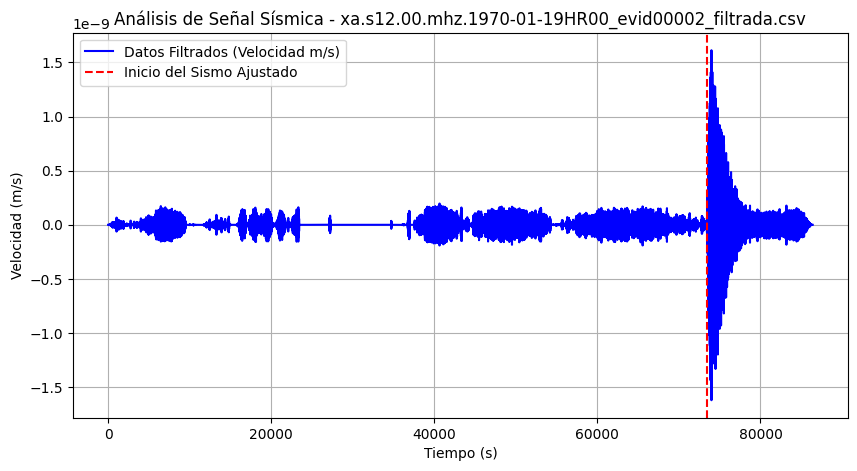

Tiempo ajustado leído: 12720
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


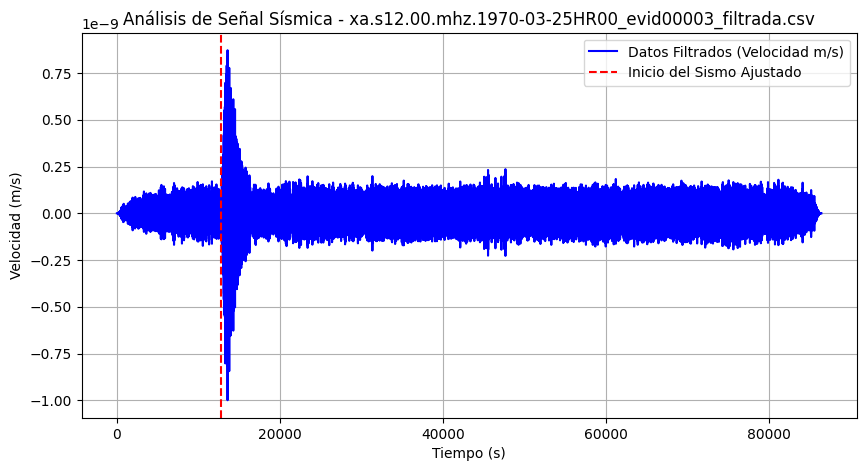

Tiempo ajustado leído: 73020
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


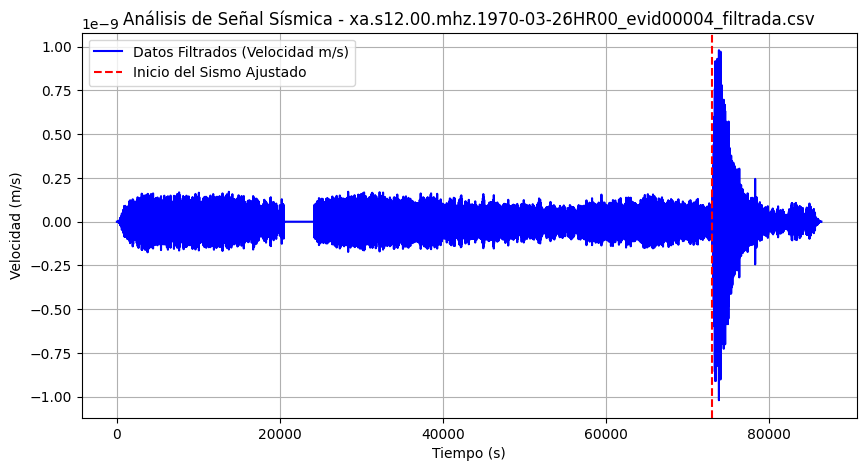

Tiempo ajustado leído: 4440
Rango de tiempo: 0.0 a 86402.11320754717
Línea de inicio del sismo graficada.


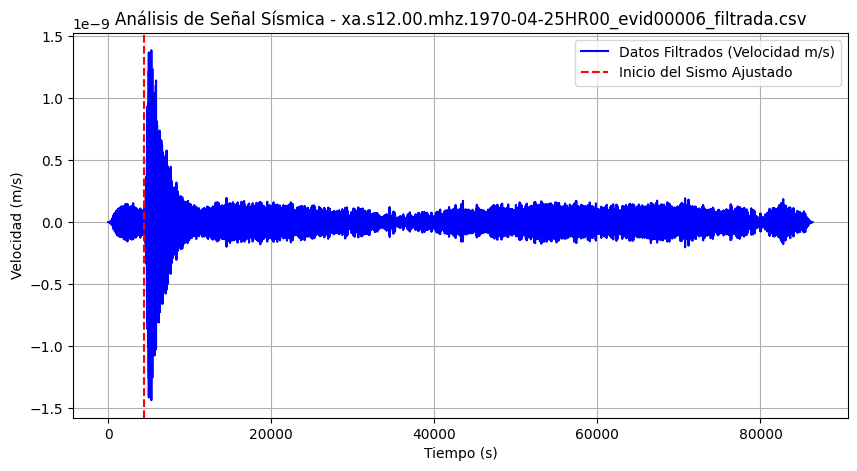

Tiempo ajustado leído: 52140
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


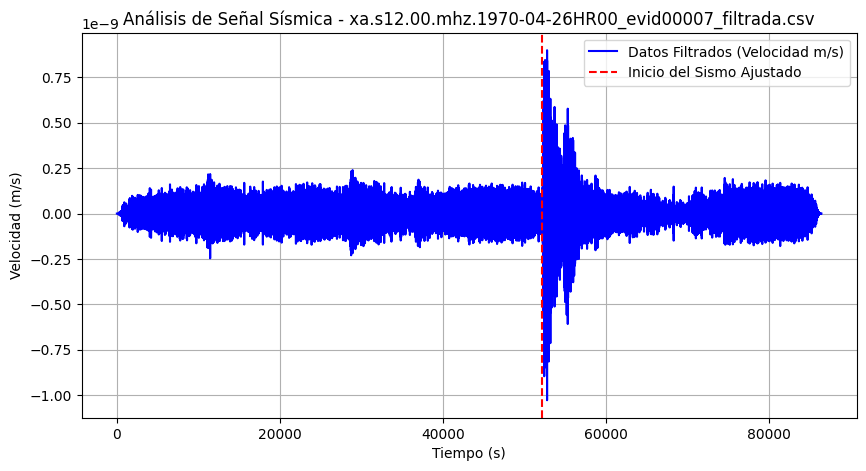

Tiempo ajustado leído: 68400
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


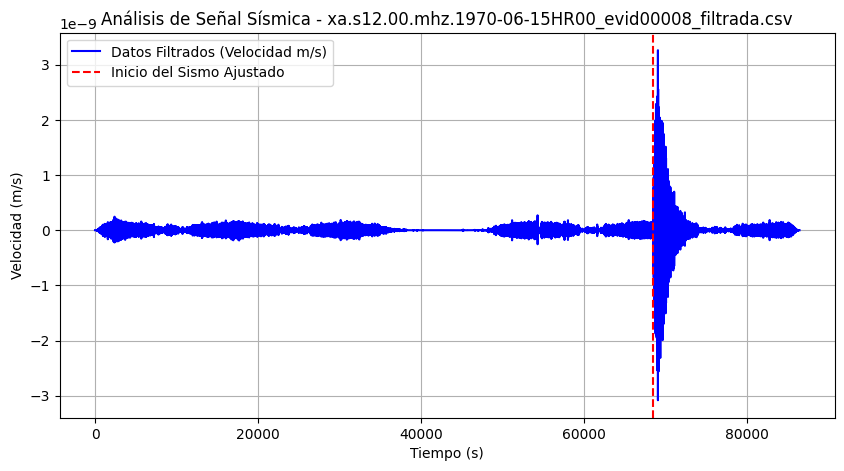

Tiempo ajustado leído: 72060
Rango de tiempo: 0.0 a 86403.32075471699
Línea de inicio del sismo graficada.


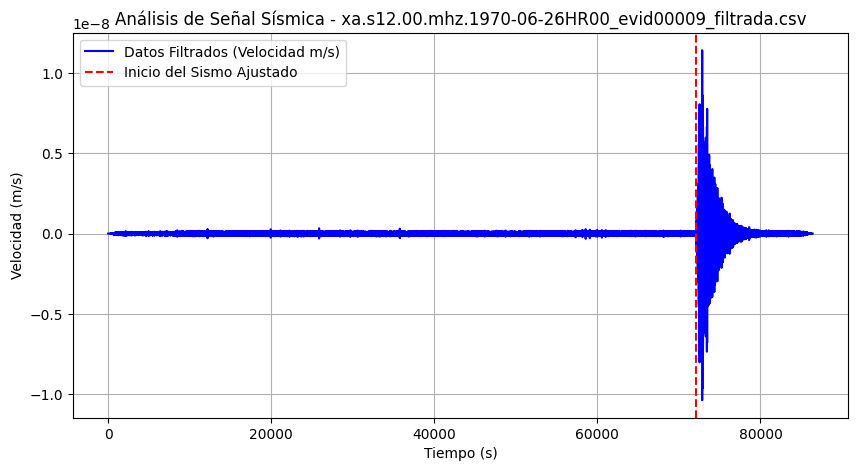

Tiempo ajustado leído: 18360
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


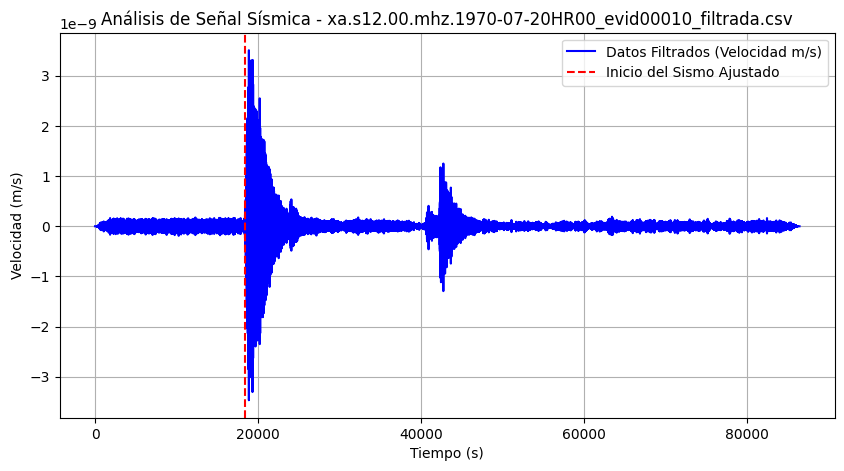

Tiempo ajustado leído: 42240
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


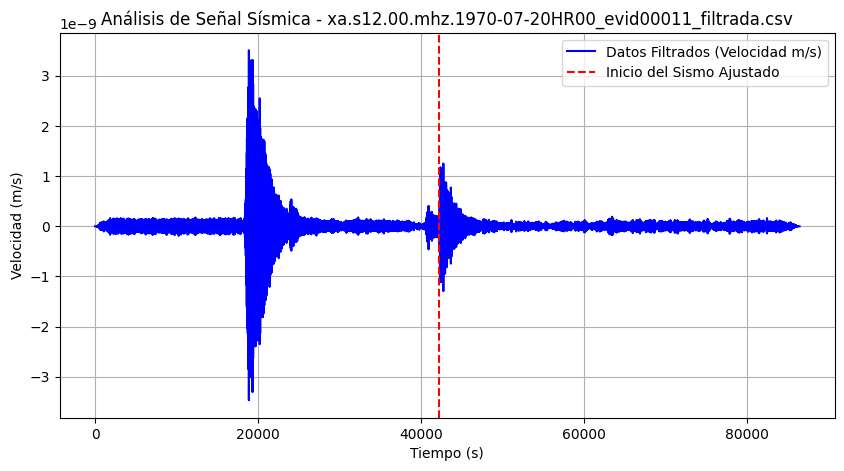

Tiempo ajustado leído: 71820
Rango de tiempo: 0.0 a 86403.32075471699
Línea de inicio del sismo graficada.


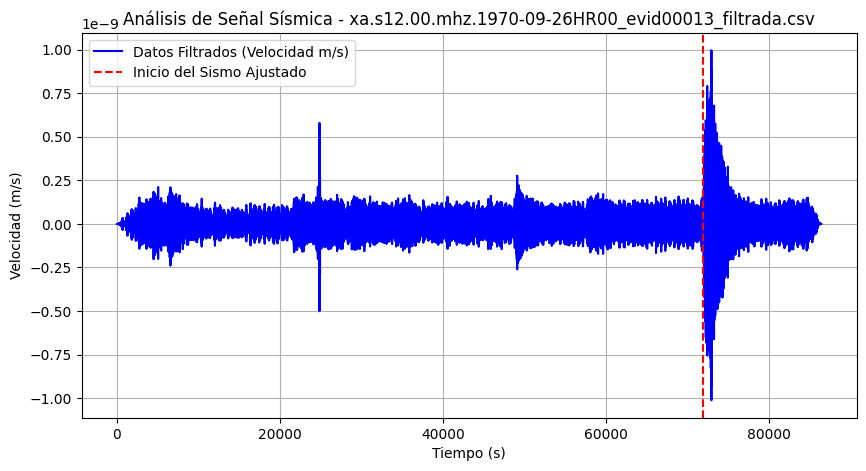

Tiempo ajustado leído: 41460
Rango de tiempo: 0.0 a 86402.8679245283
Línea de inicio del sismo graficada.


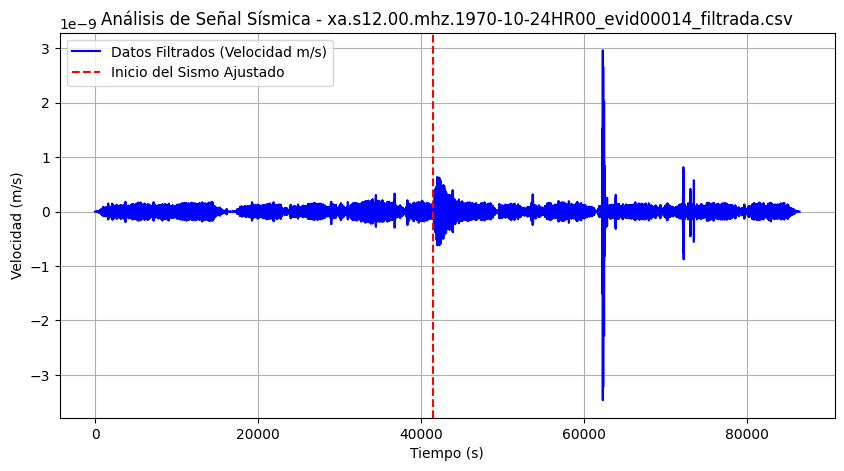

Tiempo ajustado leído: 46200
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


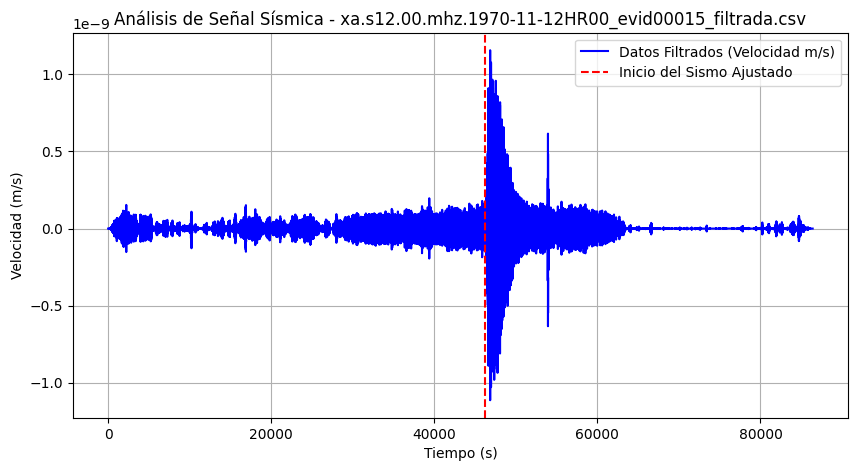

Tiempo ajustado leído: 26520
Rango de tiempo: 0.0 a 86402.11320754717
Línea de inicio del sismo graficada.


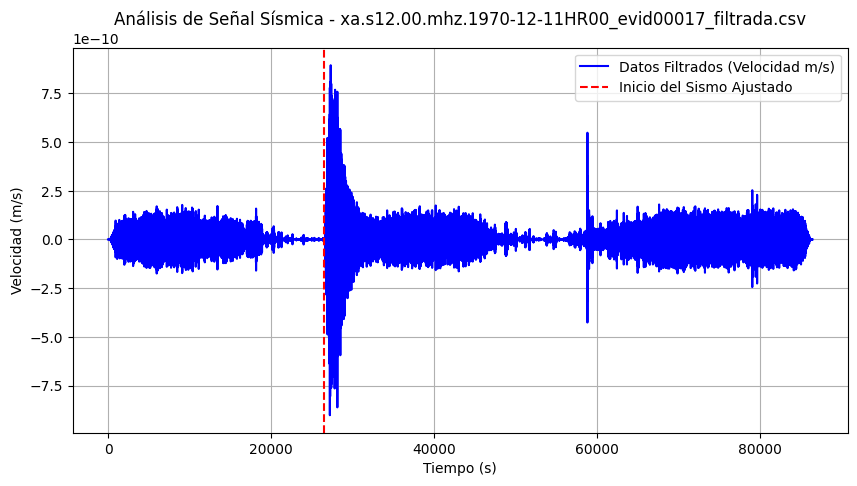

Tiempo ajustado leído: 74040
Rango de tiempo: 0.0 a 86403.32075471699
Línea de inicio del sismo graficada.


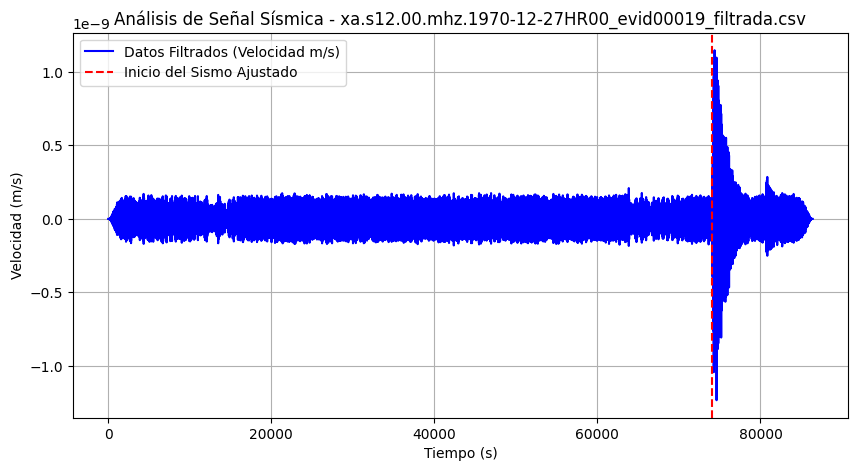

Tiempo ajustado leído: 56460
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


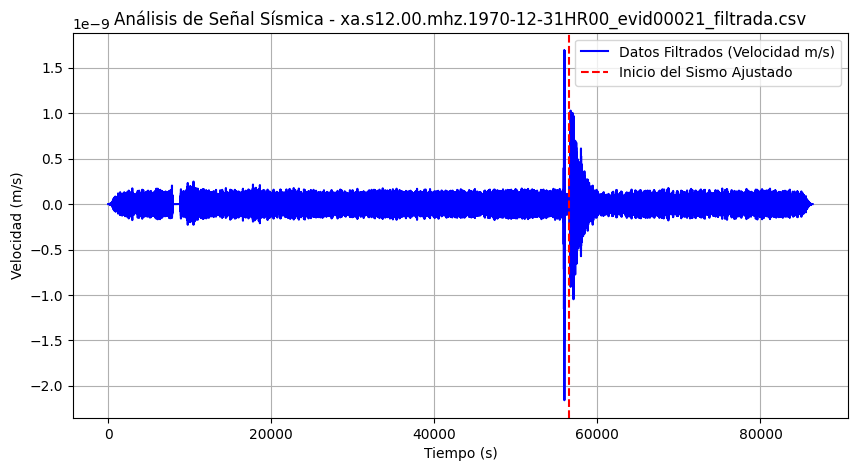

Tiempo ajustado leído: 45600
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


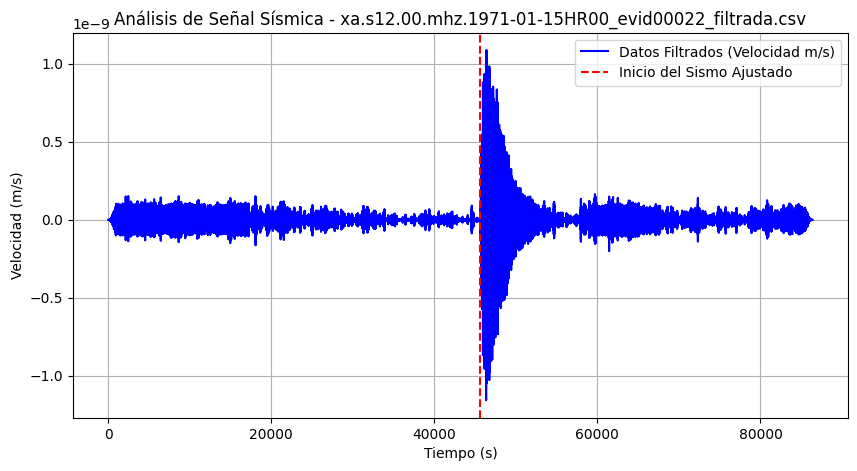

Tiempo ajustado leído: 53940
Rango de tiempo: 0.0 a 86403.32075471699
Línea de inicio del sismo graficada.


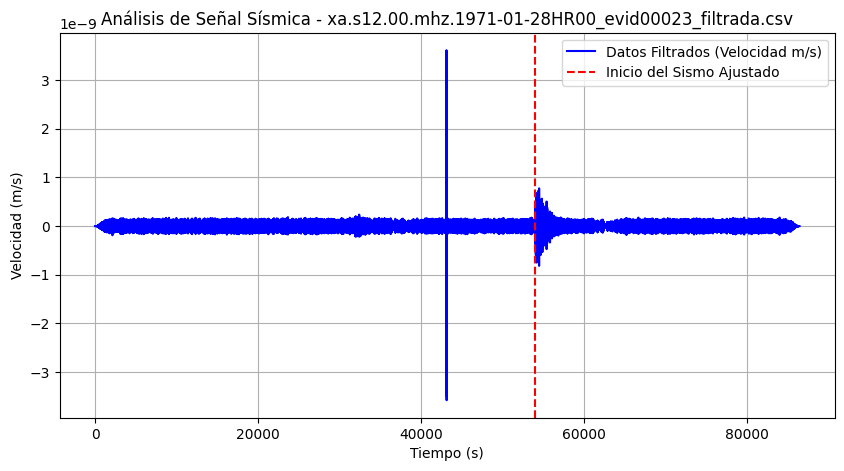

Tiempo ajustado leído: 66060
Rango de tiempo: 0.0 a 86403.32075471699
Línea de inicio del sismo graficada.


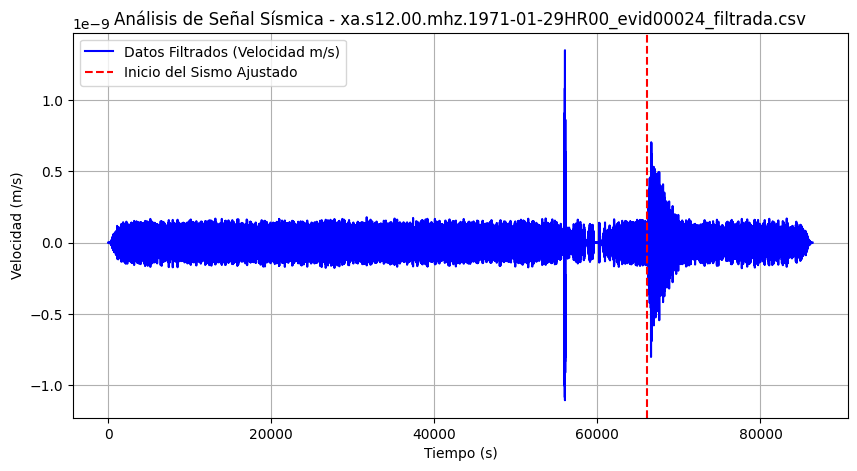

Tiempo ajustado leído: 13320
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


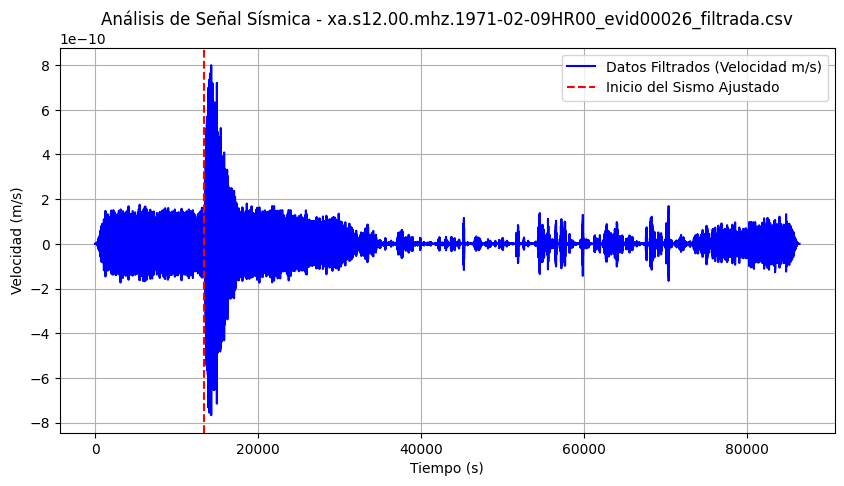

Tiempo ajustado leído: 55080
Rango de tiempo: 0.0 a 86403.92452830188
Línea de inicio del sismo graficada.


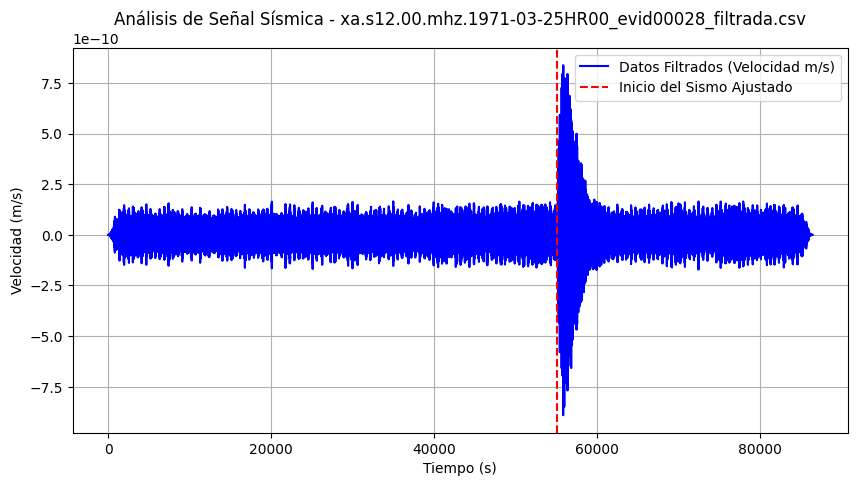

Tiempo ajustado leído: 46500
Rango de tiempo: 0.0 a 71685.1320754717
Línea de inicio del sismo graficada.


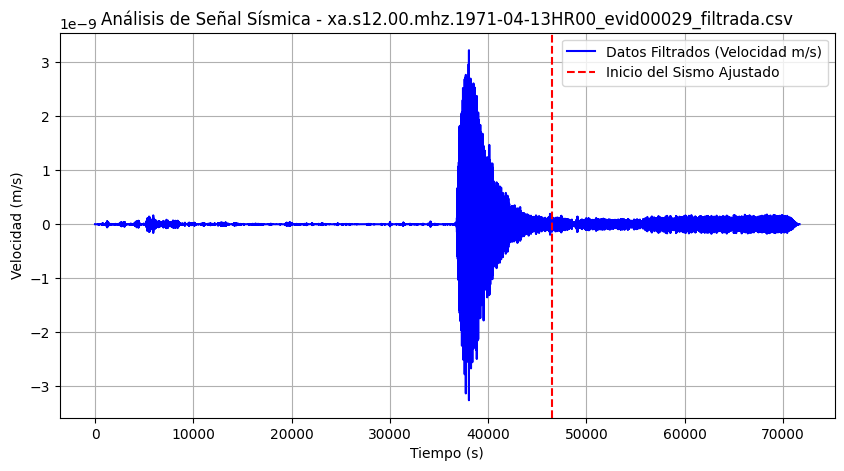

Tiempo ajustado leído: 25440
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


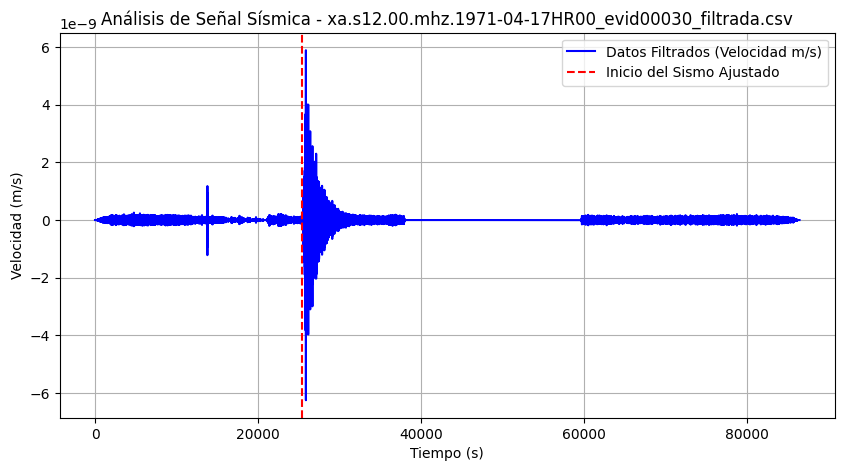

Tiempo ajustado leído: 29100
Rango de tiempo: 0.0 a 86400.90566037736
Línea de inicio del sismo graficada.


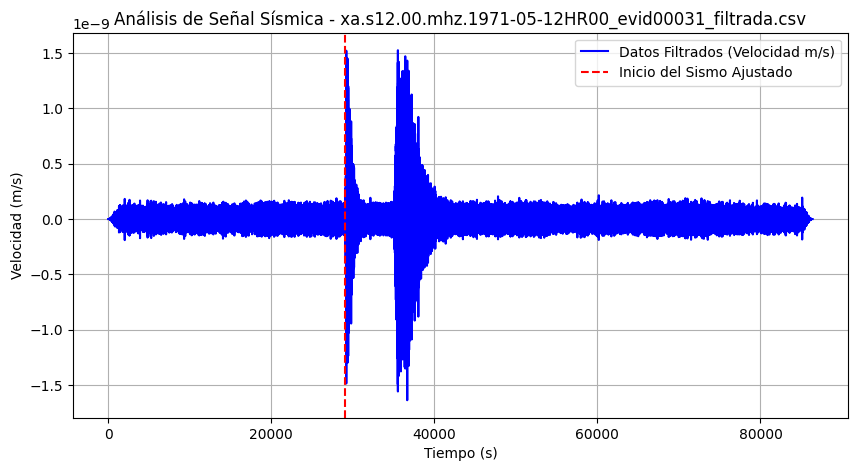

Tiempo ajustado leído: 35100
Rango de tiempo: 0.0 a 86400.90566037736
Línea de inicio del sismo graficada.


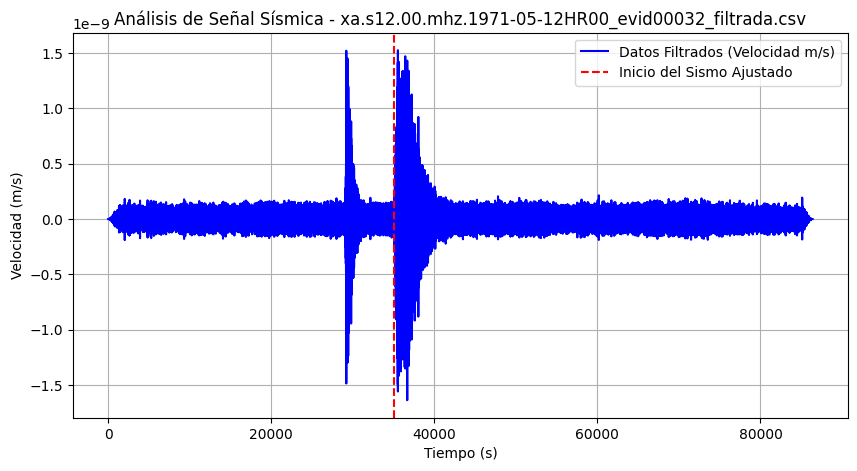

Tiempo ajustado leído: 10800
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


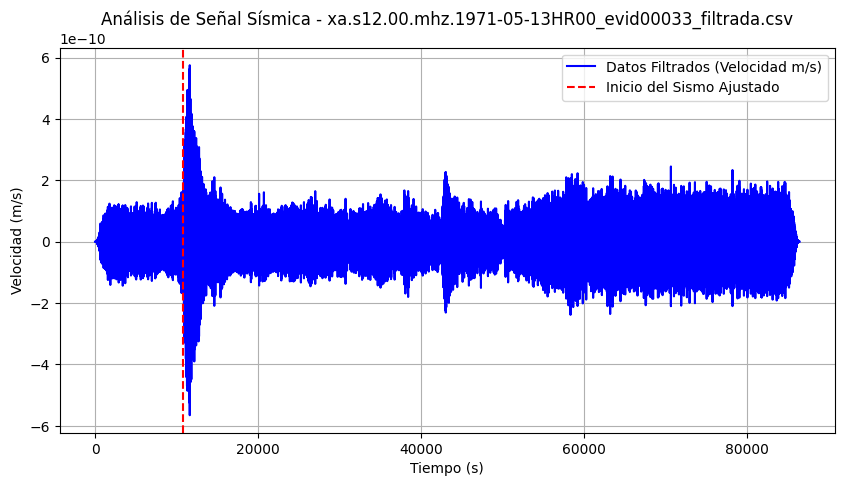

Tiempo ajustado leído: 80400
Rango de tiempo: 0.0 a 86403.32075471699
Línea de inicio del sismo graficada.


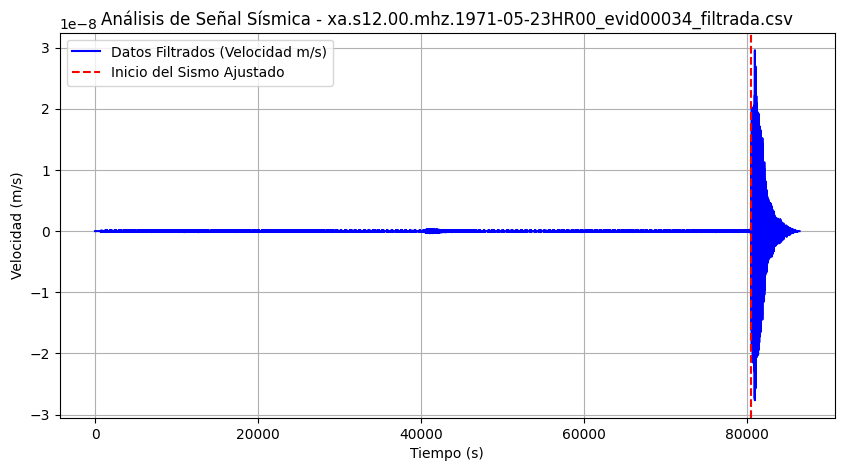

Tiempo ajustado leído: 39060
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


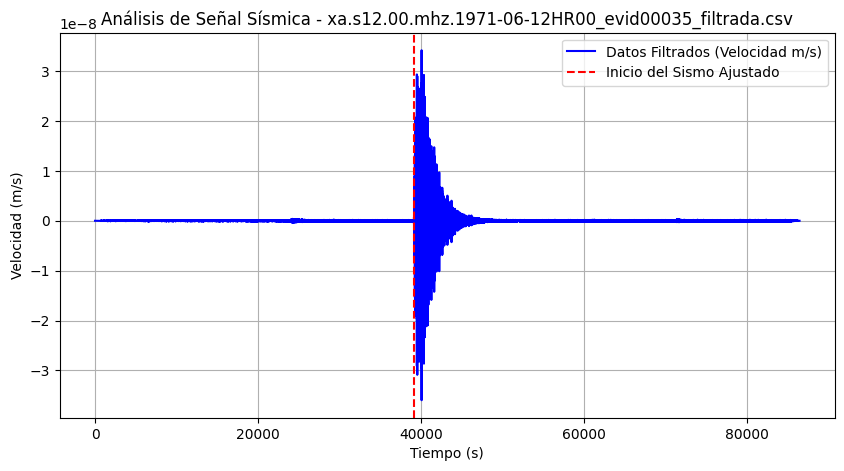

Tiempo ajustado leído: 32220
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


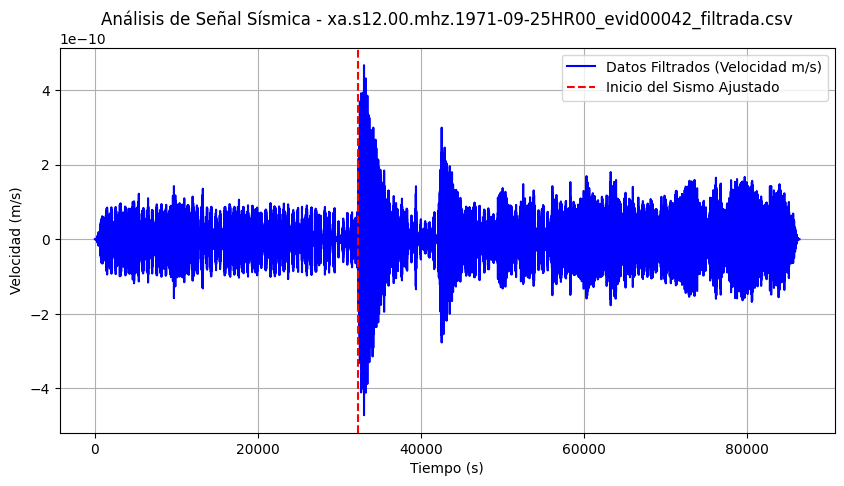

Tiempo ajustado leído: 11940
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


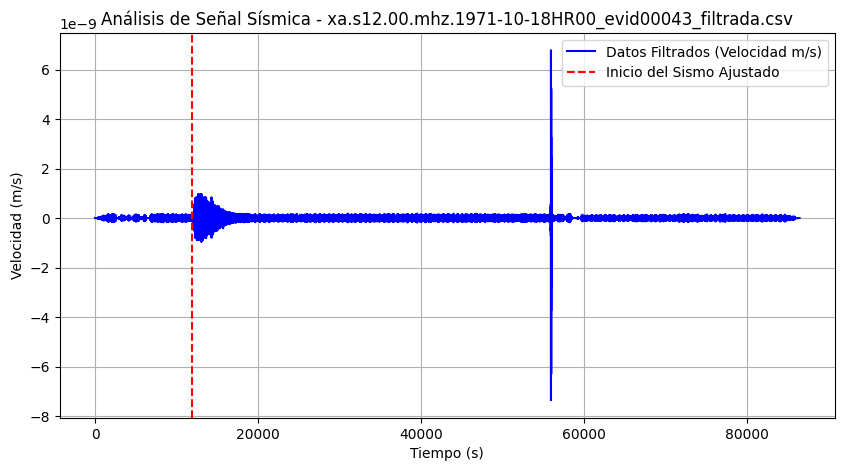

Tiempo ajustado leído: 65280
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


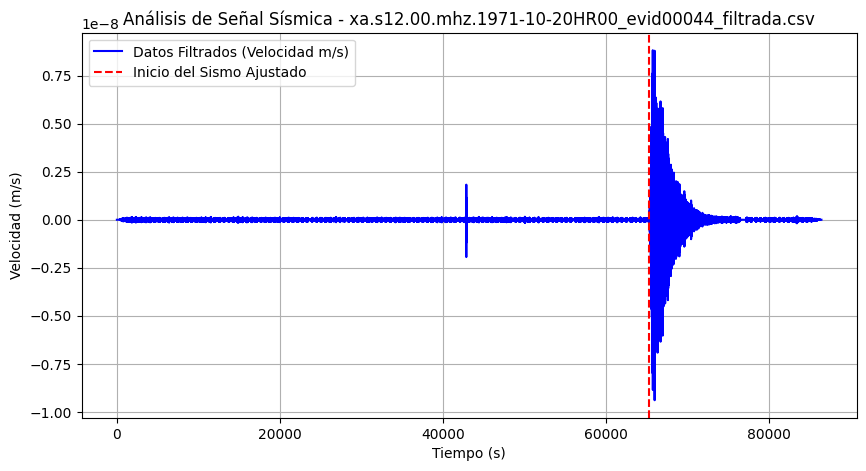

Tiempo ajustado leído: 19800
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


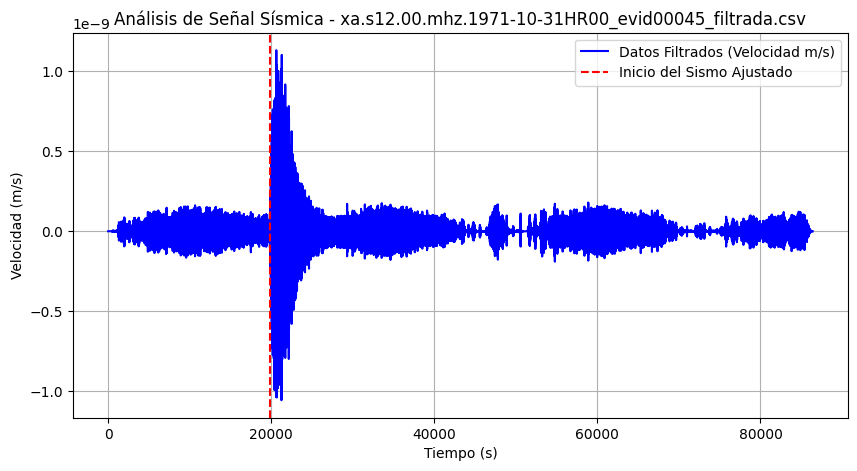

Tiempo ajustado leído: 15420
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


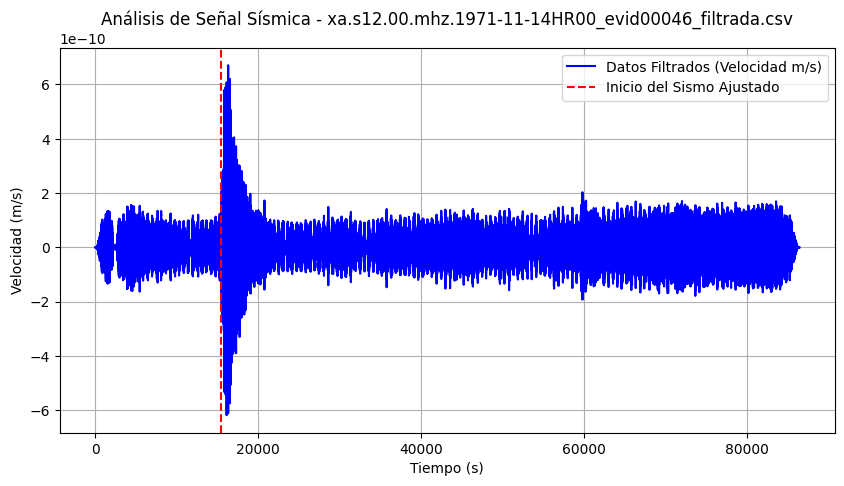

Tiempo ajustado leído: 23700
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


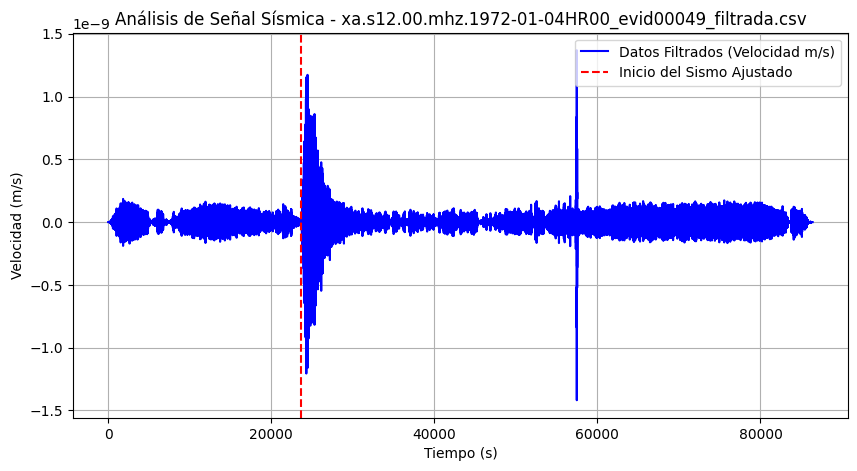

Tiempo ajustado leído: 64800
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


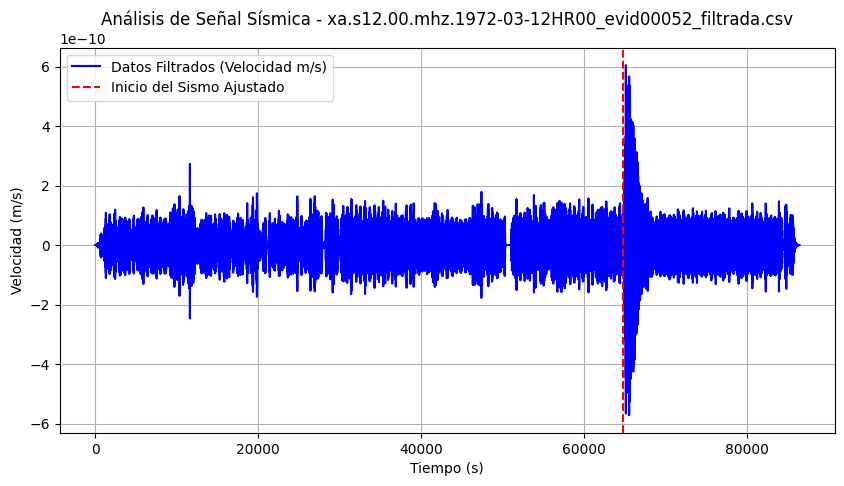

Tiempo ajustado leído: 48900
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


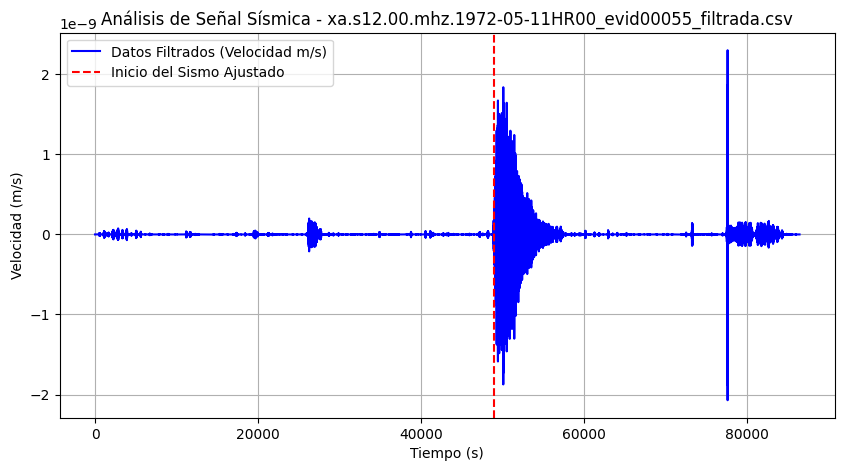

Tiempo ajustado leído: 58260
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


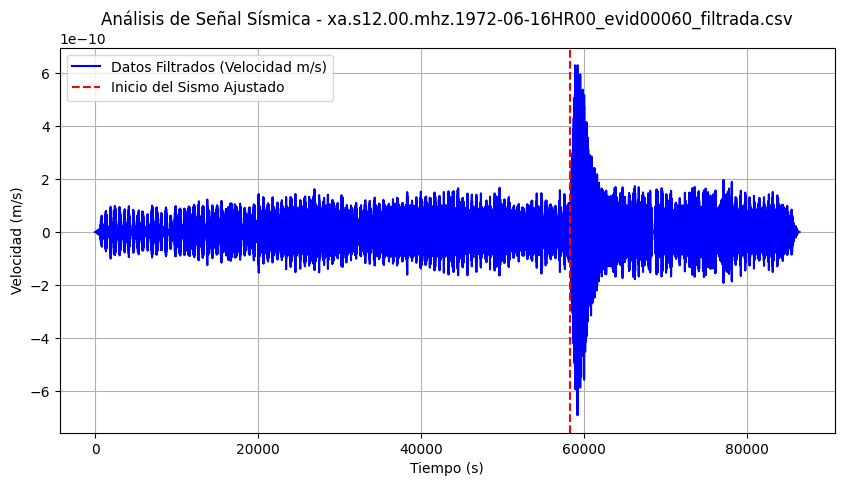

Tiempo ajustado leído: 28200
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


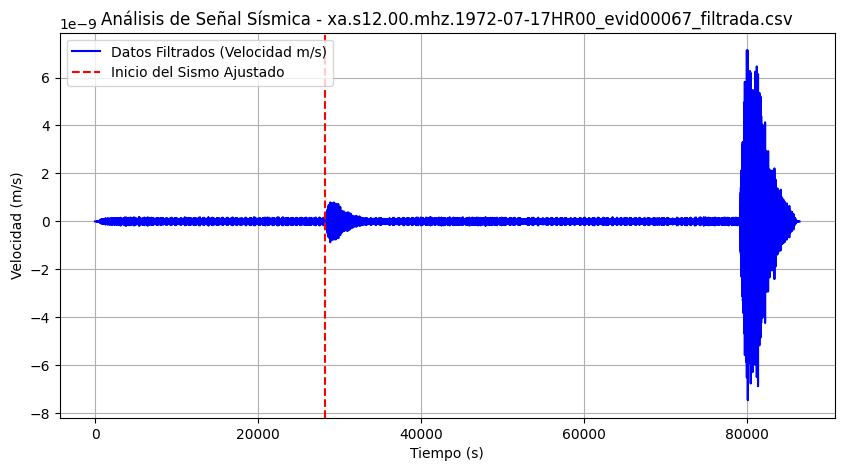

Tiempo ajustado leído: 78960
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


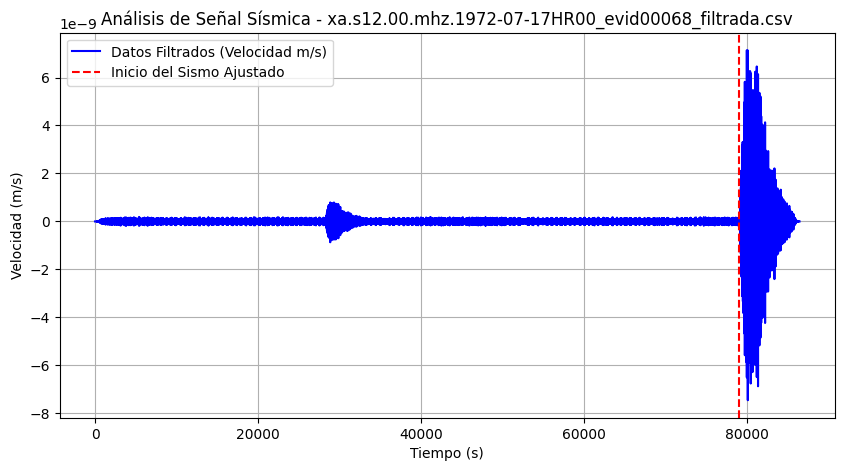

Tiempo ajustado leído: 8580
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


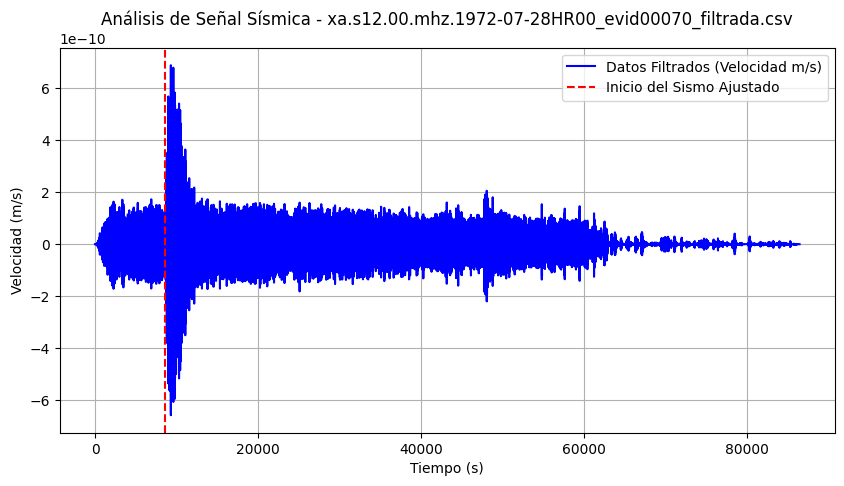

Tiempo ajustado leído: 65280
Rango de tiempo: 0.0 a 86402.11320754717
Línea de inicio del sismo graficada.


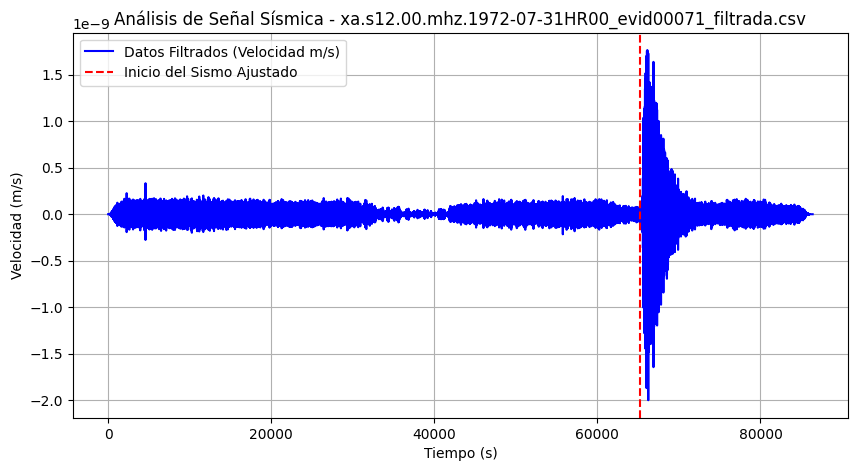

Tiempo ajustado leído: 28680
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


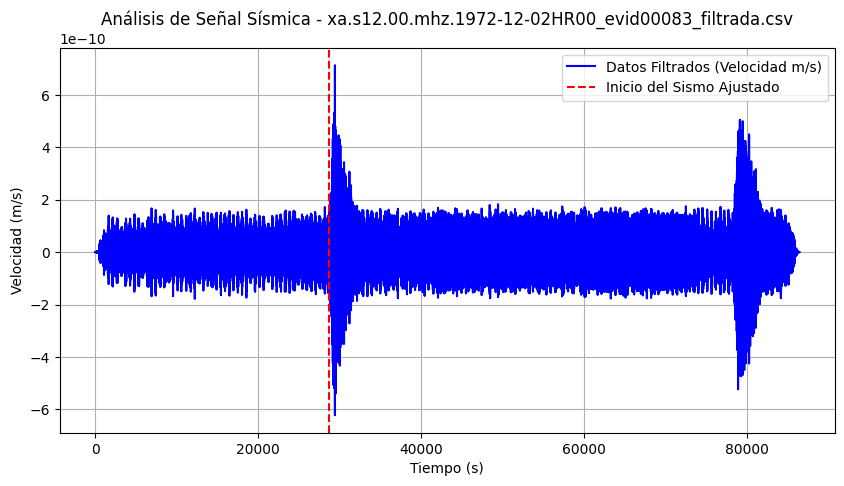

Tiempo ajustado leído: 9480
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


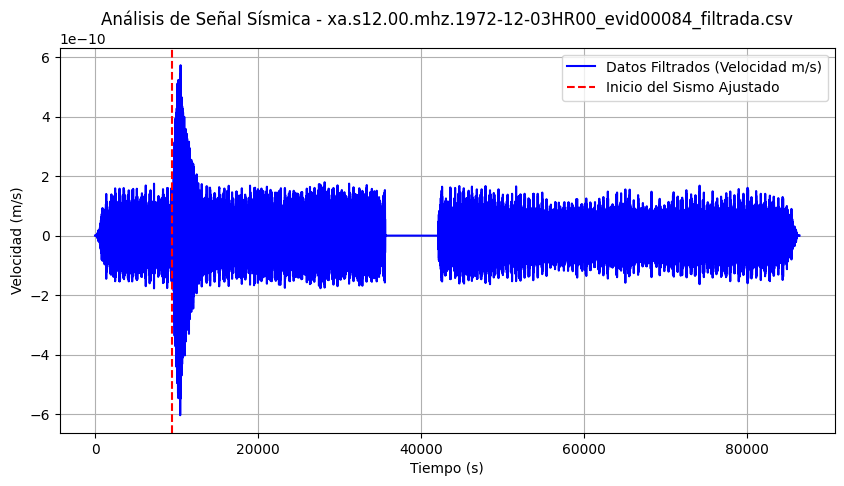

Tiempo ajustado leído: 82860
Rango de tiempo: 0.0 a 86402.11320754717
Línea de inicio del sismo graficada.


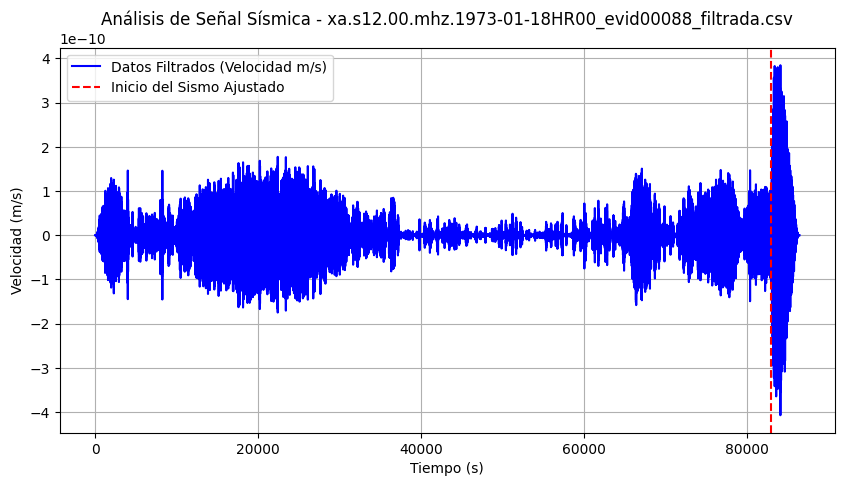

Tiempo ajustado leído: 2640
Rango de tiempo: 0.0 a 86399.09433962264
Línea de inicio del sismo graficada.


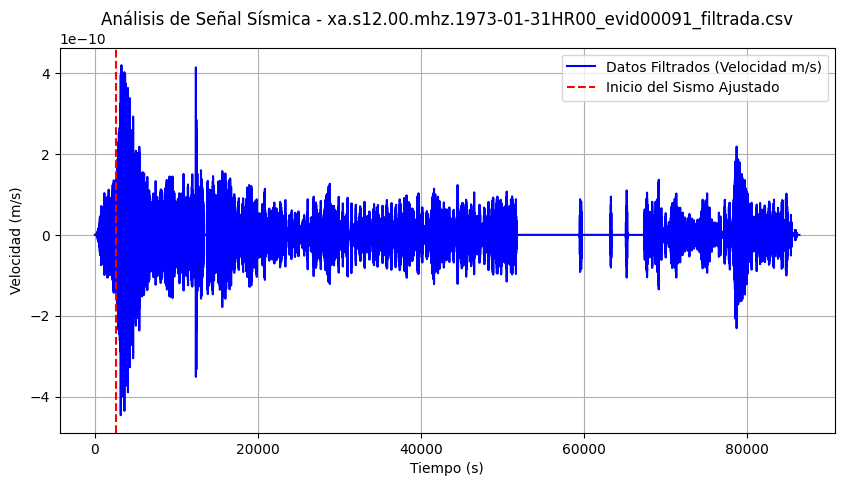

Tiempo ajustado leído: 26100
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


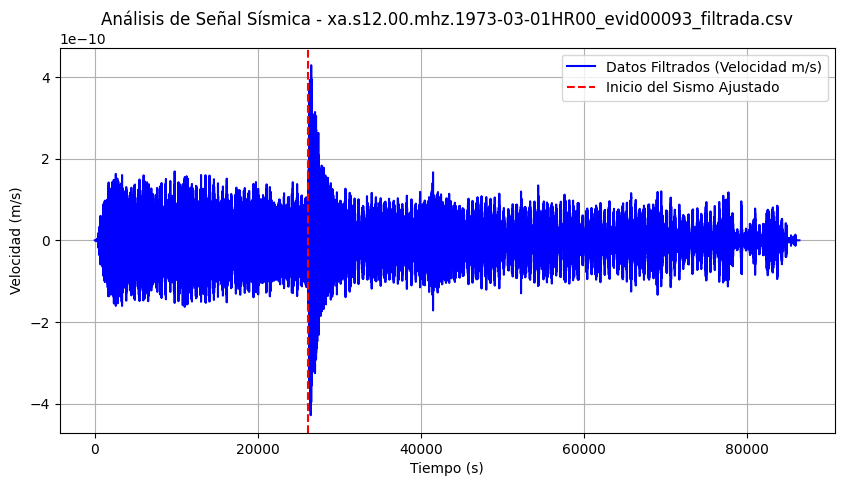

Tiempo ajustado leído: 28860
Rango de tiempo: 0.0 a 51679.54716981132
Línea de inicio del sismo graficada.


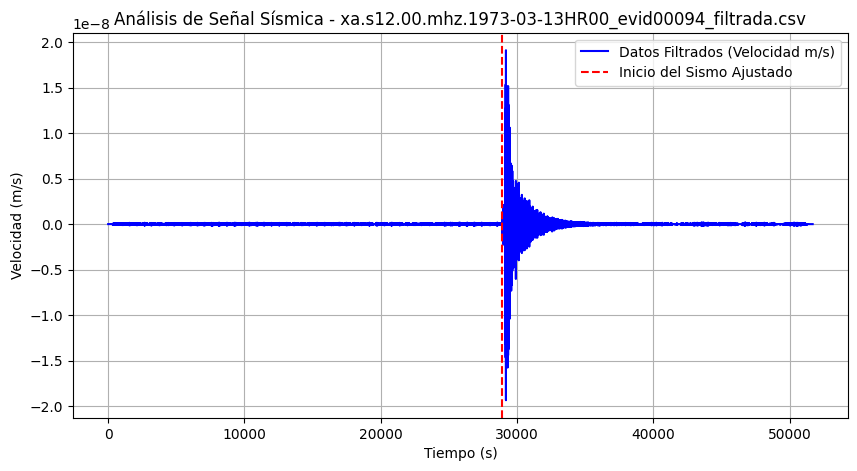

Tiempo ajustado leído: 69780
Rango de tiempo: 0.0 a 86379.16981132075
Línea de inicio del sismo graficada.


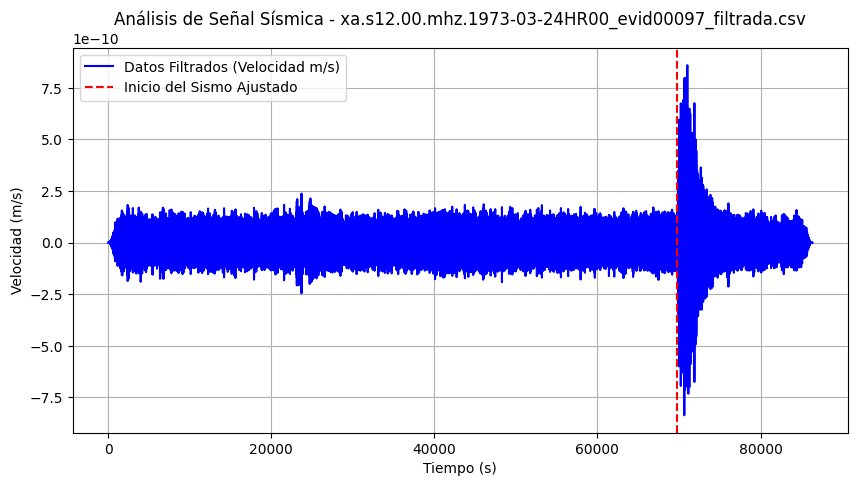

Tiempo ajustado leído: 2640
Rango de tiempo: 0.0 a 86402.11320754717
Línea de inicio del sismo graficada.


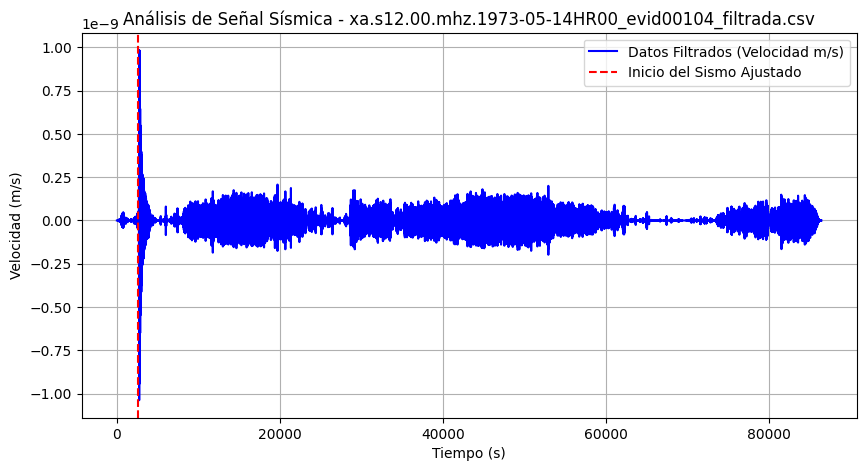

Tiempo ajustado leído: 9480
Rango de tiempo: 0.0 a 86399.09433962264
Línea de inicio del sismo graficada.


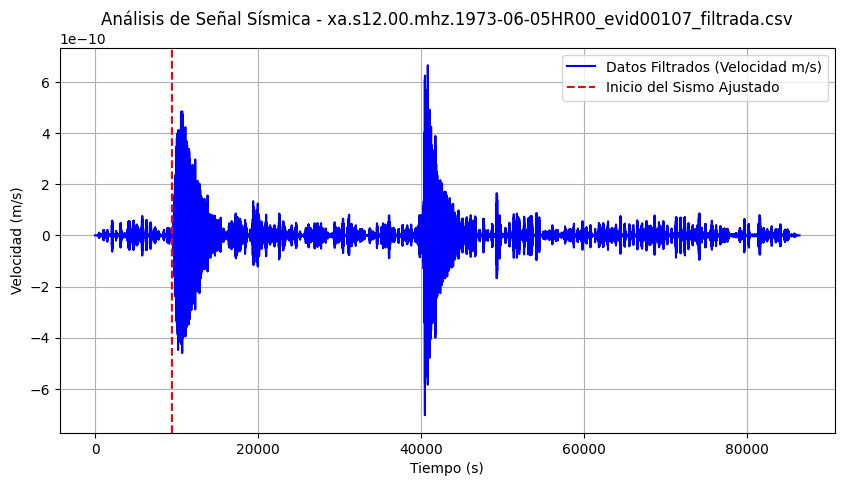

Tiempo ajustado leído: 40200
Rango de tiempo: 0.0 a 86399.09433962264
Línea de inicio del sismo graficada.


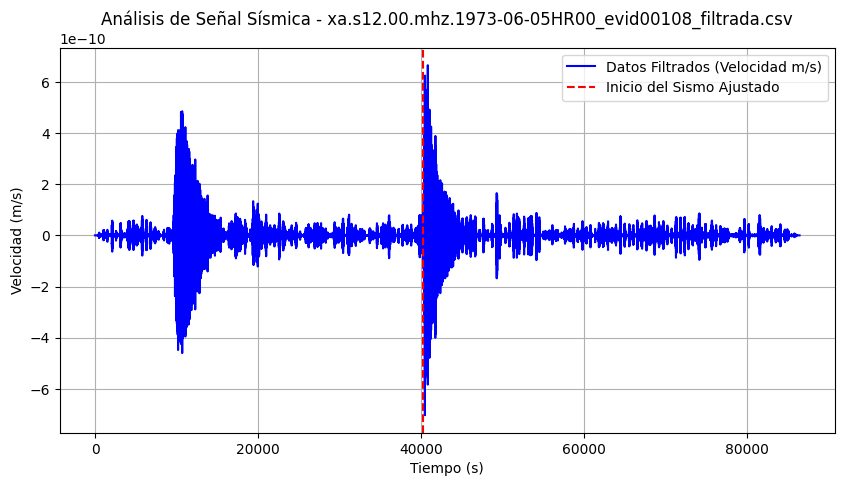

Tiempo ajustado leído: 6120
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


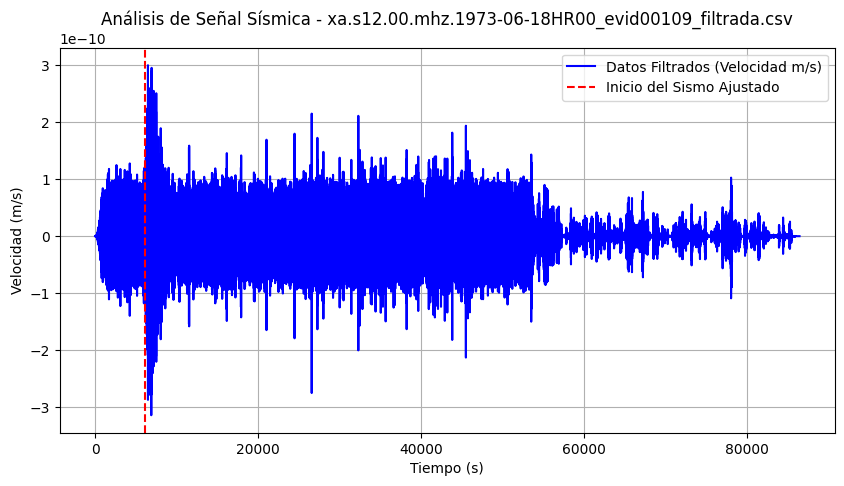

Tiempo ajustado leído: 66960
Rango de tiempo: 0.0 a 86399.69811320755
Línea de inicio del sismo graficada.


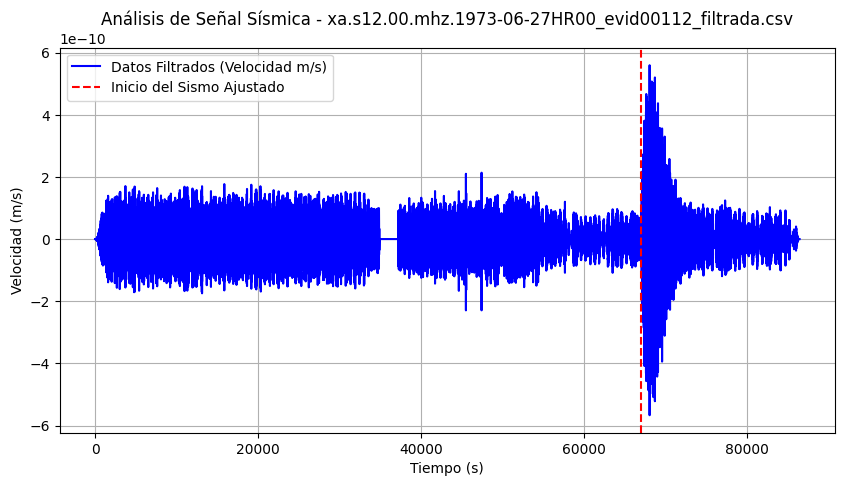

Tiempo ajustado leído: 65700
Rango de tiempo: 0.0 a 86399.09433962264
Línea de inicio del sismo graficada.


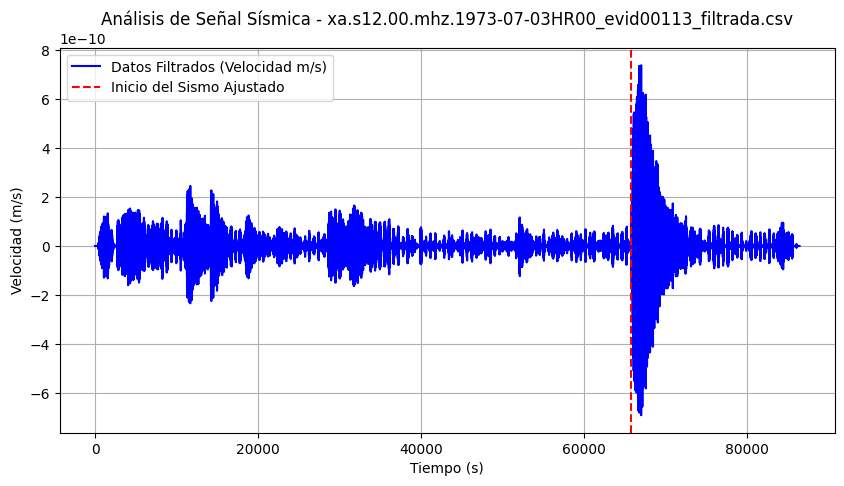

Tiempo ajustado leído: 9960
Rango de tiempo: 0.0 a 86399.09433962264
Línea de inicio del sismo graficada.


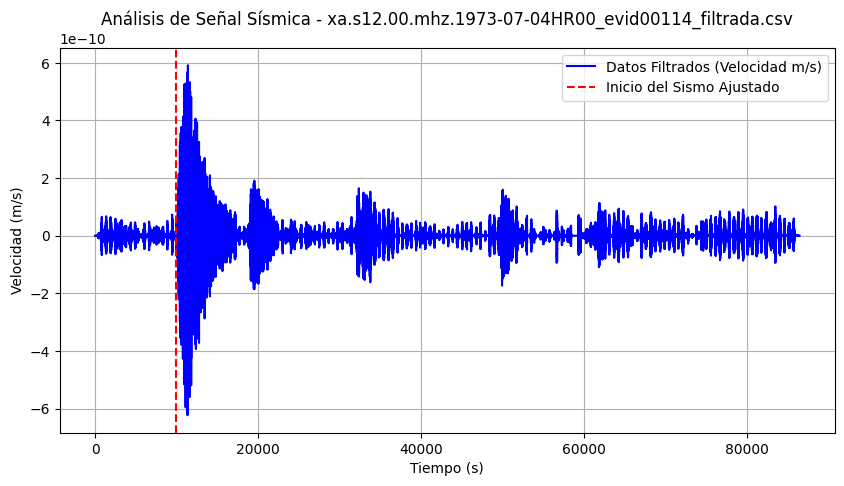

Tiempo ajustado leído: 68520
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


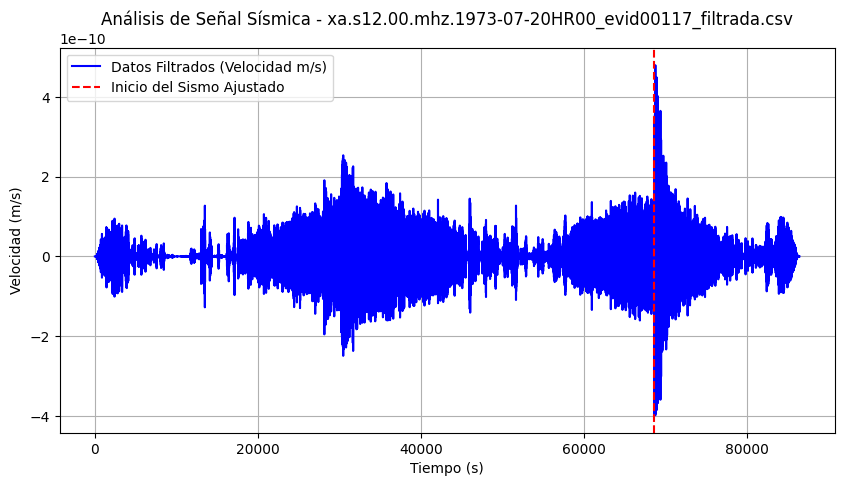

Tiempo ajustado leído: 3120
Rango de tiempo: 0.0 a 86399.09433962264
Línea de inicio del sismo graficada.


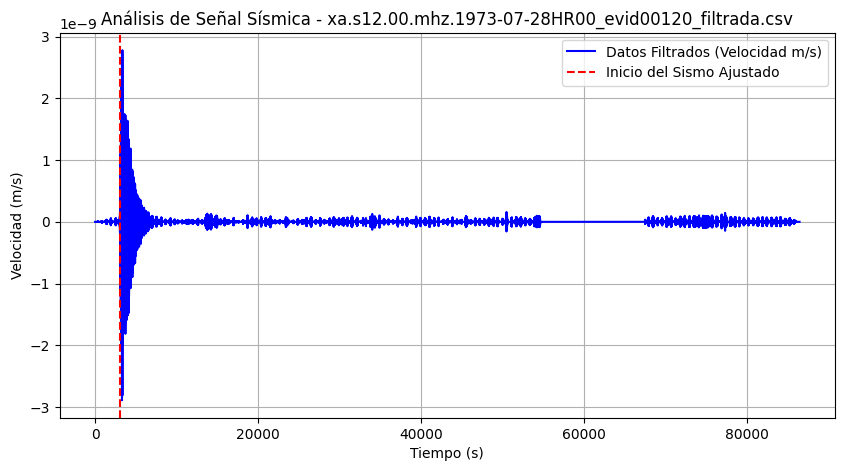

Tiempo ajustado leído: 84660
Rango de tiempo: 0.0 a 86399.09433962264
Línea de inicio del sismo graficada.


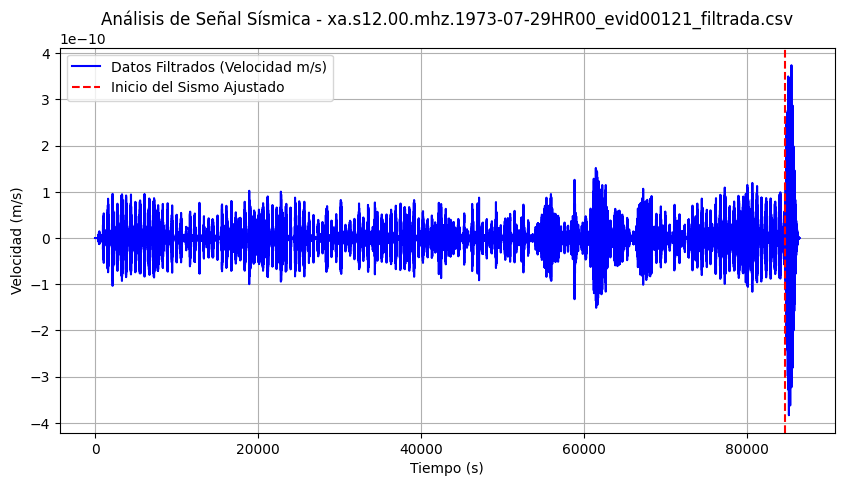

Tiempo ajustado leído: 44220
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


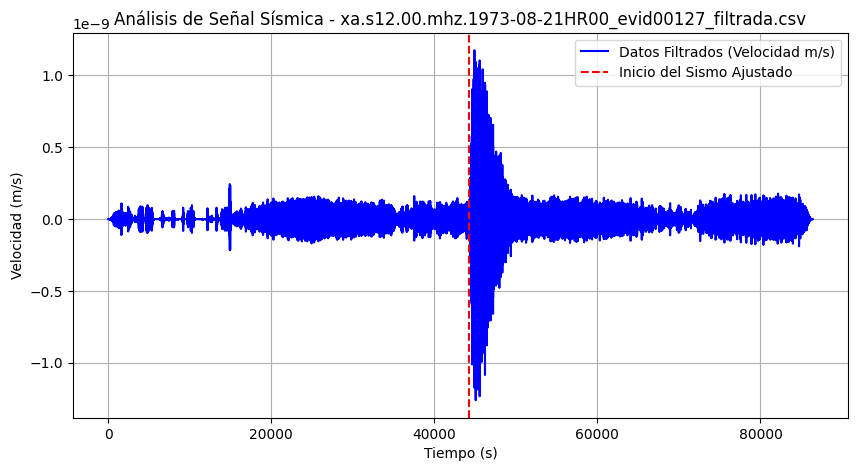

Tiempo ajustado leído: 84060
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


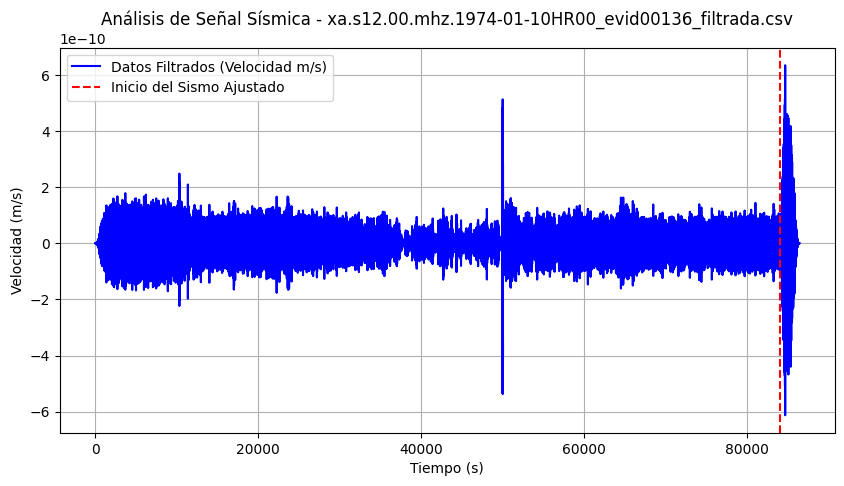

Tiempo ajustado leído: 22860
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


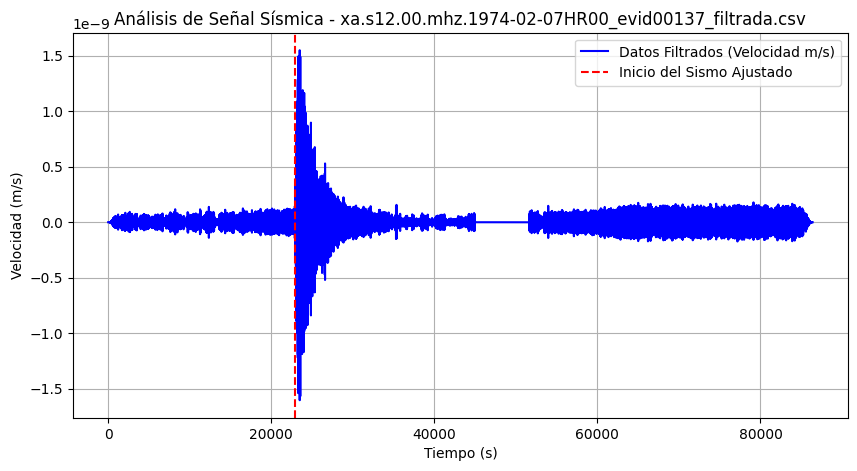

Tiempo ajustado leído: 81000
Rango de tiempo: 0.0 a 86402.11320754717
Línea de inicio del sismo graficada.


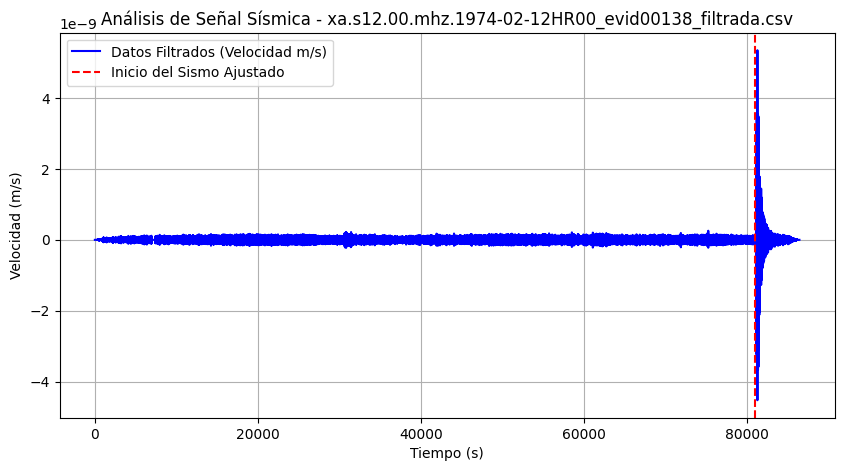

Tiempo ajustado leído: 61080
Rango de tiempo: 0.0 a 86398.3396226415
Línea de inicio del sismo graficada.


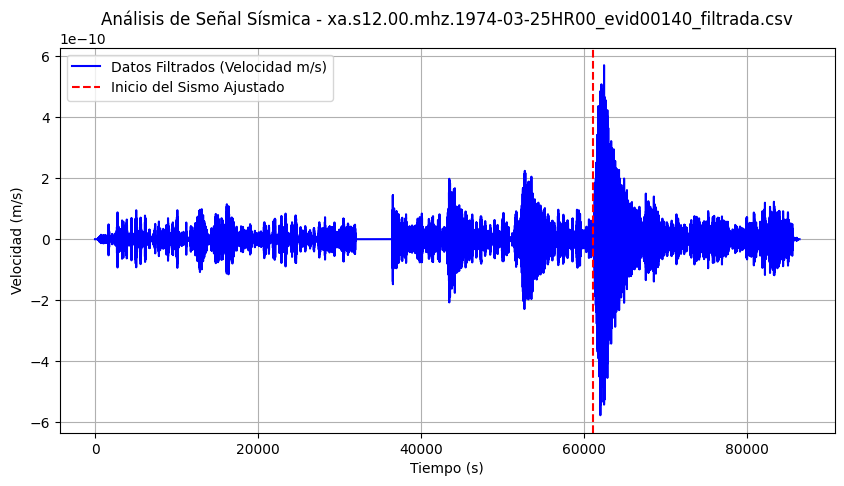

Tiempo ajustado leído: 31200
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


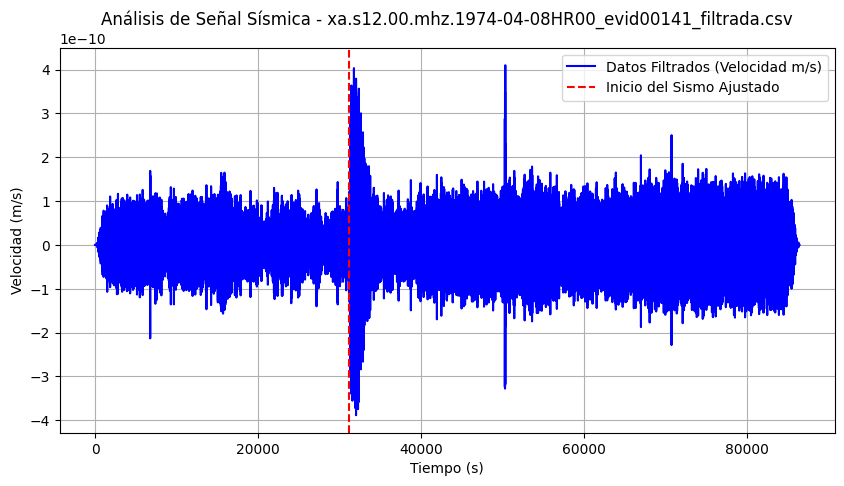

Tiempo ajustado leído: 66840
Rango de tiempo: 0.0 a 86397.7358490566
Línea de inicio del sismo graficada.


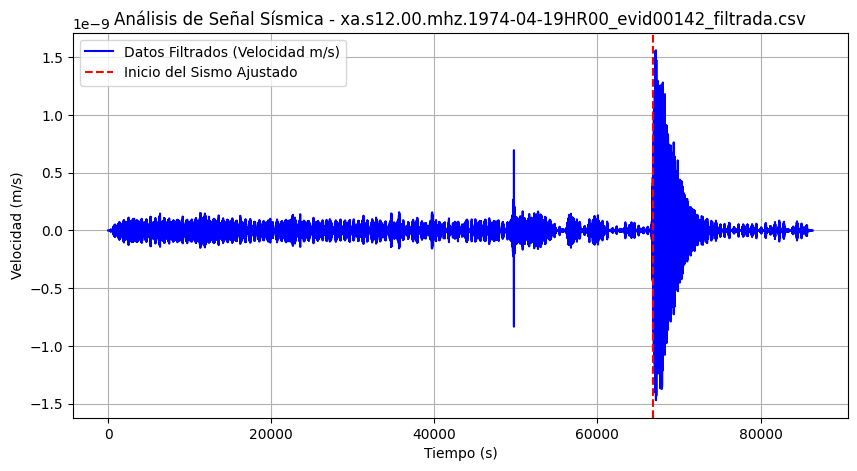

Tiempo ajustado leído: 33480
Rango de tiempo: 0.0 a 86397.7358490566
Línea de inicio del sismo graficada.


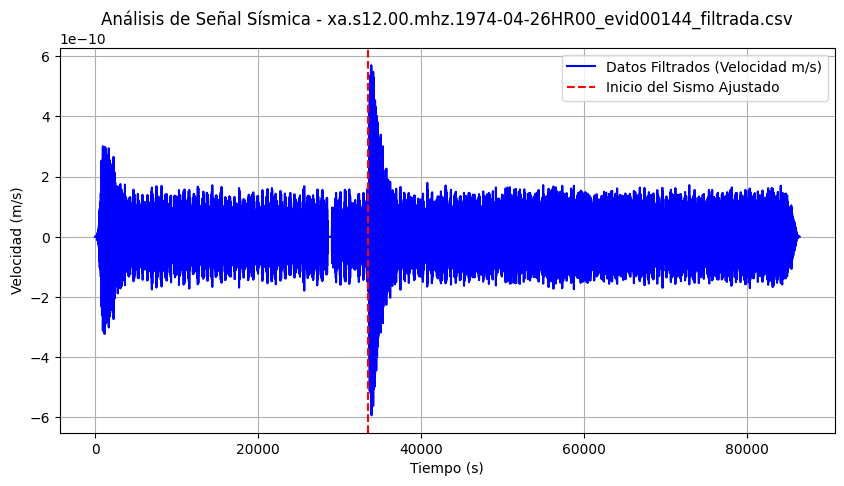

Tiempo ajustado leído: 51480
Rango de tiempo: 0.0 a 86397.28301886792
Línea de inicio del sismo graficada.


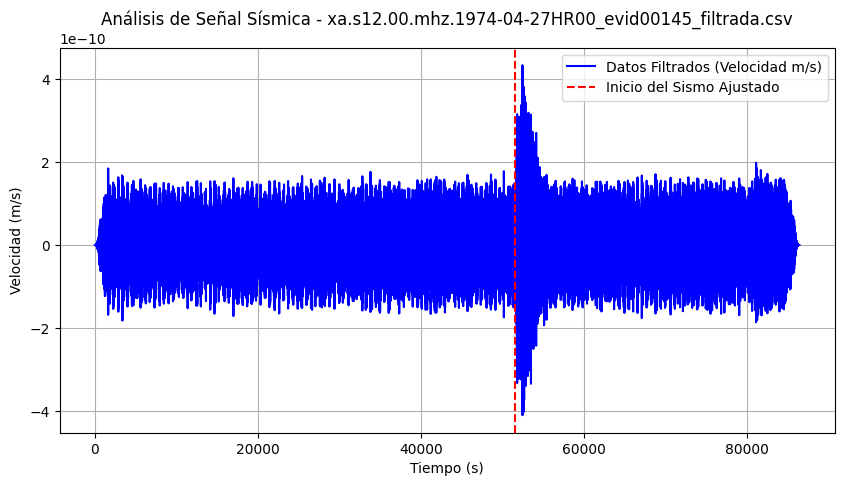

Tiempo ajustado leído: 1380
Rango de tiempo: 0.0 a 86403.32075471699
Línea de inicio del sismo graficada.


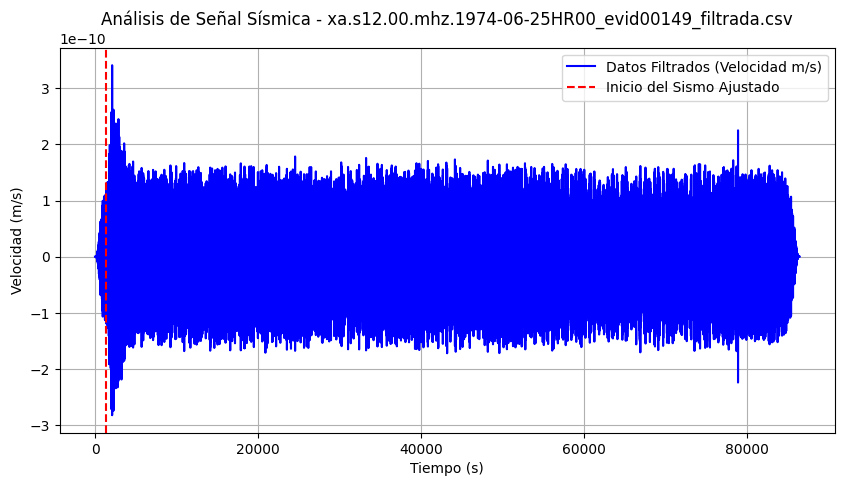

Tiempo ajustado leído: 10620
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


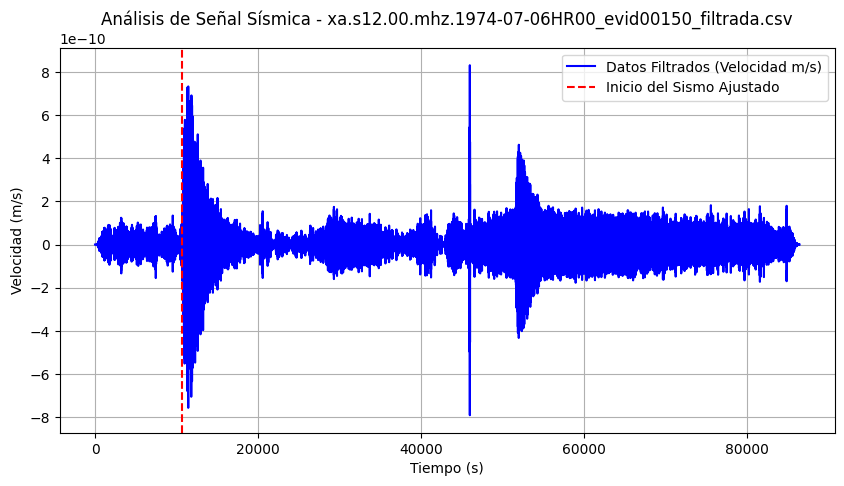

Tiempo ajustado leído: 51240
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


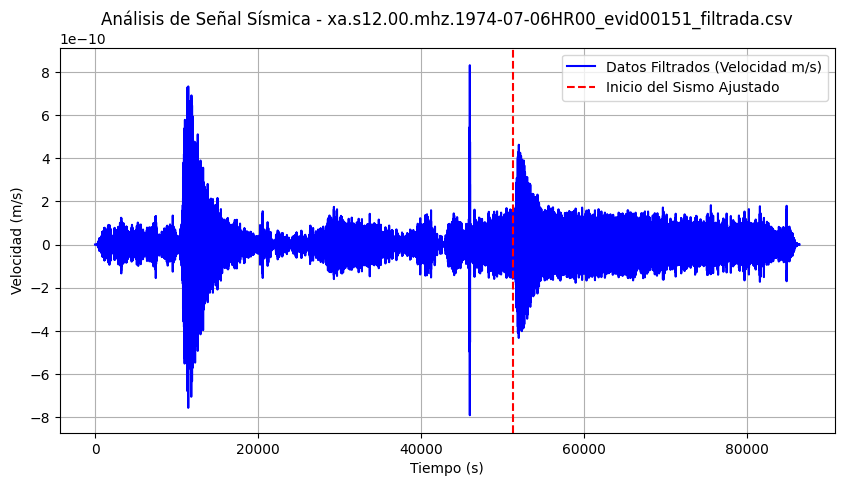

Tiempo ajustado leído: 3120
Rango de tiempo: 0.0 a 86402.11320754717
Línea de inicio del sismo graficada.


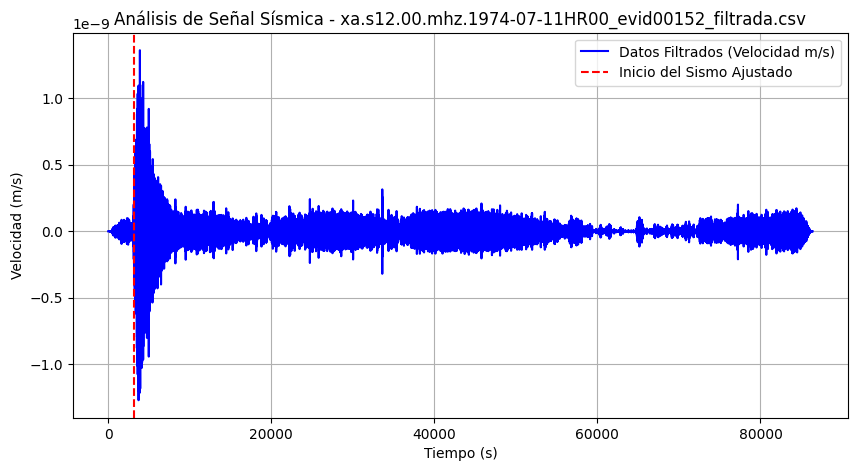

Tiempo ajustado leído: 43500
Rango de tiempo: 0.0 a 86403.32075471699
Línea de inicio del sismo graficada.


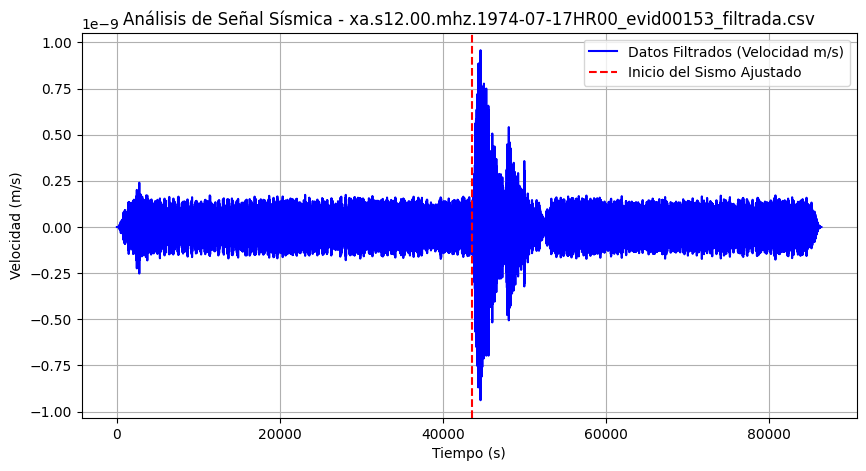

Tiempo ajustado leído: 63780
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


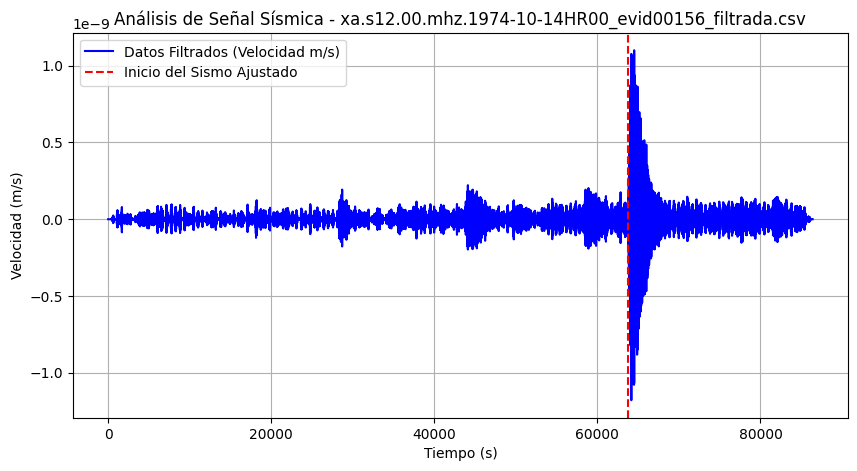

Tiempo ajustado leído: 65700
Rango de tiempo: 0.0 a 86403.32075471699
Línea de inicio del sismo graficada.


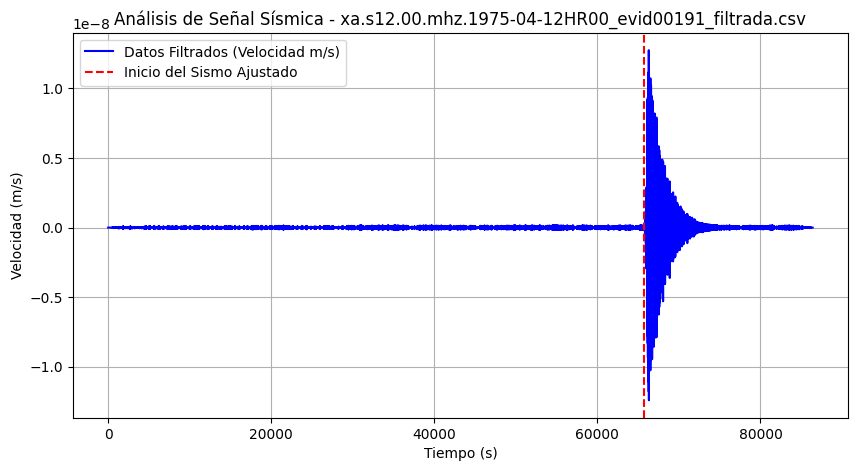

Tiempo ajustado leído: 36300
Rango de tiempo: 0.0 a 86402.56603773584
Línea de inicio del sismo graficada.


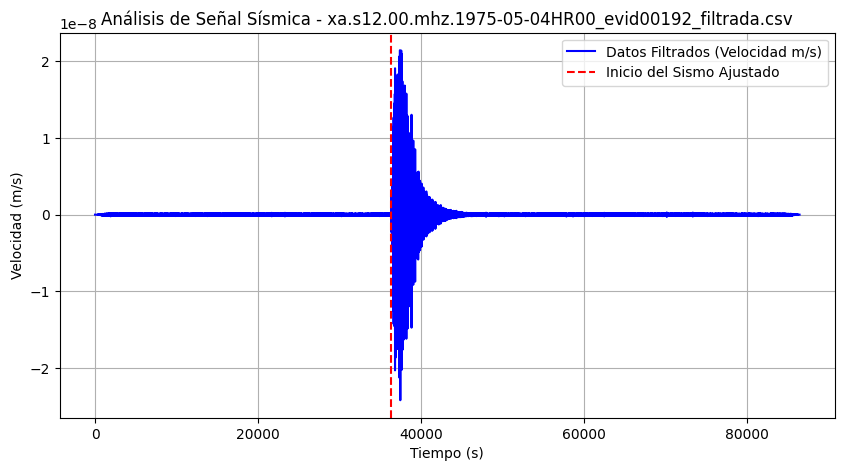

Tiempo ajustado leído: 57780
Rango de tiempo: 0.0 a 86401.50943396226
Línea de inicio del sismo graficada.


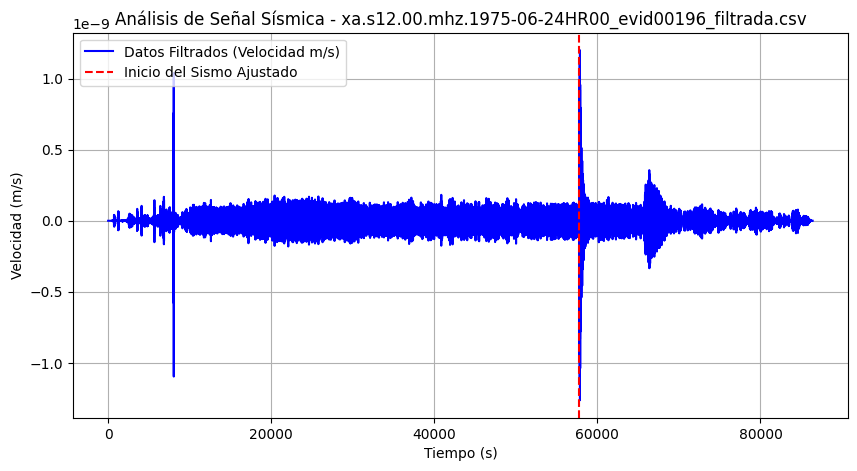

Tiempo ajustado leído: 12240
Rango de tiempo: 0.0 a 86400.90566037736
Línea de inicio del sismo graficada.


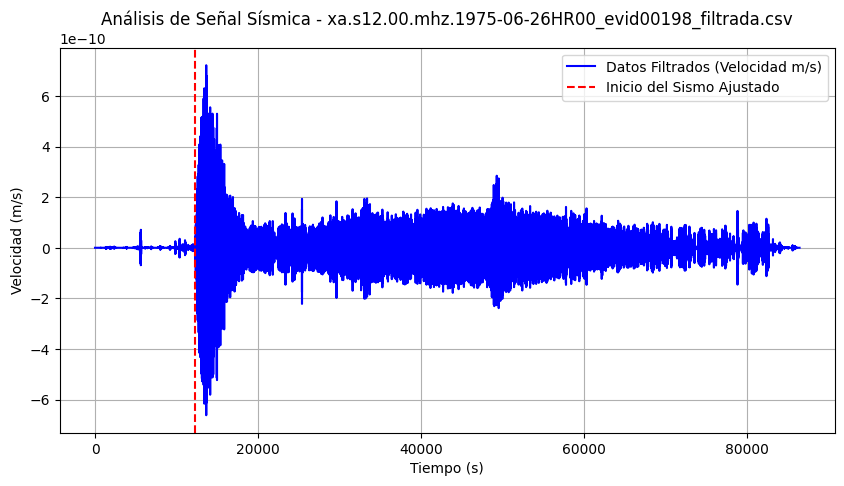

Arreglo de velocidades:
 [array([-4.27718192e-15, -6.41508252e-15, -7.75636770e-15, ...,
        -8.31918857e-15, -6.11276502e-15, -3.65134882e-15])
 array([-3.78985102e-16, -5.67984549e-16, -6.86169947e-16, ...,
        -7.22400389e-16, -5.28045035e-16, -3.14093022e-16])
 array([-1.93193674e-15, -2.89785050e-15, -3.50289003e-15, ...,
        -3.60492430e-15, -2.64252385e-15, -1.57466999e-15])
 array([6.30253276e-16, 9.44904832e-16, 1.14199403e-15, ...,
        1.01767905e-15, 7.37029078e-16, 4.34068445e-16])
 array([-9.84197830e-18, -1.51941688e-17, -1.90190437e-17, ...,
        -4.94551824e-18,  3.26851771e-18,  6.77617342e-18])
 array([-5.96987956e-17, -8.87726254e-17, -1.06414175e-16, ...,
        -1.15004090e-16, -9.01011294e-17, -5.69535298e-17])
 array([-4.46190850e-17, -6.53135915e-17, -7.69846100e-17, ...,
        -7.81784069e-17, -5.59292616e-17, -3.24623764e-17])
 array([-9.97261051e-17, -1.50178257e-16, -1.82485987e-16, ...,
        -1.96352237e-16, -1.44561953e-16, -8.6516

In [32]:
import numpy as np
import matplotlib.pyplot as plt
import os
import re


# Función para extraer el número de evidencia
def extract_evid_number(filename):
    match = re.search(r'evid(\d+)', filename)
    return int(match.group(1)) if match else None

# Crear una lista de archivos filtrados y ajustados
filtered_folder = 'data_filtrada1'
adjusted_arrivals_folder = 'tiempos_inicio_sismos_ajustados'

# Obtener la lista de archivos filtrados
filtered_files = [f for f in os.listdir(filtered_folder) if f.endswith('_filtrada.csv')]
adjusted_arrival_files = [f for f in os.listdir(adjusted_arrivals_folder) if f.endswith('_inicio_ajustado.csv')]

# Ordenar las listas por el número de evidencia
sorted_filtered_files = sorted(filtered_files, key=extract_evid_number)
sorted_adjusted_arrival_files = sorted(adjusted_arrival_files, key=extract_evid_number)

# Verificar el resultado
print("Filtered Files Ordenados:")
for f in sorted_filtered_files:
    print(f)

print("\nAdjusted Arrival Files Ordenados:")
for f in sorted_adjusted_arrival_files:
    print(f)


print(sorted_filtered_files)
print(sorted_adjusted_arrival_files)
# Inicializar listas para almacenar valores de velocidad y tiempos ajustados
velocities = []
adjusted_times = []

# Graficar los datos
for filtered_file, arrival_file in zip(sorted_filtered_files, sorted_adjusted_arrival_files):
    # Cargar datos filtrados
    filtered_data = np.loadtxt(os.path.join(filtered_folder, filtered_file), delimiter=',', skiprows=1)
    time_abs = filtered_data[:, 0]
    velocity = filtered_data[:, 2]

    # Cargar tiempos ajustados
    adjusted_arrival_path = os.path.join(adjusted_arrivals_folder, arrival_file)
    
    if os.path.exists(adjusted_arrival_path):
        adjusted_arrival = np.loadtxt(adjusted_arrival_path, delimiter=',', skiprows=1)
        
        # Verificar que hay datos en adjusted_arrival
        if adjusted_arrival.size == 0:
            print(f"Advertencia: El archivo {arrival_file} está vacío.")
            continue
        
        # Asegurarse de que el tiempo ajustado esté en formato adecuado
        if np.ndim(adjusted_arrival) == 0:  # Si es un escalar
            adjusted_time = int(adjusted_arrival)  # Asignar directamente como entero
        else:
            adjusted_time = int(adjusted_arrival[0])  # Para arreglos
        
        print(f"Tiempo ajustado leído: {adjusted_time}")
    else:
        print(f"Advertencia: El archivo {arrival_file} no se encontró.")
        continue

    # Graficar
    plt.figure(figsize=(10, 5))
    
    # Graficar la señal filtrada
    plt.plot(time_abs, velocity, label='Datos Filtrados (Velocidad m/s)', color='blue')

    # Agregar la línea de llegada del sismo ajustada
    # Verificar si el tiempo ajustado está dentro del rango de tiempo
    print(f"Rango de tiempo: {time_abs[0]} a {time_abs[-1]}")
    if adjusted_time >= time_abs[0] and adjusted_time <= time_abs[-1]:
        plt.axvline(x=adjusted_time, color='red', linestyle='--', label='Inicio del Sismo Ajustado')
        print("Línea de inicio del sismo graficada.")
    else:
        print(f"Advertencia: El tiempo ajustado {adjusted_time} está fuera del rango de la señal filtrada.")
    
    # Títulos y etiquetas
    plt.title(f'Análisis de Señal Sísmica - {filtered_file.strip()}')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Velocidad (m/s)')
    plt.legend()
    plt.grid()
    
    # Mostrar la gráfica
    plt.show()

    # Almacenar los datos de velocidad y tiempo ajustado en listas
    velocities.append(velocity)
    adjusted_times.append(adjusted_time)

# Convertir listas a arreglos de NumPy
x = np.array(velocities, dtype=object)  # Arreglo de velocidades
y = np.array(adjusted_times)  # Arreglo de tiempos ajustados

# Imprimir los arreglos resultantes
print("Arreglo de velocidades:\n", x)
print("Arreglo de tiempos ajustados:\n", y)
print("Gráficas generadas y datos almacenados.")


In [51]:
import numpy as np

def z_score_normalization(data):
    """Normaliza los datos utilizando la técnica Z-score."""
    mean = np.mean(data)
    std_dev = np.std(data)
    normalized_data = (data - mean) / std_dev
    return normalized_data

# Supongamos que tus datos de velocidad están en x (velocidades de datos sísmicos)
# y los tiempos ajustados en y (tiempos ajustados)

# Convertir listas a arreglos de NumPy
x = np.array(velocities, dtype=object)  # Velocidades de datos sísmicos
y = np.array(adjusted_times)  # Tiempos ajustados

# Normalizar datos de velocidad (x)
normalized_x = []
for velocity in x:
    normalized_velocity = z_score_normalization(velocity)
    normalized_x.append(normalized_velocity)

# Normalizar tiempos ajustados (y)
n_y = z_score_normalization(y)

# Convertir la lista de velocidades normalizadas a un arreglo NumPy
n_x = np.array(normalized_x, dtype=object)

# Imprimir resultados
print("Arreglo de velocidades normalizadas (Z-score): x ")
for i, nv in enumerate(n_x):
    print(f"Archivo {i+1}: {nv}")

print("\nArreglo de tiempos ajustados normalizados (Z-score): y")
print(n_y)

Arreglo de velocidades normalizadas (Z-score): x 
Archivo 1: [-6.47459582e-05 -9.71090915e-05 -1.17413212e-04 ... -1.25933087e-04
 -9.25326665e-05 -5.52722155e-05]
Archivo 2: [-7.22090342e-06 -1.08220265e-05 -1.30738859e-05 ... -1.37642069e-05
 -1.00610343e-05 -5.98447456e-06]
Archivo 3: [-3.53746269e-05 -5.30612640e-05 -6.41400115e-05 ... -6.60083390e-05
 -4.83860332e-05 -2.88327932e-05]
Archivo 4: [1.00028439e-05 1.49968109e-05 1.81248963e-05 ... 1.61518410e-05
 1.16975275e-05 6.88911201e-06]
Archivo 5: [-1.81941400e-07 -2.80884515e-07 -3.51592955e-07 ... -9.14231325e-08
  6.04254055e-08  1.25269581e-07]
Archivo 6: [-6.17115747e-07 -9.17661734e-07 -1.10002838e-06 ... -1.18882524e-06
 -9.31394928e-07 -5.88737009e-07]
Archivo 7: [-1.52000467e-07 -2.22500104e-07 -2.62259572e-07 ... -2.66326461e-07
 -1.90530661e-07 -1.10586407e-07]
Archivo 8: [-6.53844195e-07 -9.84634910e-07 -1.19646130e-06 ... -1.28737569e-06
 -9.47811481e-07 -5.67232623e-07]
Archivo 9: [-6.53844195e-07 -9.84634910e-07 

Tiempo ajustado leído: 73500


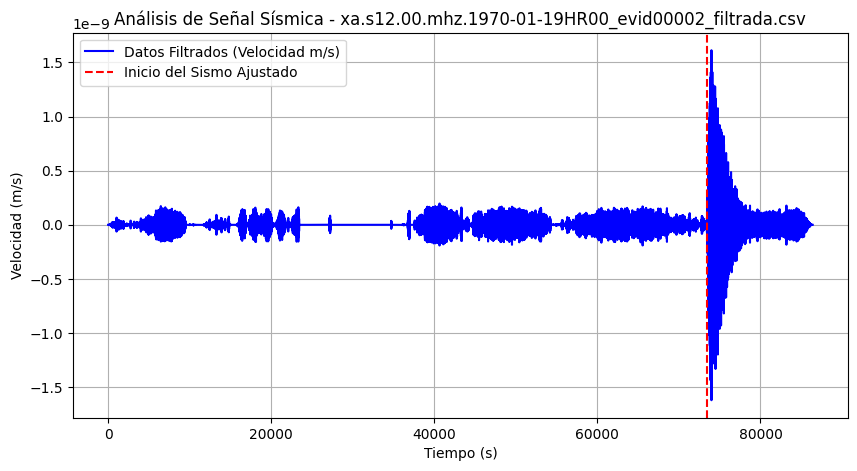

Tiempo ajustado leído: 12720


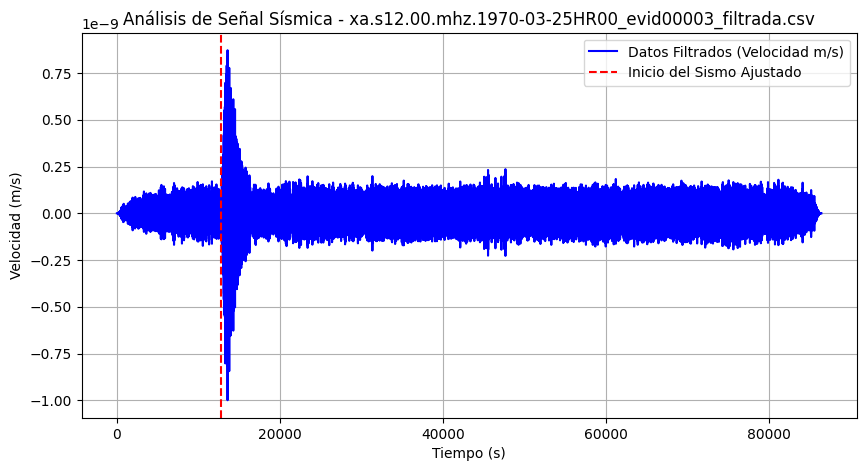

Tiempo ajustado leído: 73020


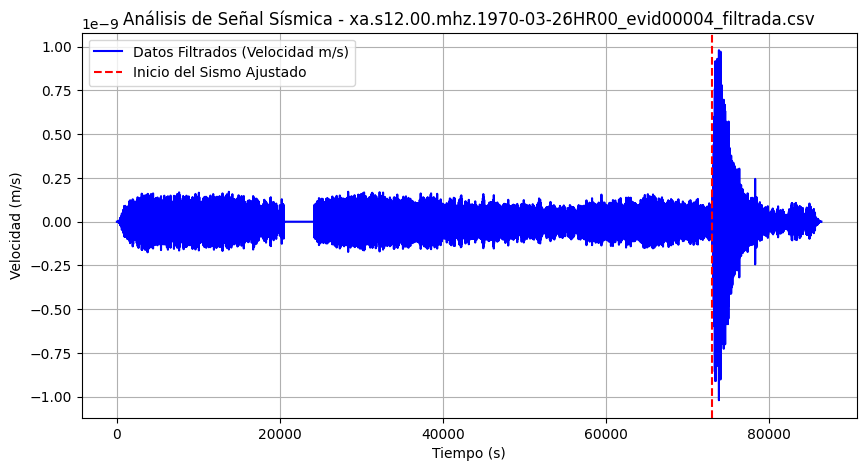

Tiempo ajustado leído: 4440


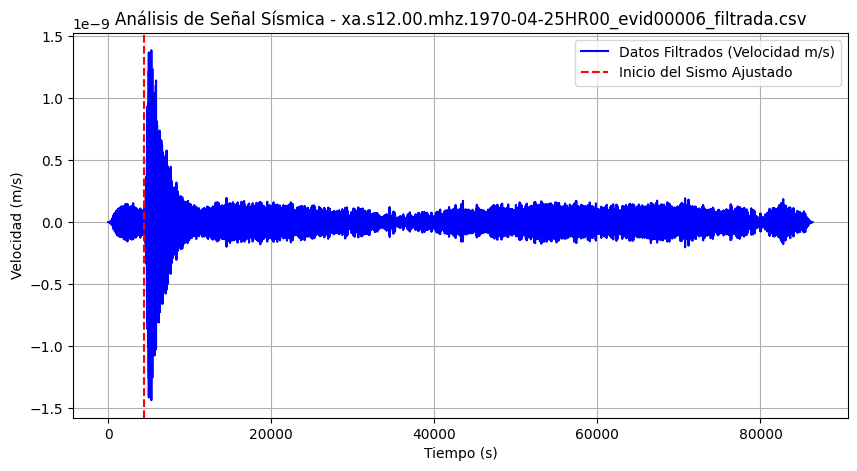

Tiempo ajustado leído: 52140


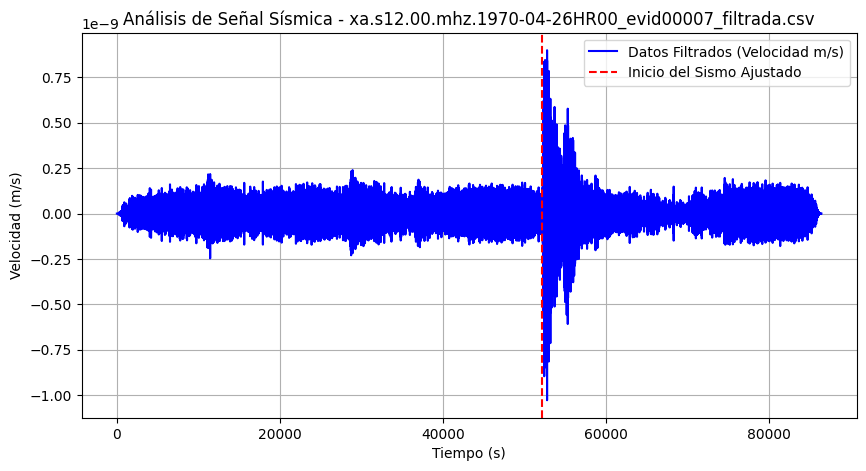

Tiempo ajustado leído: 68400


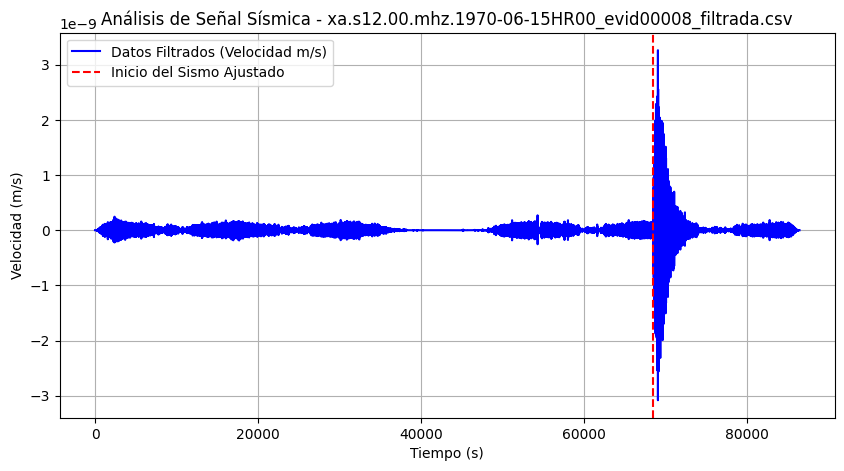

Tiempo ajustado leído: 72060


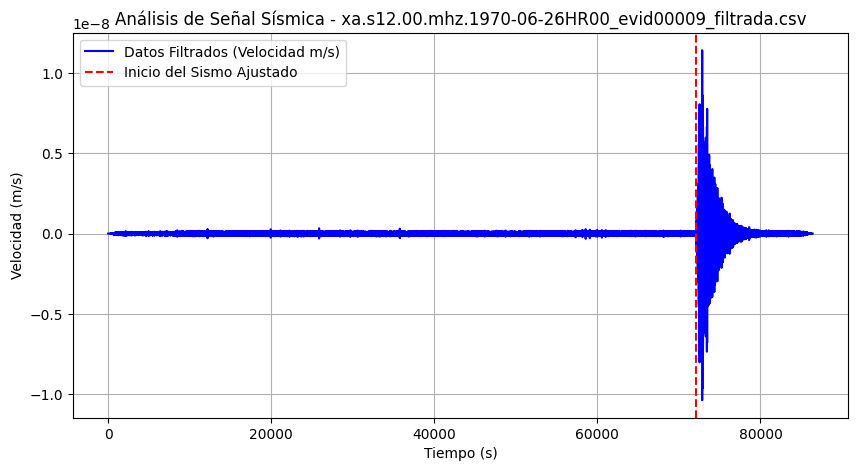

Tiempo ajustado leído: 18360


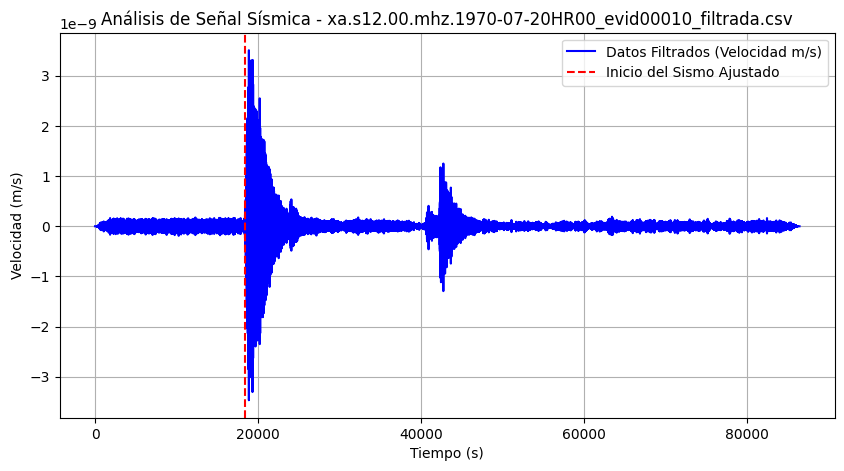

Tiempo ajustado leído: 42240


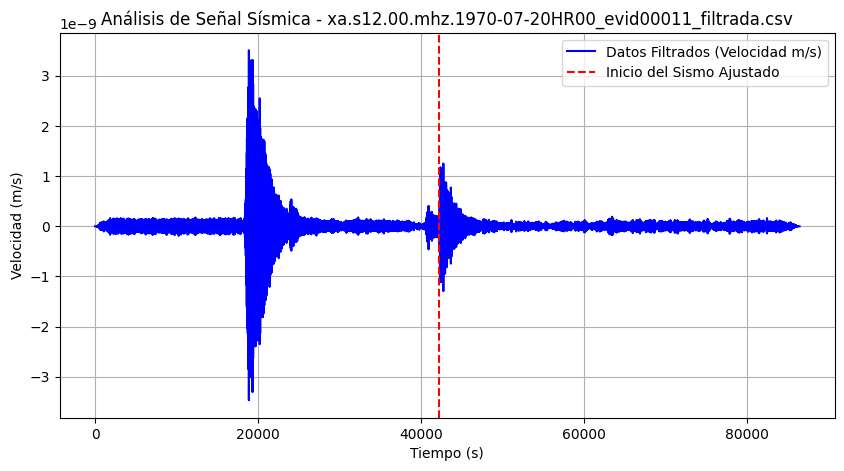

Tiempo ajustado leído: 71820


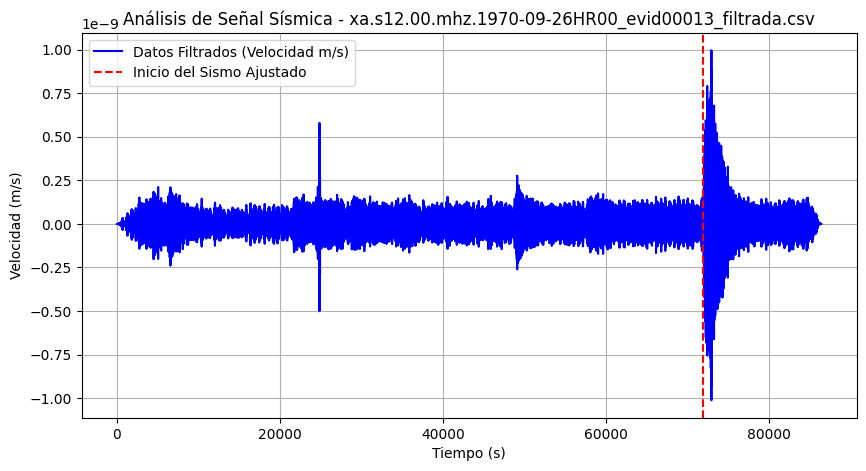

Tiempo ajustado leído: 41460


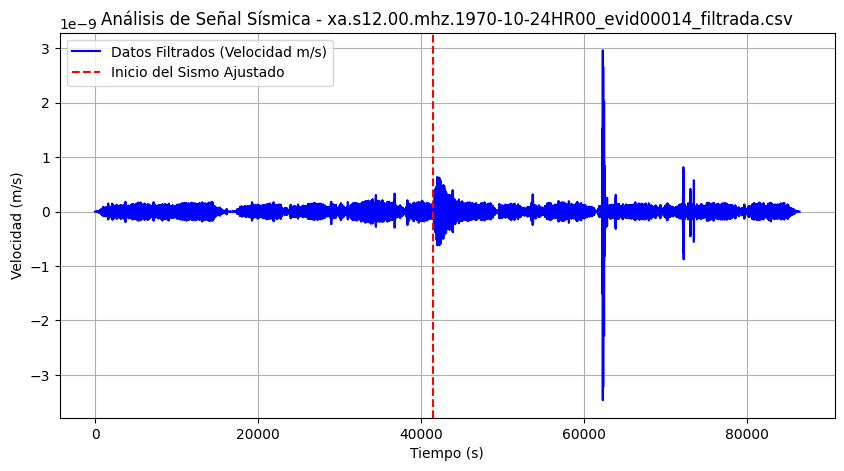

Tiempo ajustado leído: 46200


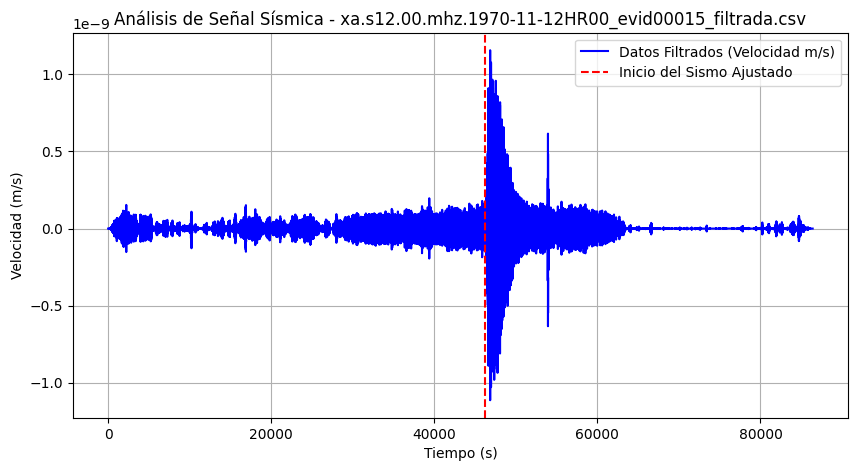

Tiempo ajustado leído: 26520


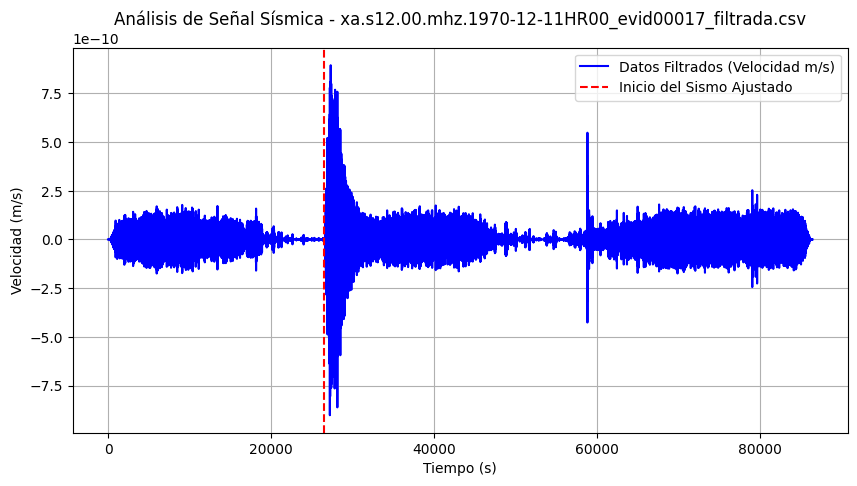

Tiempo ajustado leído: 74040


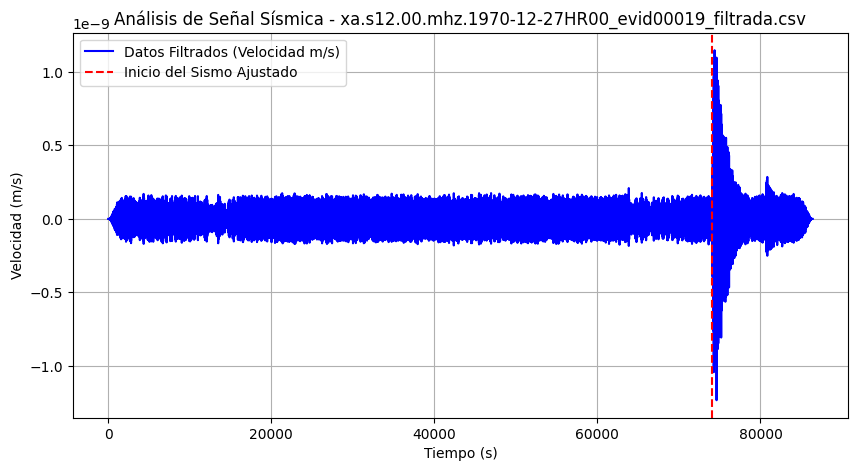

Tiempo ajustado leído: 56460


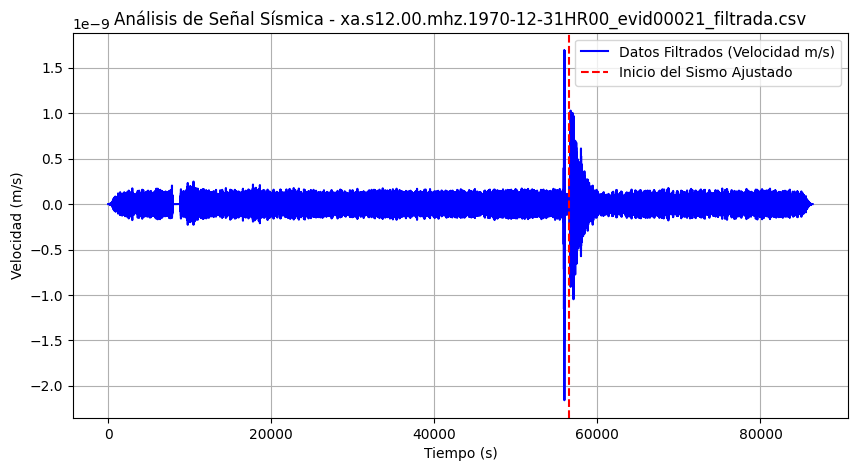

Tiempo ajustado leído: 45600


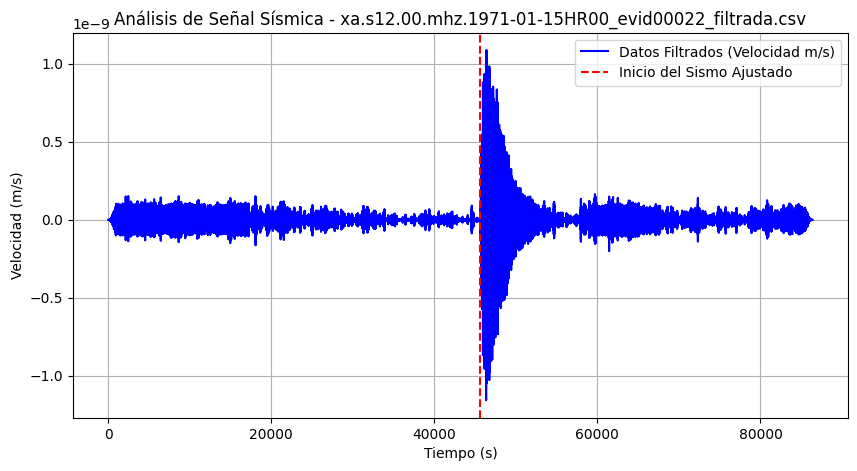

Tiempo ajustado leído: 53940


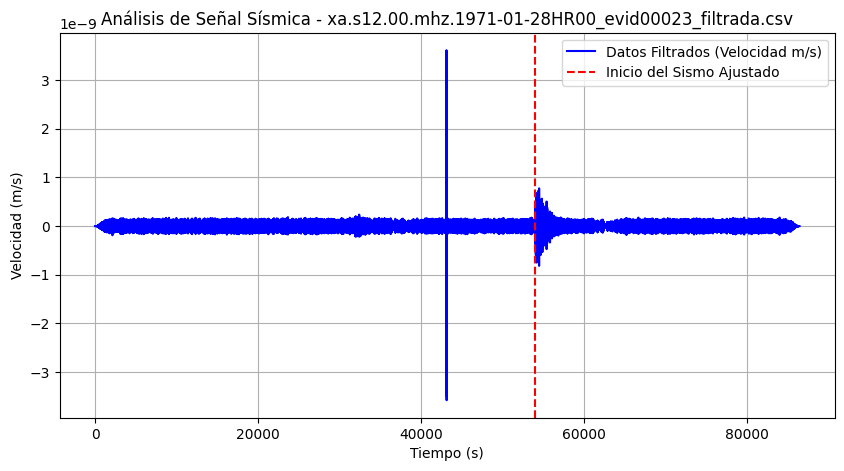

Tiempo ajustado leído: 66060


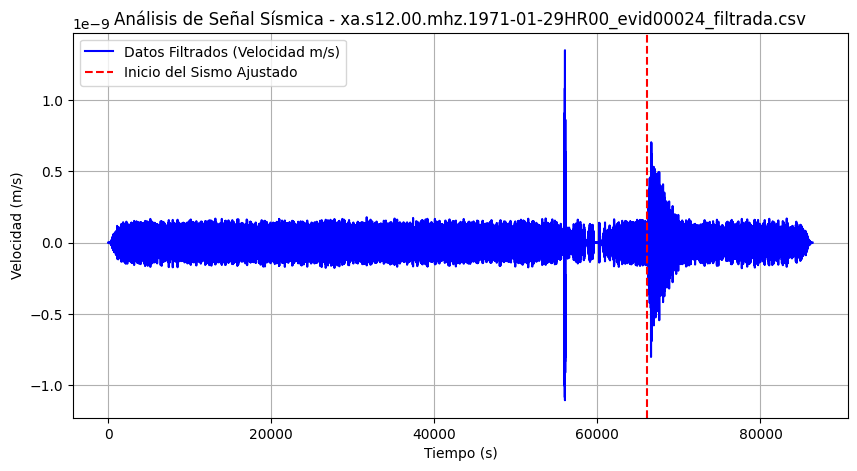

Tiempo ajustado leído: 13320


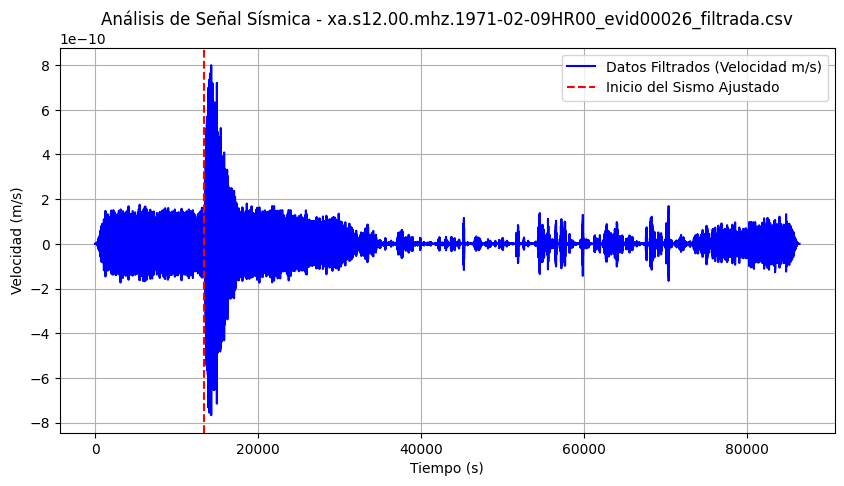

Tiempo ajustado leído: 55080


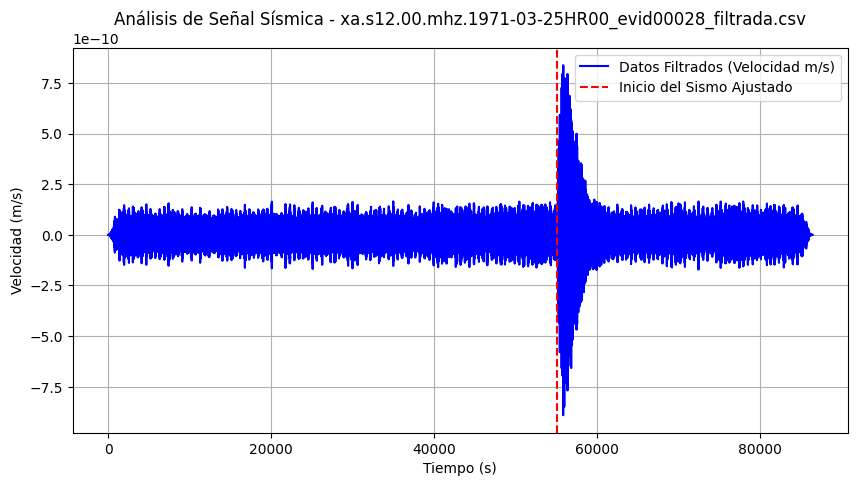

Tiempo ajustado leído: 46500


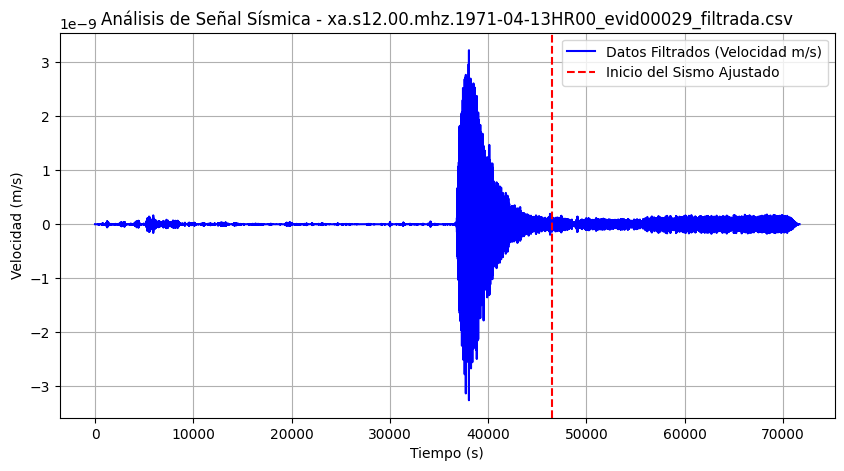

Tiempo ajustado leído: 25440


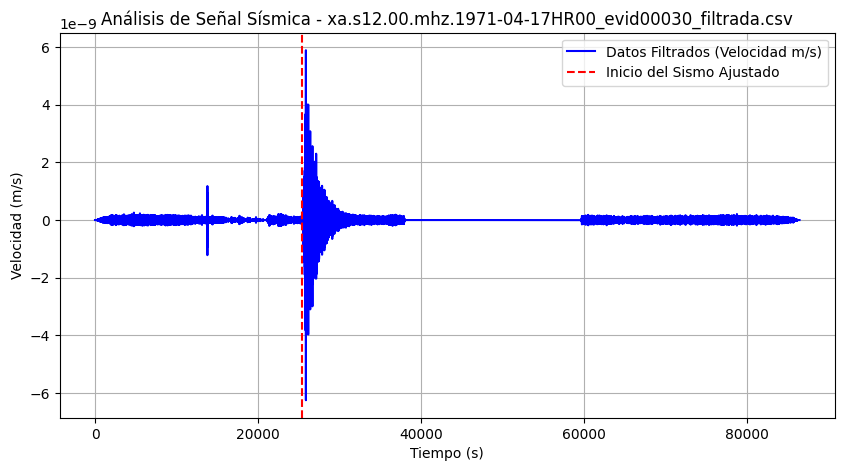

Tiempo ajustado leído: 29100


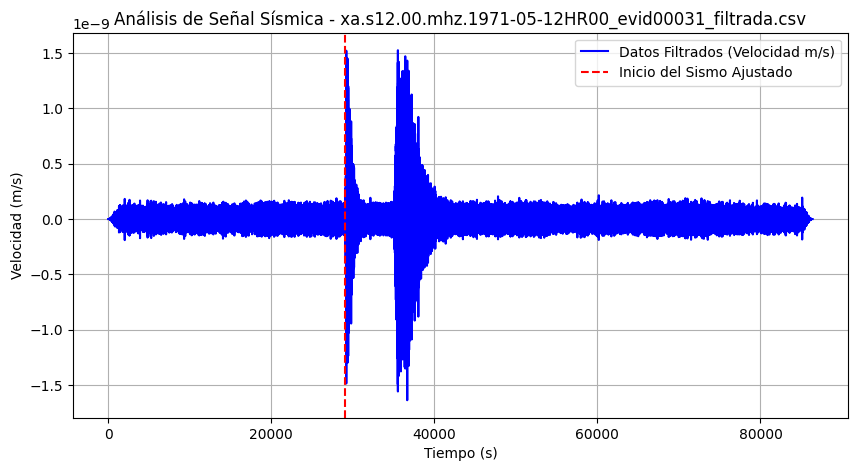

Tiempo ajustado leído: 35100


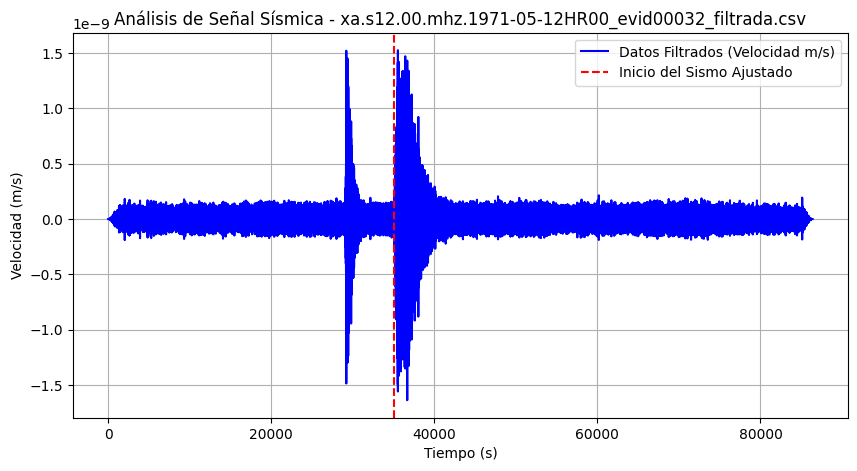

Tiempo ajustado leído: 10800


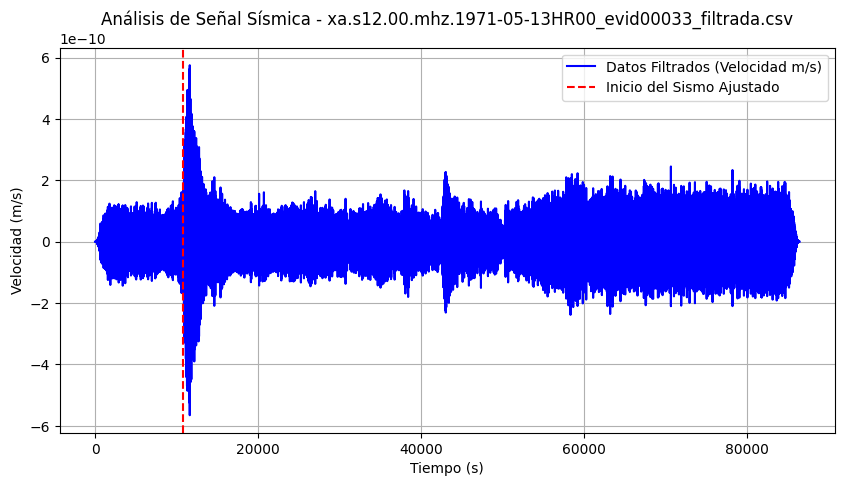

Tiempo ajustado leído: 80400


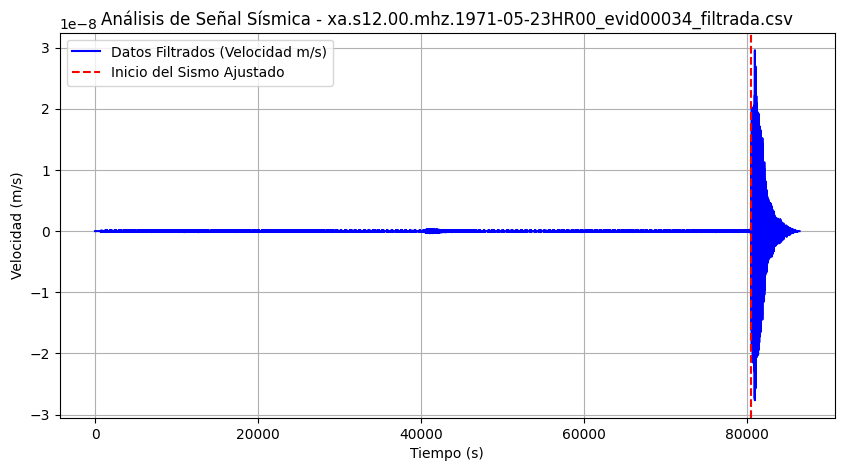

Tiempo ajustado leído: 39060


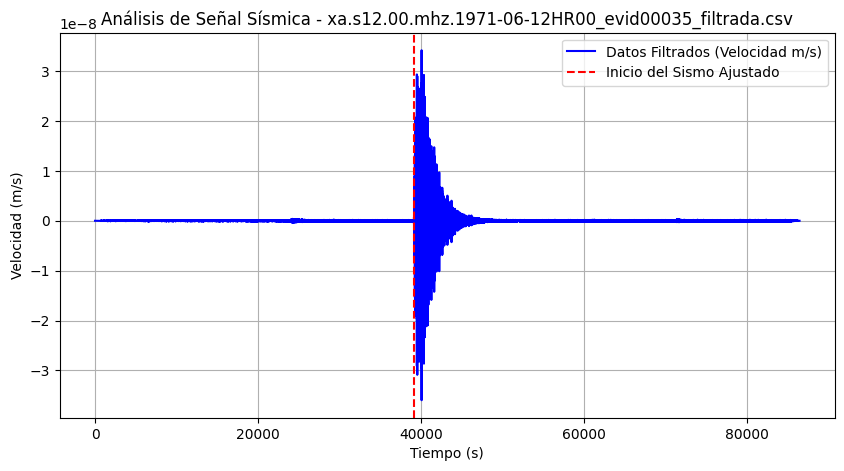

Tiempo ajustado leído: 32220


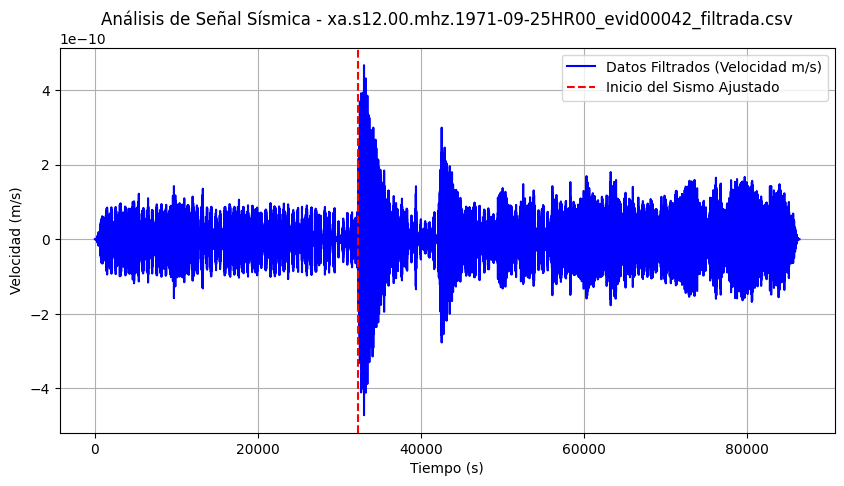

Tiempo ajustado leído: 11940


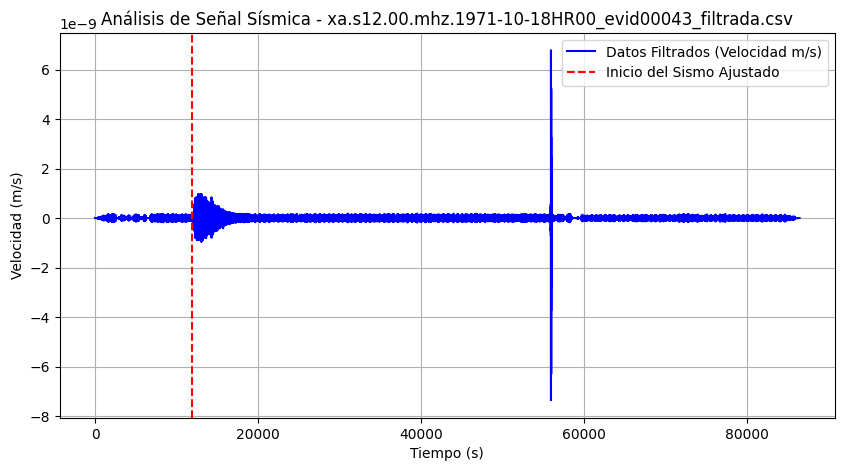

Tiempo ajustado leído: 65280


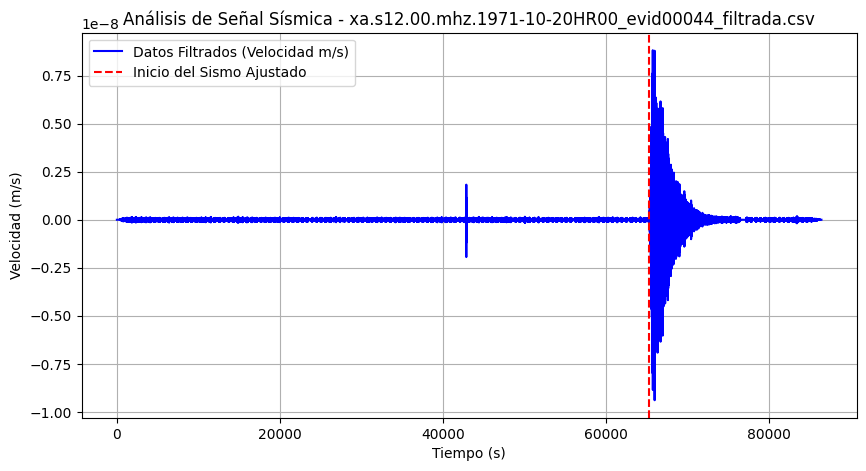

Tiempo ajustado leído: 19800


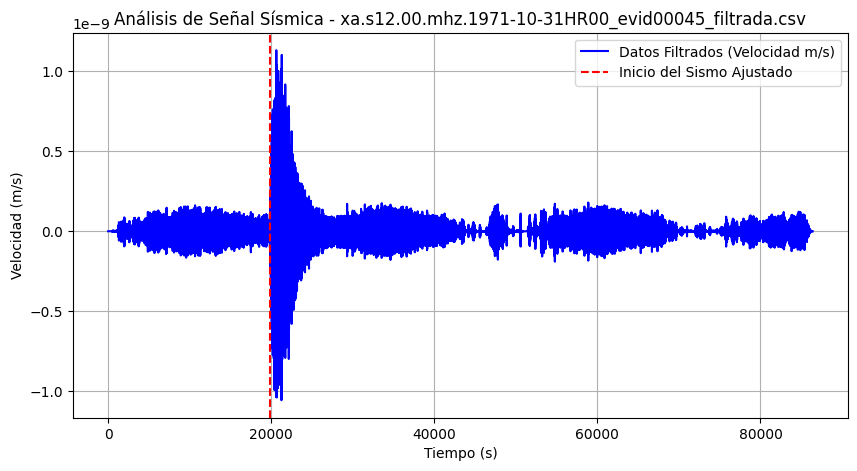

Tiempo ajustado leído: 15420


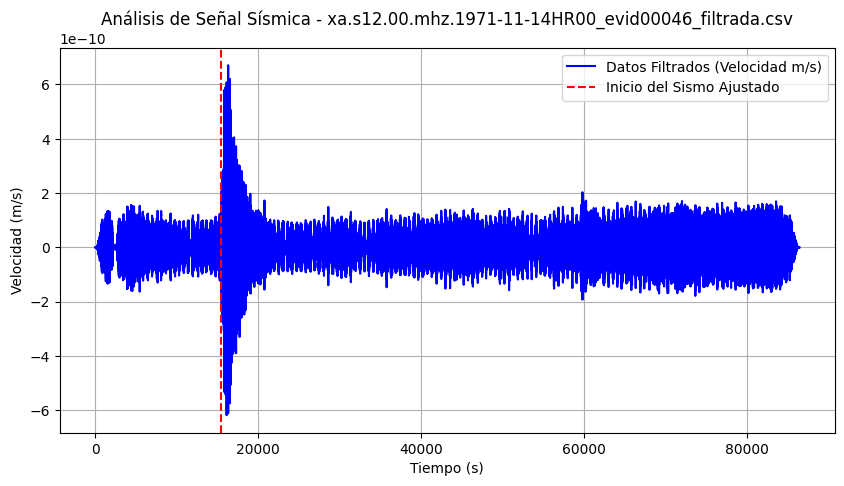

Tiempo ajustado leído: 23700


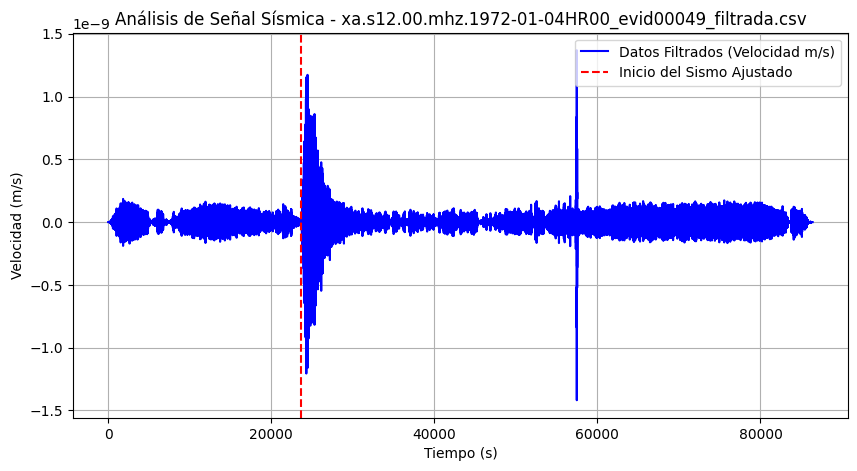

Tiempo ajustado leído: 64800


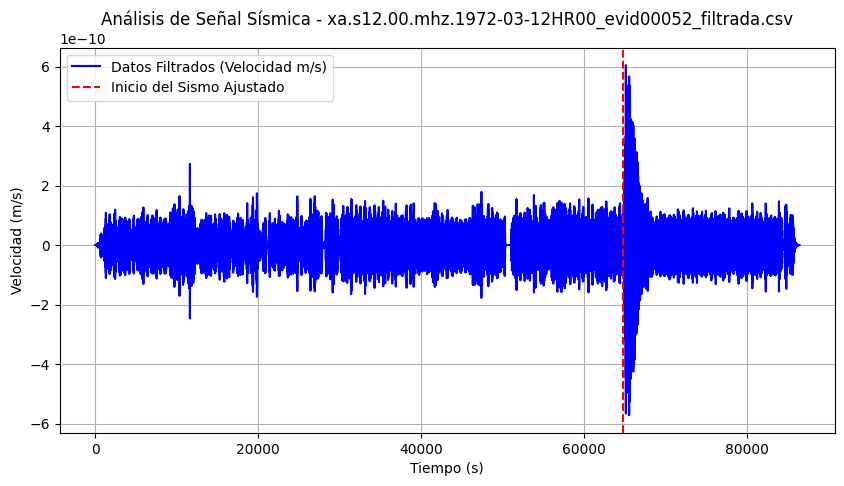

Tiempo ajustado leído: 48900


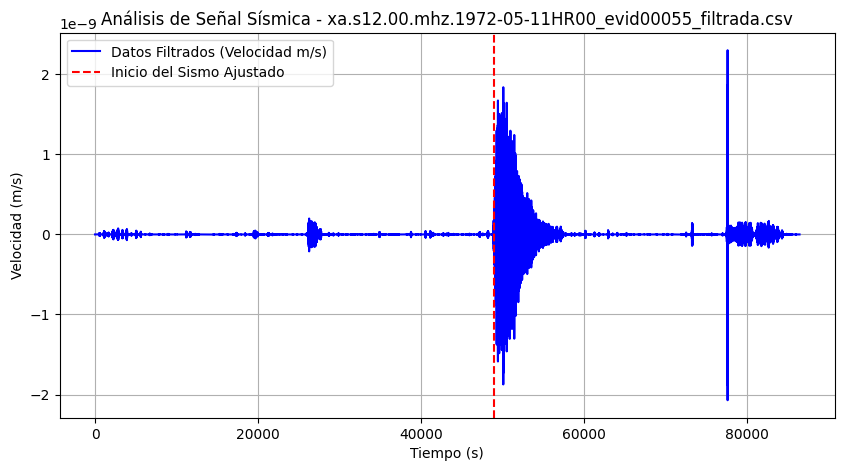

Tiempo ajustado leído: 58260


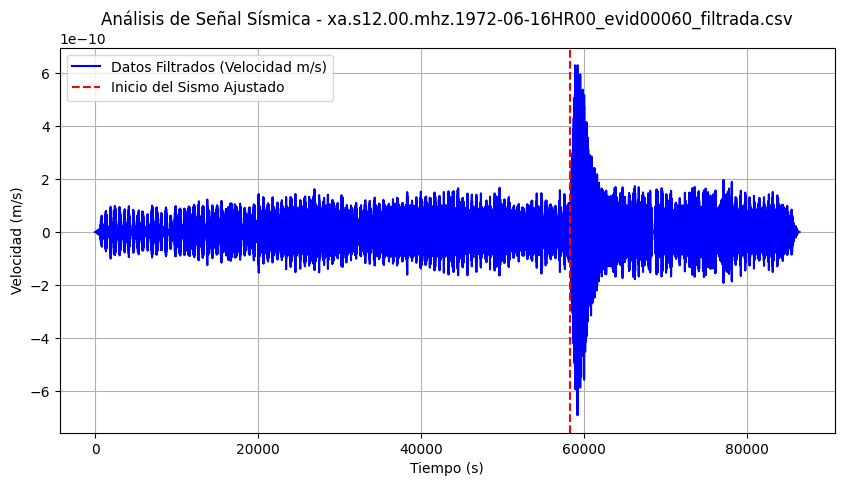

Tiempo ajustado leído: 28200


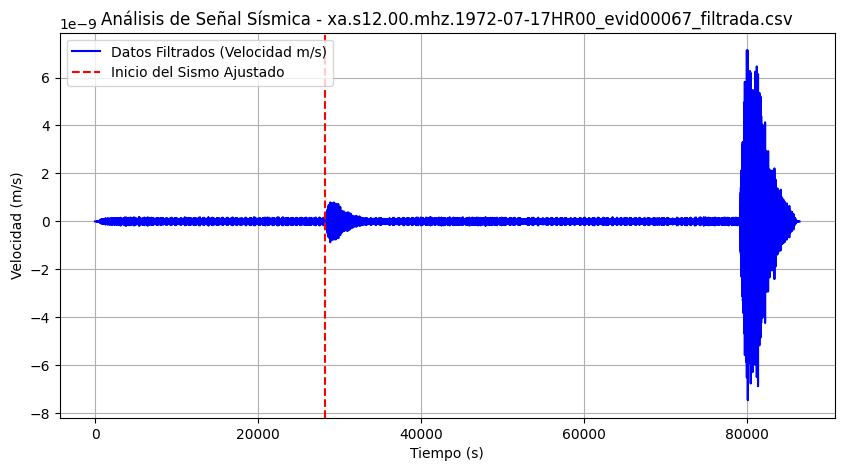

Tiempo ajustado leído: 78960


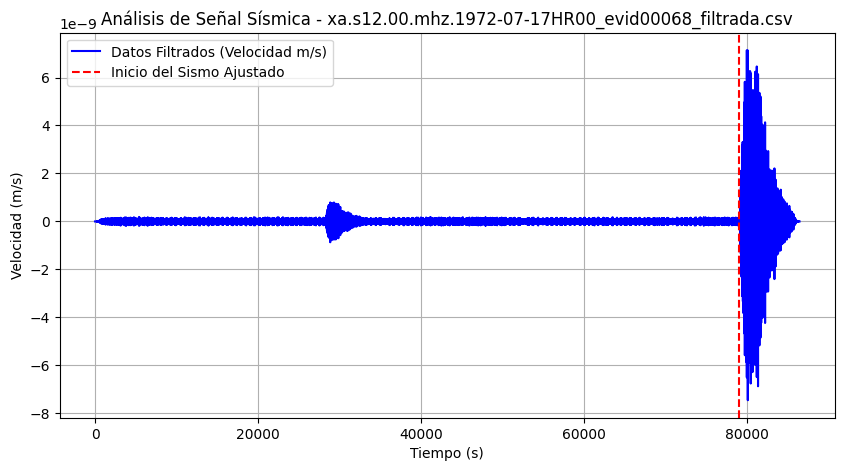

Tiempo ajustado leído: 8580


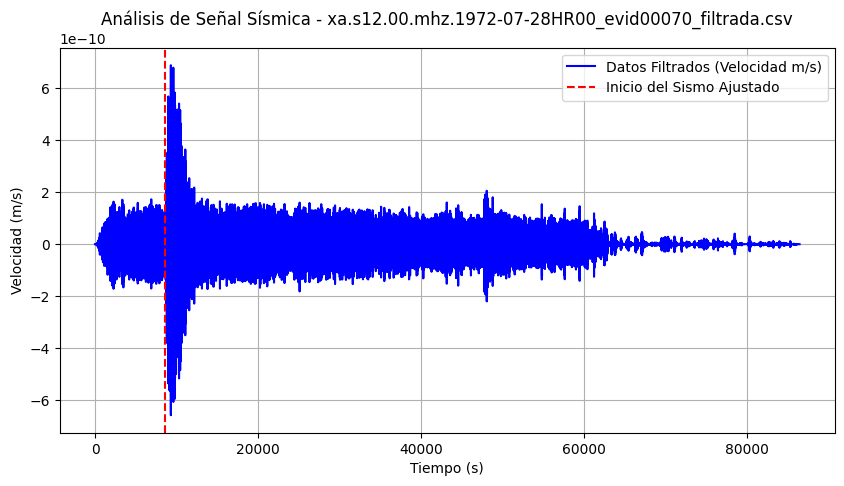

Tiempo ajustado leído: 65280


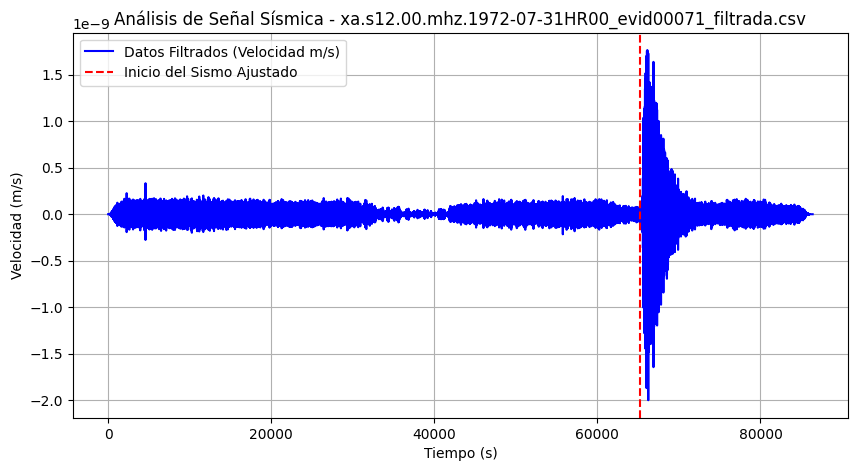

Tiempo ajustado leído: 28680


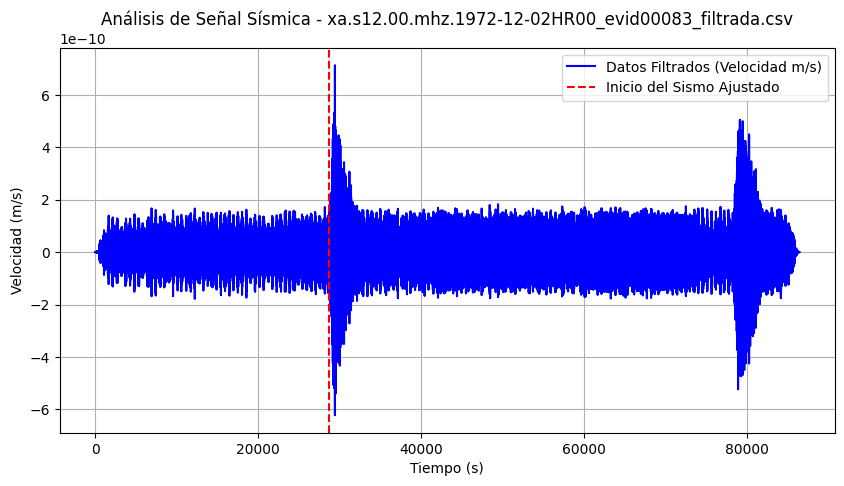

Tiempo ajustado leído: 9480


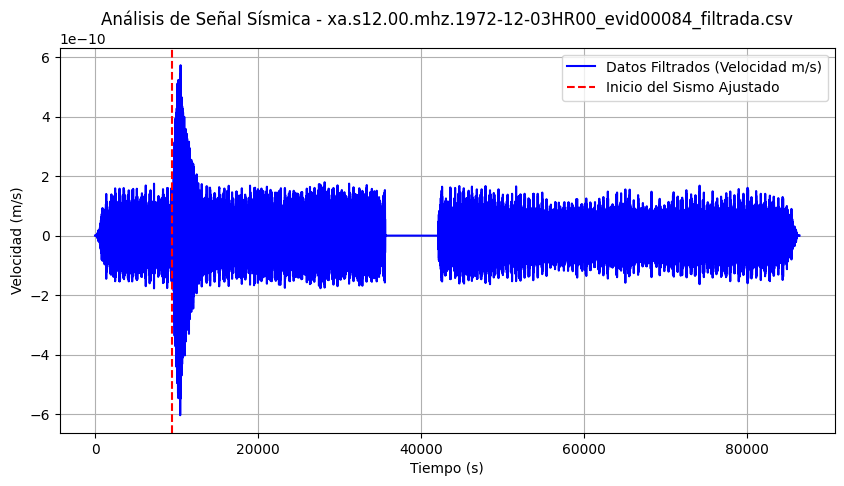

Tiempo ajustado leído: 82860


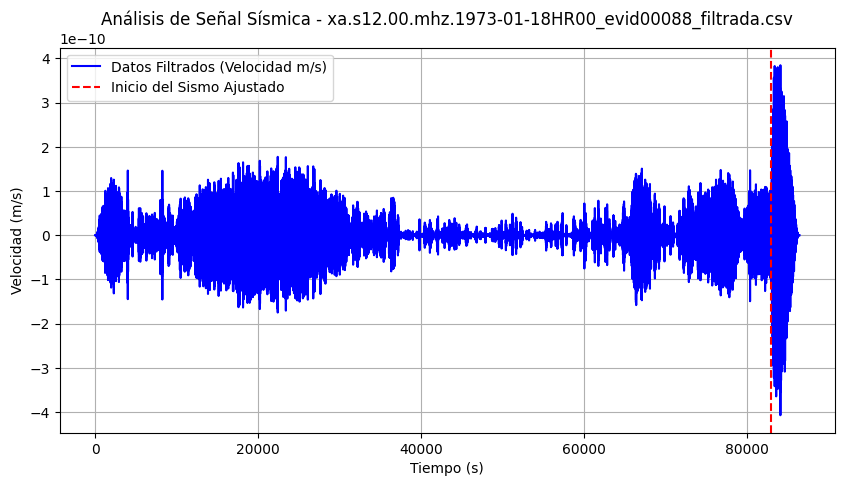

Tiempo ajustado leído: 2640


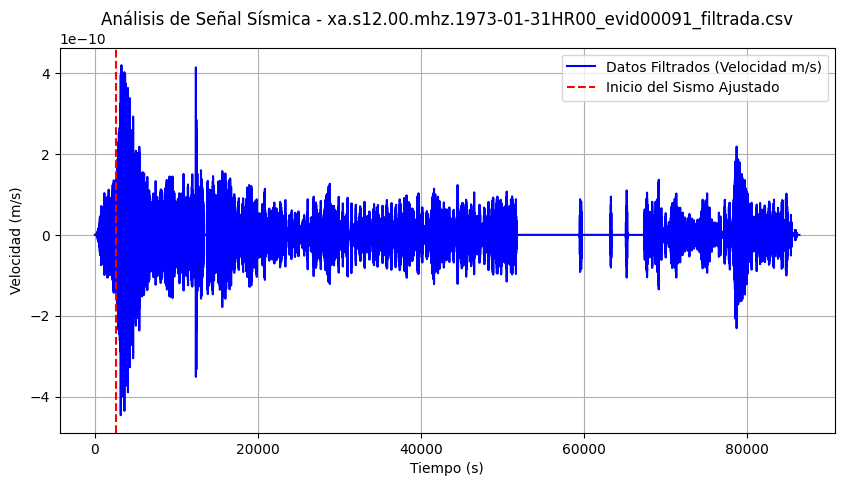

Tiempo ajustado leído: 26100


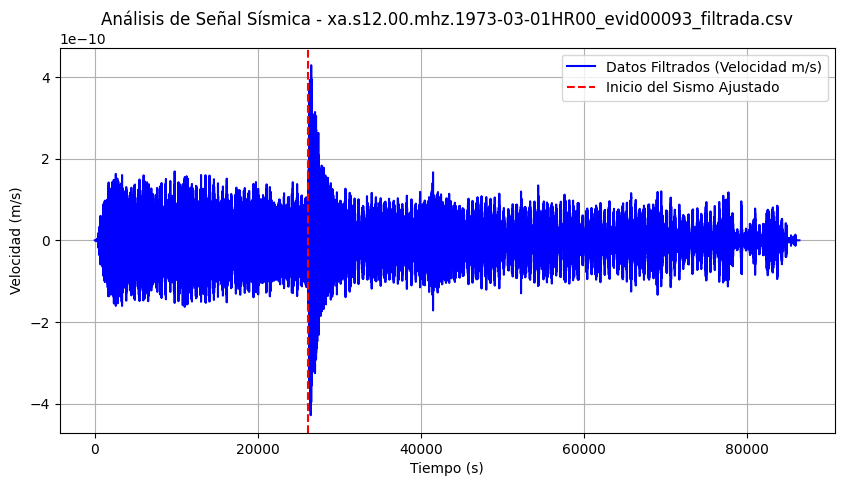

Tiempo ajustado leído: 28860


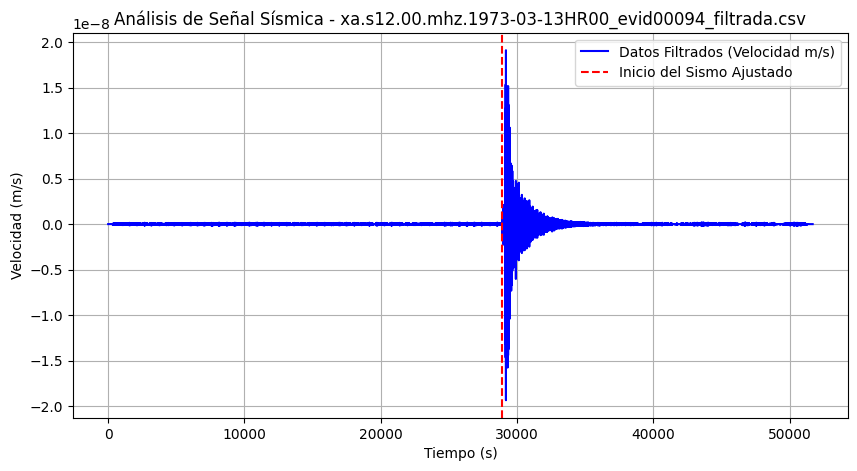

Tiempo ajustado leído: 69780


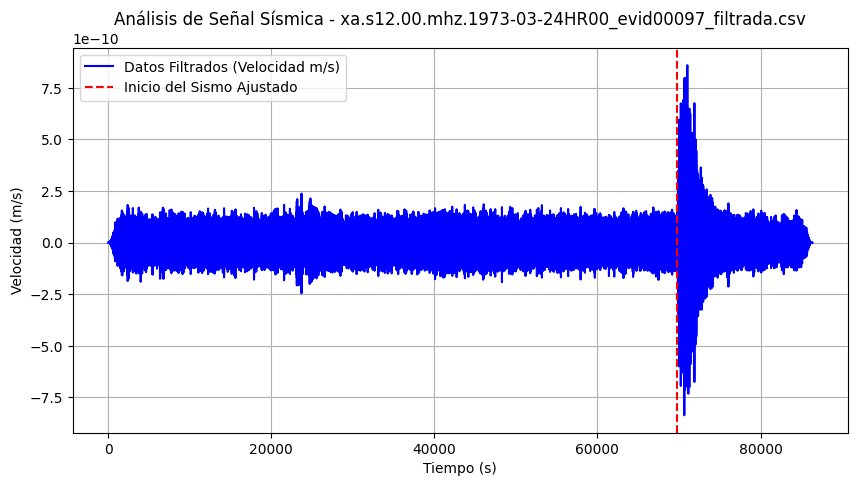

Tiempo ajustado leído: 2640


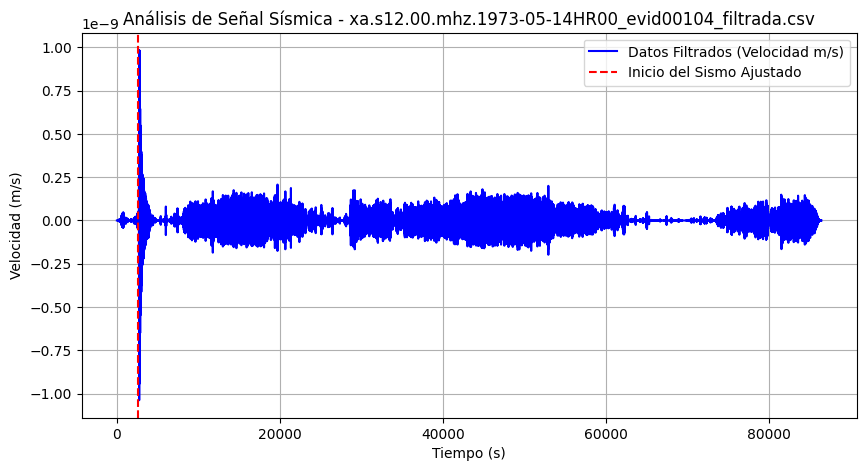

Tiempo ajustado leído: 9480


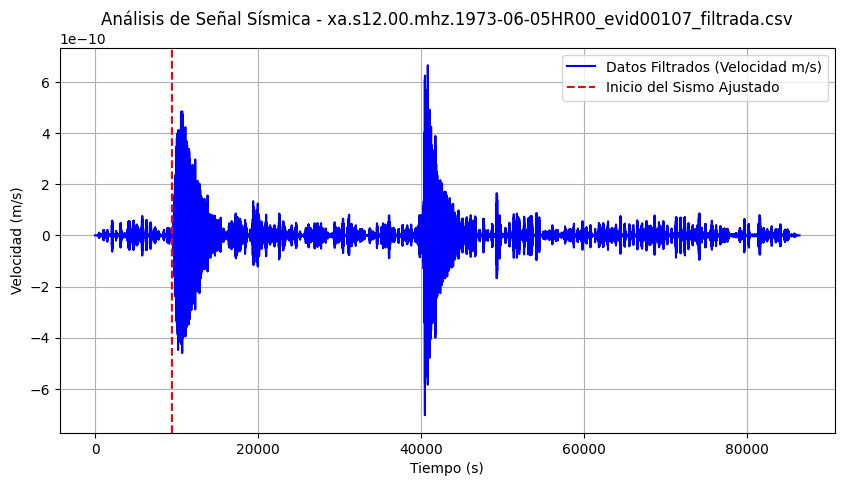

Tiempo ajustado leído: 40200


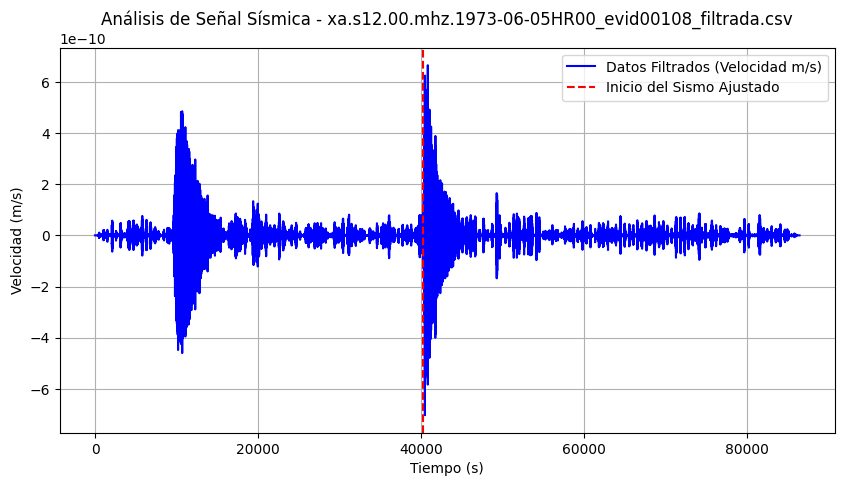

Tiempo ajustado leído: 6120


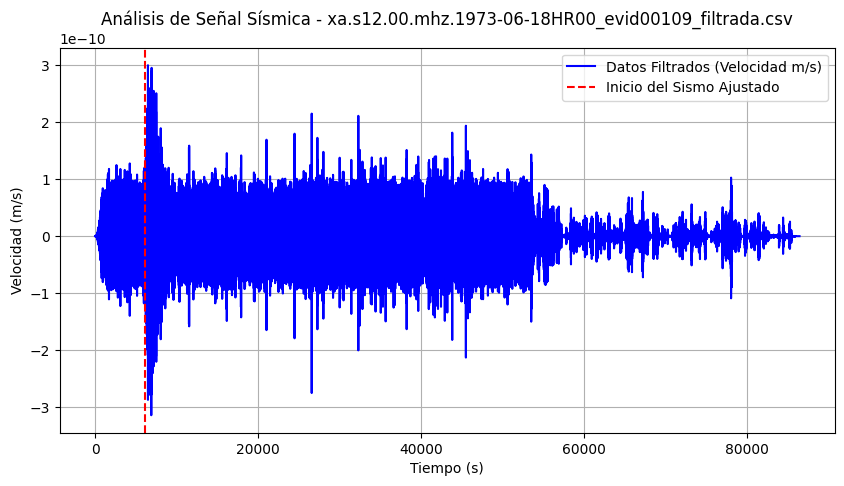

Tiempo ajustado leído: 66960


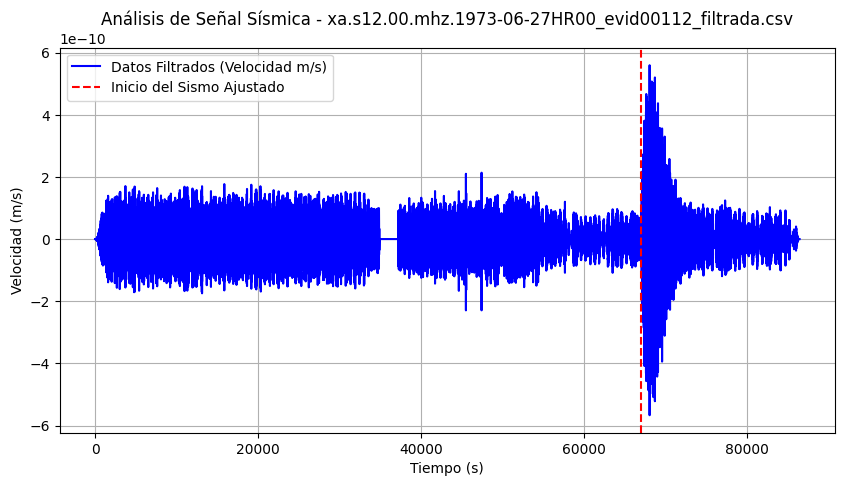

Tiempo ajustado leído: 65700


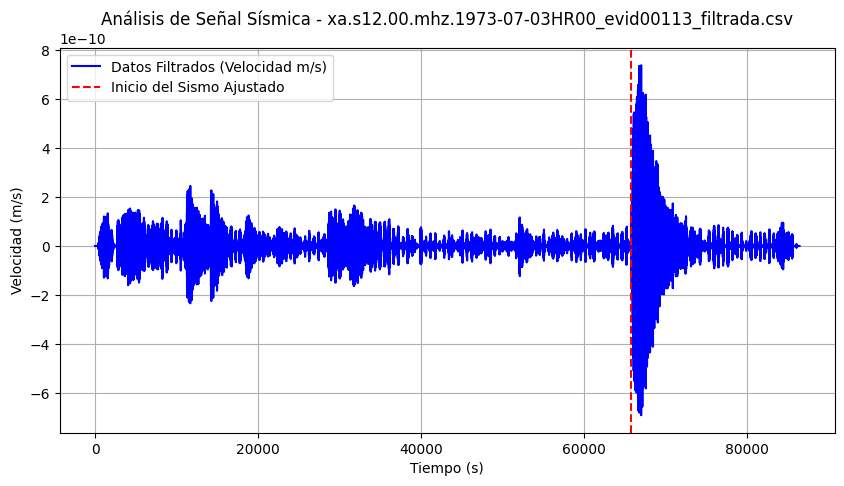

Tiempo ajustado leído: 9960


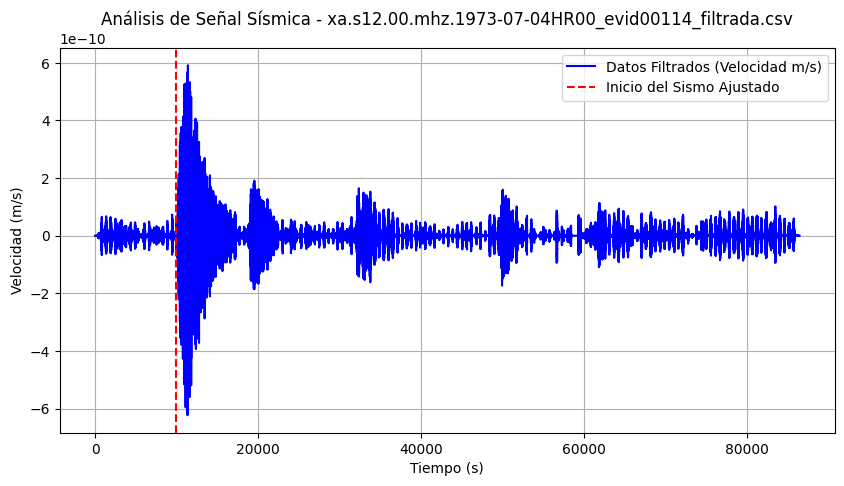

Tiempo ajustado leído: 68520


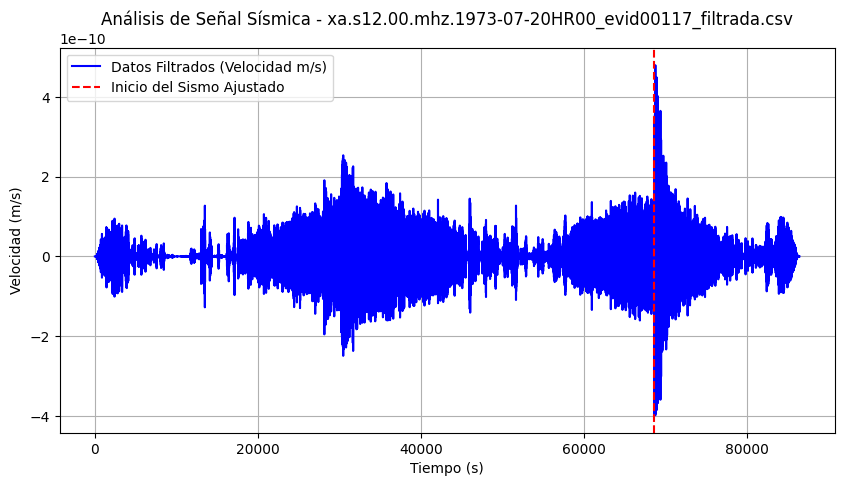

Tiempo ajustado leído: 3120


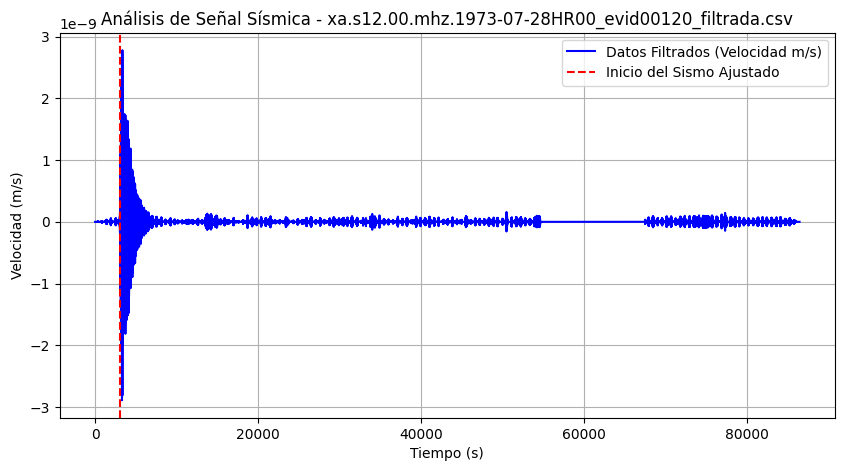

Tiempo ajustado leído: 84660


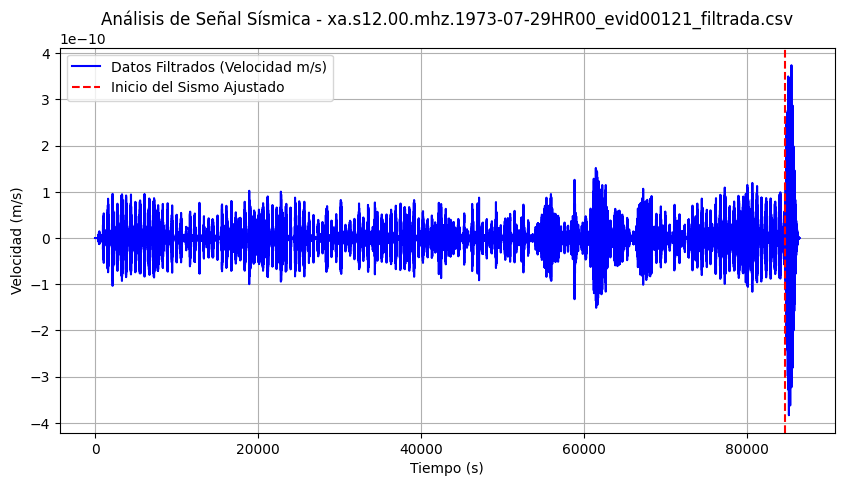

Tiempo ajustado leído: 44220


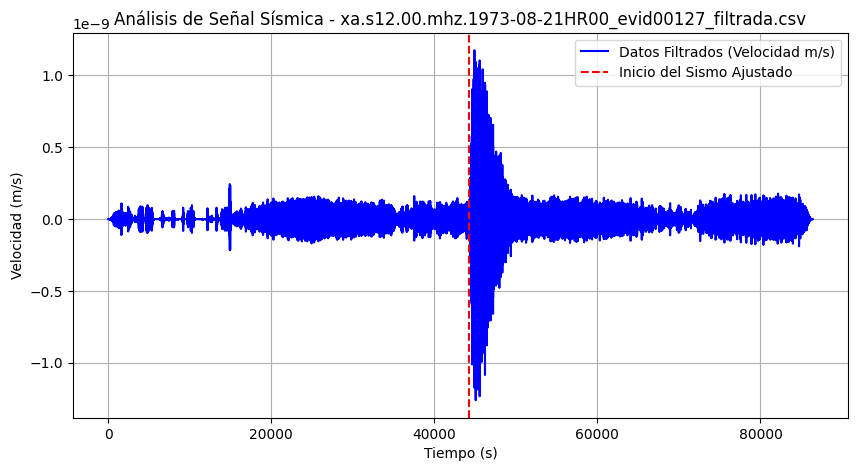

Tiempo ajustado leído: 84060


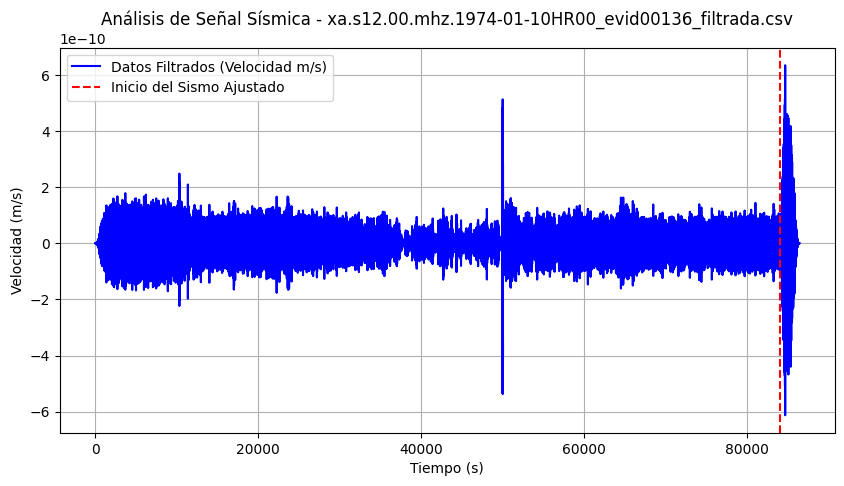

Tiempo ajustado leído: 22860


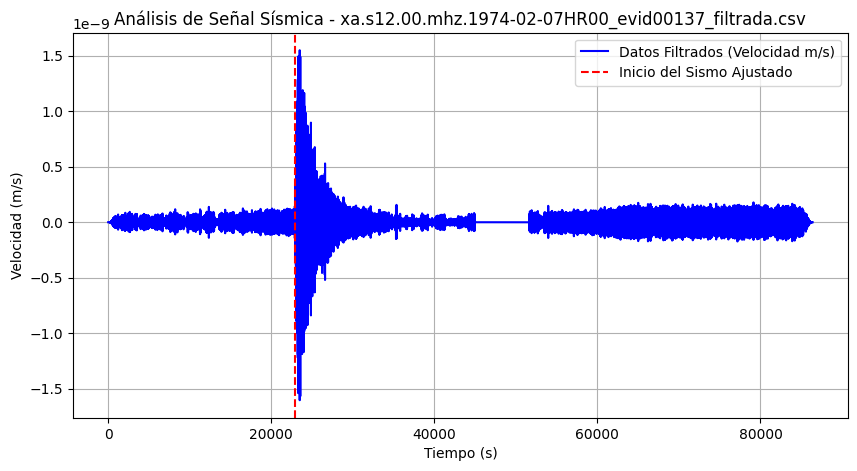

Tiempo ajustado leído: 81000


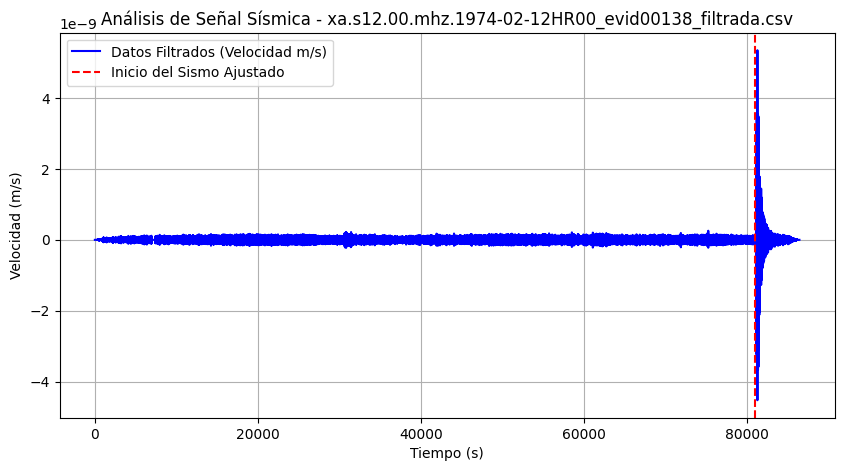

Tiempo ajustado leído: 61080


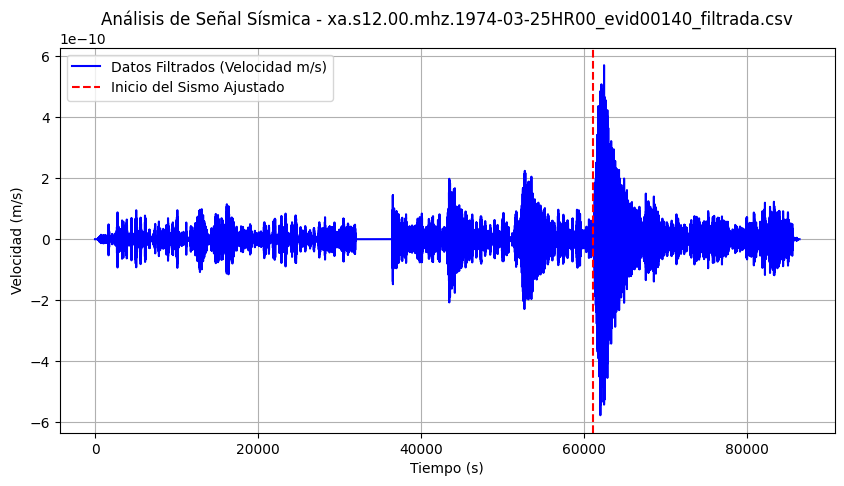

Tiempo ajustado leído: 31200


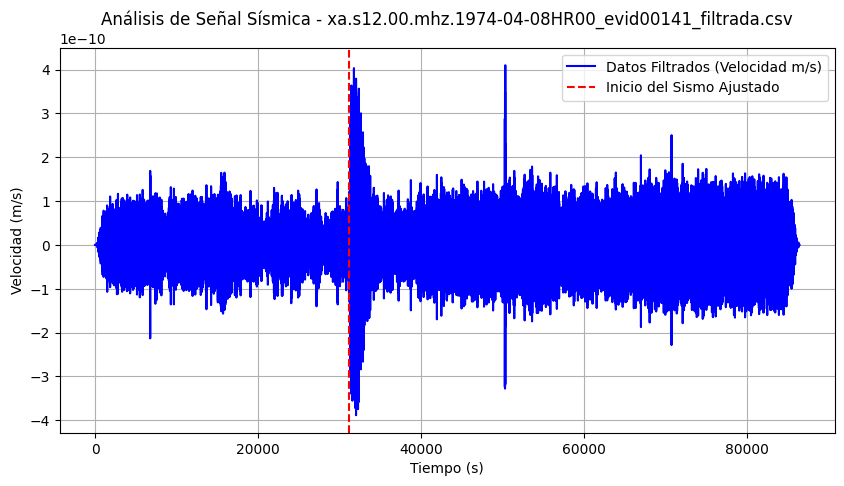

Tiempo ajustado leído: 66840


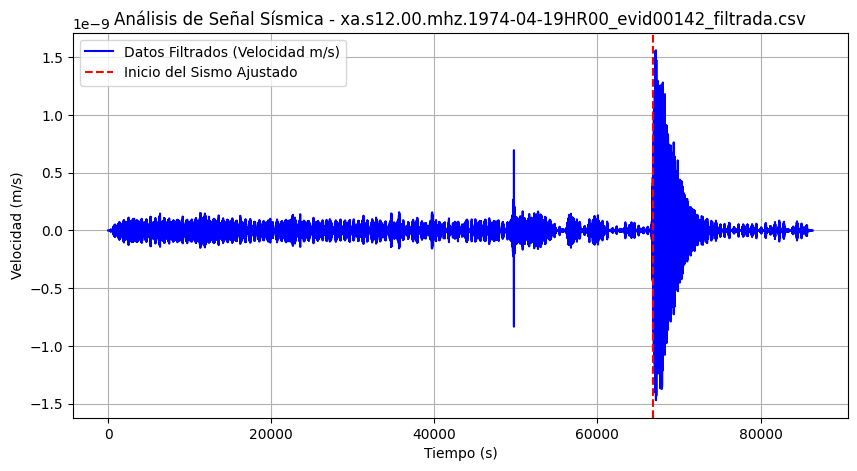

Tiempo ajustado leído: 33480


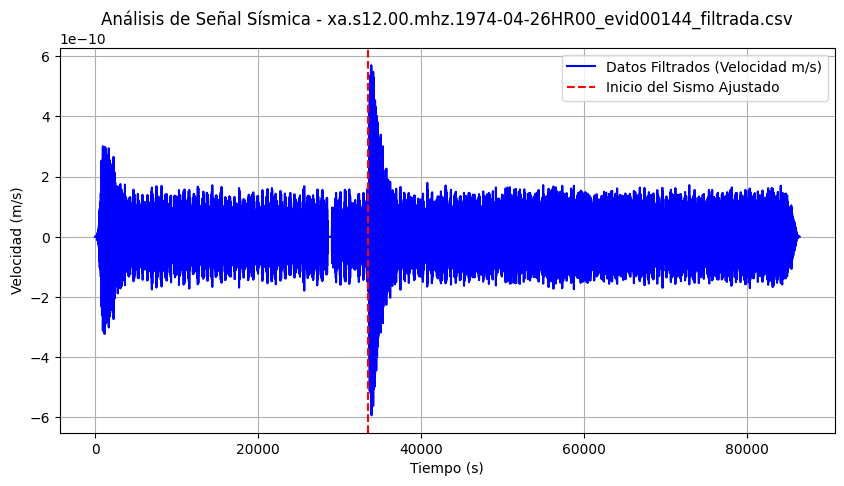

Tiempo ajustado leído: 51480


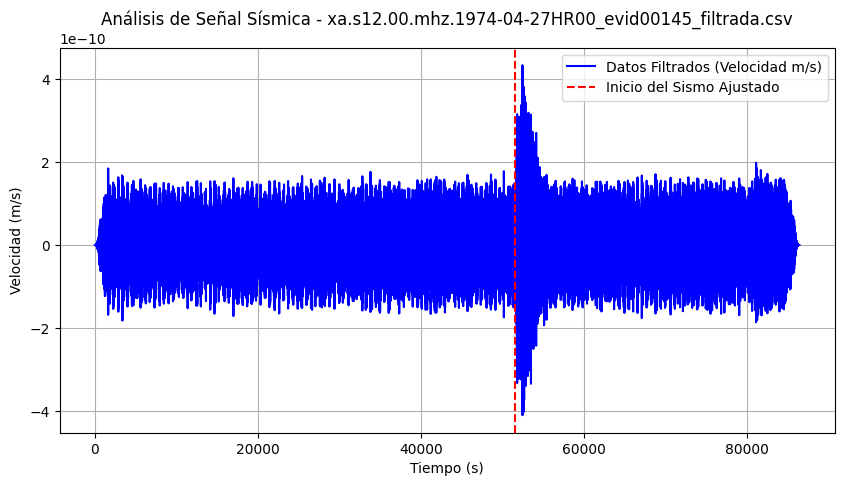

Tiempo ajustado leído: 1380


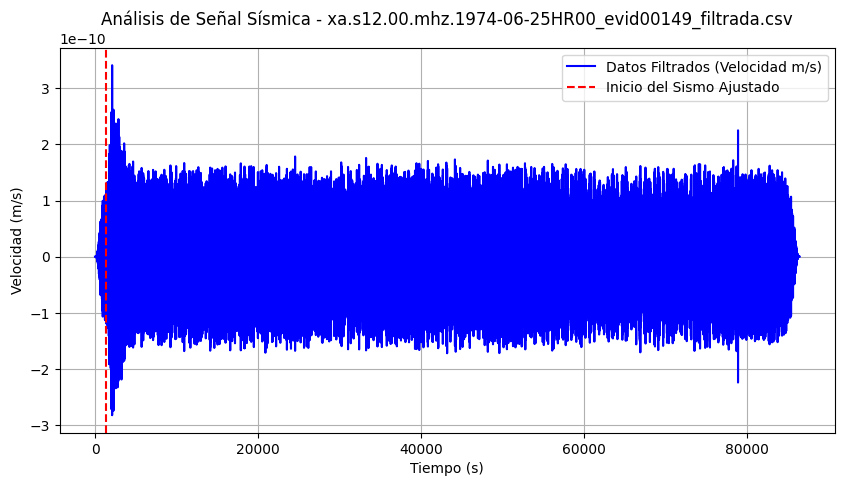

Tiempo ajustado leído: 10620


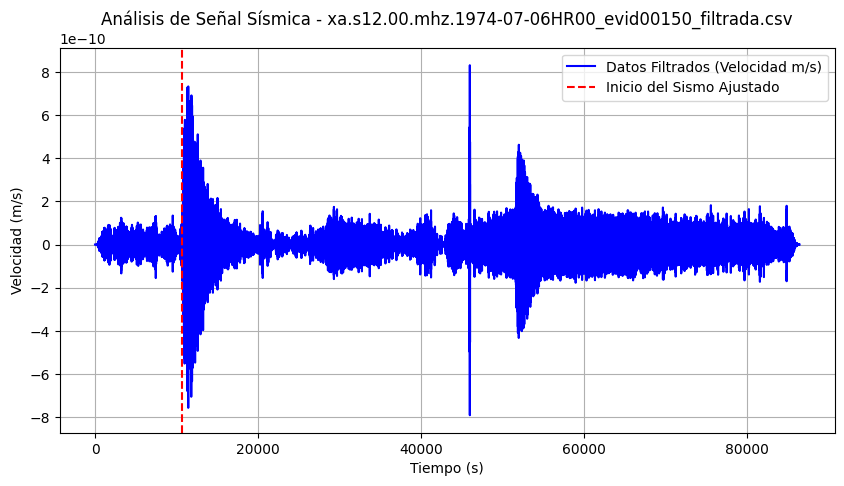

Tiempo ajustado leído: 51240


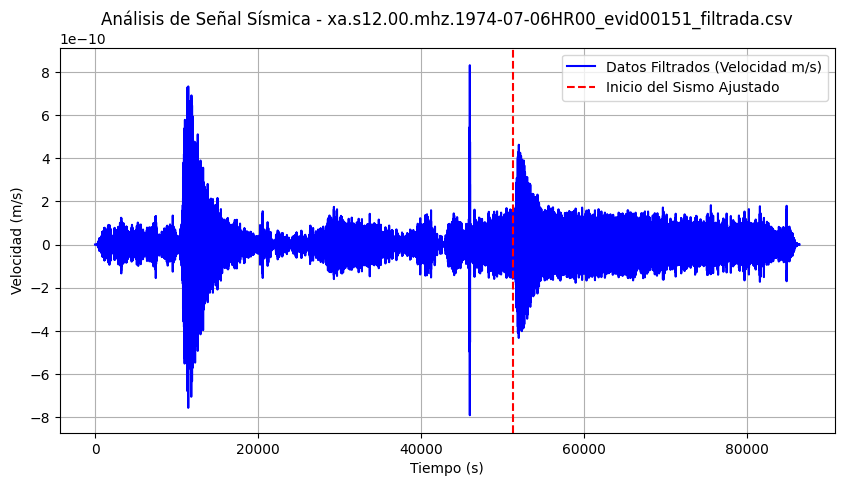

Tiempo ajustado leído: 3120


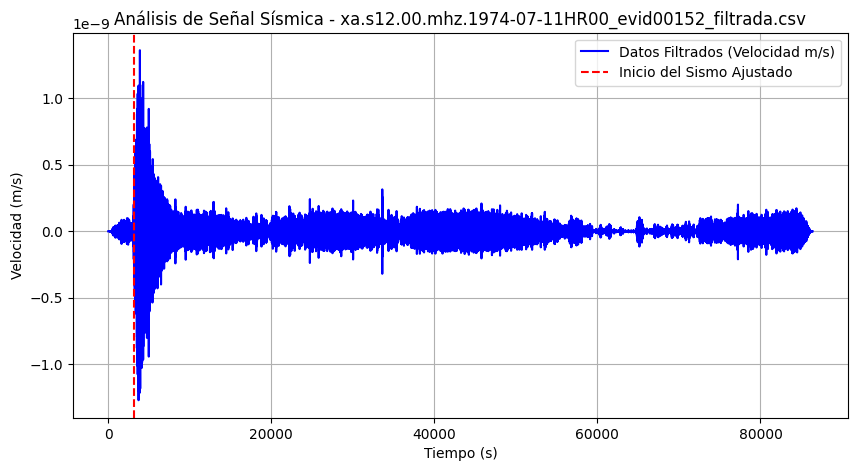

Tiempo ajustado leído: 43500


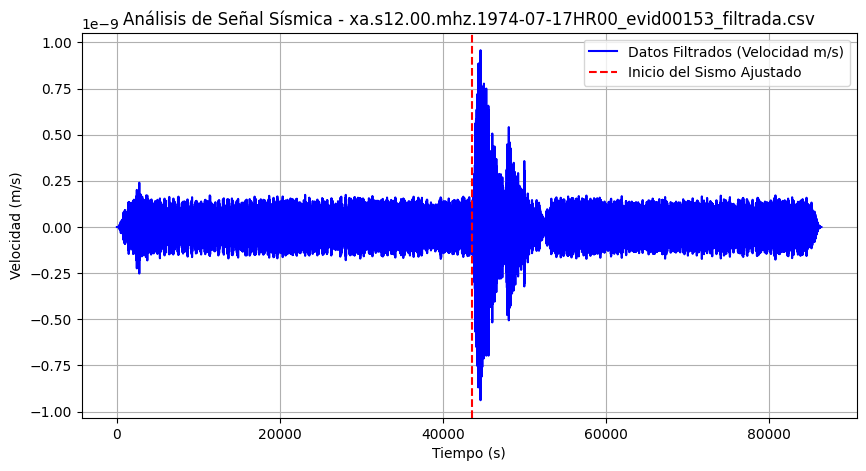

Tiempo ajustado leído: 63780


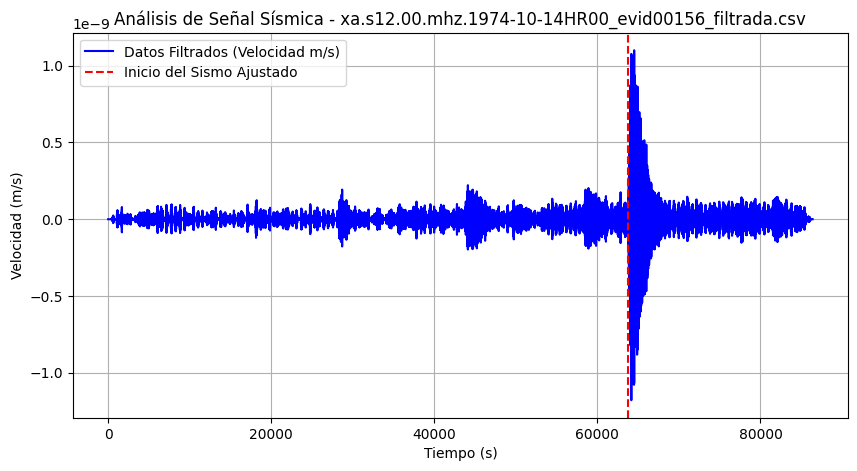

Tiempo ajustado leído: 65700


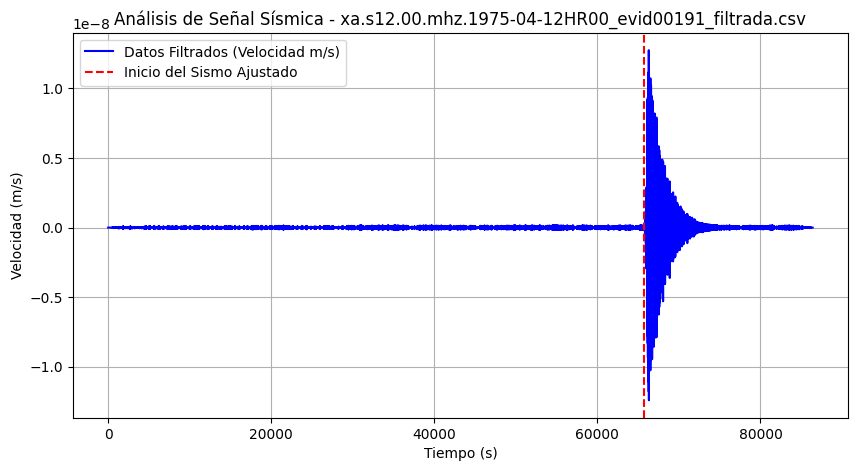

Tiempo ajustado leído: 36300


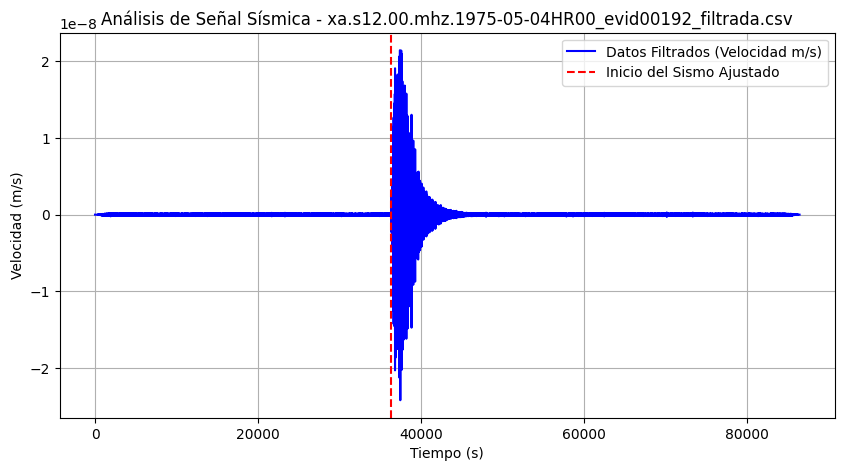

Tiempo ajustado leído: 57780


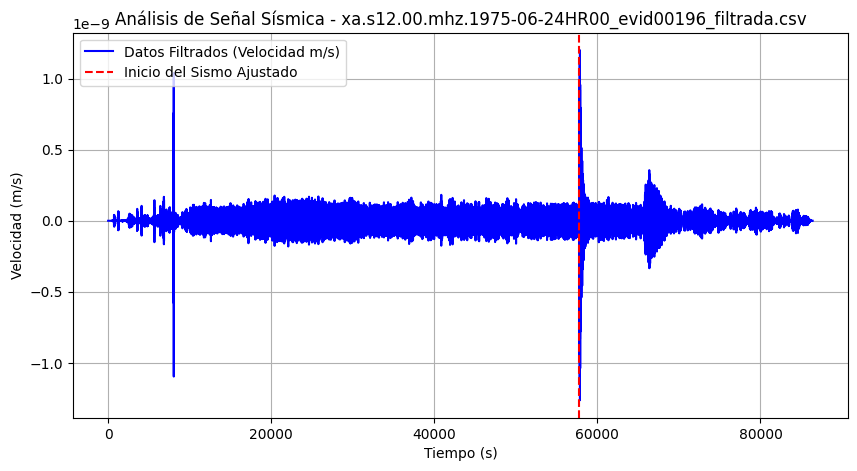

Tiempo ajustado leído: 12240


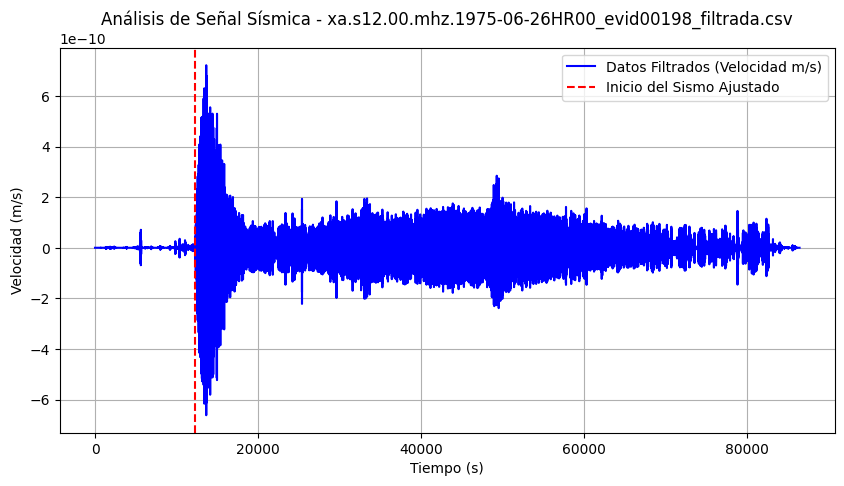

Arreglo de velocidades:
 [array([-4.27718192e-15, -6.41508252e-15, -7.75636770e-15, ...,
        -8.31918857e-15, -6.11276502e-15, -3.65134882e-15])
 array([-3.78985102e-16, -5.67984549e-16, -6.86169947e-16, ...,
        -7.22400389e-16, -5.28045035e-16, -3.14093022e-16])
 array([-1.93193674e-15, -2.89785050e-15, -3.50289003e-15, ...,
        -3.60492430e-15, -2.64252385e-15, -1.57466999e-15])
 array([6.30253276e-16, 9.44904832e-16, 1.14199403e-15, ...,
        1.01767905e-15, 7.37029078e-16, 4.34068445e-16])
 array([-9.84197830e-18, -1.51941688e-17, -1.90190437e-17, ...,
        -4.94551824e-18,  3.26851771e-18,  6.77617342e-18])
 array([-5.96987956e-17, -8.87726254e-17, -1.06414175e-16, ...,
        -1.15004090e-16, -9.01011294e-17, -5.69535298e-17])
 array([-4.46190850e-17, -6.53135915e-17, -7.69846100e-17, ...,
        -7.81784069e-17, -5.59292616e-17, -3.24623764e-17])
 array([-9.97261051e-17, -1.50178257e-16, -1.82485987e-16, ...,
        -1.96352237e-16, -1.44561953e-16, -8.6516

In [81]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import re

# Función para extraer el número de evidencia
def extract_evid_number(filename):
    match = re.search(r'evid(\d+)', filename)
    return int(match.group(1)) if match else None

# Crear una lista de archivos filtrados y ajustados
filtered_folder = 'data_filtrada1'
adjusted_arrivals_folder = 'tiempos_inicio_sismos_ajustados'

# Crear carpetas para almacenar datos
cleaned_data_folder = 'datos_limpios_caracterizados'
catalog_folder = 'new_cat'

os.makedirs(cleaned_data_folder, exist_ok=True)
os.makedirs(catalog_folder, exist_ok=True)

# Obtener la lista de archivos filtrados
filtered_files = [f for f in os.listdir(filtered_folder) if f.endswith('_filtrada.csv')]
adjusted_arrival_files = [f for f in os.listdir(adjusted_arrivals_folder) if f.endswith('_inicio_ajustado.csv')]

# Ordenar las listas por el número de evidencia
sorted_filtered_files = sorted(filtered_files, key=extract_evid_number)
sorted_adjusted_arrival_files = sorted(adjusted_arrival_files, key=extract_evid_number)

# Inicializar listas para almacenar valores de velocidad y tiempos ajustados
velocities = []
adjusted_times = []

# Inicializar DataFrame para el catálogo
catalog_df = pd.DataFrame(columns=['filename', 'adjusted_time'])

# Graficar los datos
for filtered_file, arrival_file in zip(sorted_filtered_files, sorted_adjusted_arrival_files):
    # Cargar datos filtrados
    filtered_data = np.loadtxt(os.path.join(filtered_folder, filtered_file), delimiter=',', skiprows=1)
    time_abs = filtered_data[:, 0]
    velocity = filtered_data[:, 2]

    # Cargar tiempos ajustados
    adjusted_arrival_path = os.path.join(adjusted_arrivals_folder, arrival_file)
    
    if os.path.exists(adjusted_arrival_path):
        adjusted_arrival = np.loadtxt(adjusted_arrival_path, delimiter=',', skiprows=1)
        
        if adjusted_arrival.size == 0:
            print(f"Advertencia: El archivo {arrival_file} está vacío.")
            continue
        
        if np.ndim(adjusted_arrival) == 0:  # Si es un escalar
            adjusted_time = int(adjusted_arrival)  # Asignar directamente como entero
        else:
            adjusted_time = int(adjusted_arrival[0])  # Para arreglos
        
        print(f"Tiempo ajustado leído: {adjusted_time}")
    else:
        print(f"Advertencia: El archivo {arrival_file} no se encontró.")
        continue

    # Graficar
    plt.figure(figsize=(10, 5))
    plt.plot(time_abs, velocity, label='Datos Filtrados (Velocidad m/s)', color='blue')

    # Agregar la línea de llegada del sismo ajustada
    if adjusted_time >= time_abs[0] and adjusted_time <= time_abs[-1]:
        plt.axvline(x=adjusted_time, color='red', linestyle='--', label='Inicio del Sismo Ajustado')
    else:
        print(f"Advertencia: El tiempo ajustado {adjusted_time} está fuera del rango de la señal filtrada.")
    
    # Títulos y etiquetas
    plt.title(f'Análisis de Señal Sísmica - {filtered_file.strip()}')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Velocidad (m/s)')
    plt.legend()
    plt.grid()
    
    # Mostrar la gráfica
    plt.show()

    # Almacenar los datos de velocidad y tiempo ajustado en listas
    velocities.append(velocity)
    adjusted_times.append(adjusted_time)

    # Guardar el DataFrame de datos limpios
    cleaned_data_df = pd.DataFrame({
        'time_abs': time_abs,
        'velocity': velocity
    })
    cleaned_data_path = os.path.join(cleaned_data_folder, f'{filtered_file[:-4]}_limpio.csv')
    cleaned_data_df.to_csv(cleaned_data_path, index=False)
    
    # Añadir a catálogo usando pd.concat
    new_row = pd.DataFrame({'filename': [filtered_file], 'adjusted_time': [adjusted_time]})
    catalog_df = pd.concat([catalog_df, new_row], ignore_index=True)

# Guardar catálogo en CSV
catalog_path = os.path.join(catalog_folder, 'catalogo_incidencias.csv')
catalog_df.to_csv(catalog_path, index=False)

# Convertir listas a arreglos de NumPy
x = np.array(velocities, dtype=object)  # Arreglo de velocidades
y = np.array(adjusted_times)  # Arreglo de tiempos ajustados

# Imprimir los arreglos resultantes
print("Arreglo de velocidades:\n", x)
print("Arreglo de tiempos ajustados:\n", y)
print("Gráficas generadas y datos almacenados.")


In [87]:

from keras.models import Sequential
from keras.layers import Dense
from sklearn.model_selection import KFold

def min_max_normalization(data):
    """Normaliza los datos utilizando la técnica Min-Max."""
    min_val = np.min(data)
    max_val = np.max(data)
    normalized_data = (data - min_val) / (max_val - min_val)
    return normalized_data

# Supón que velocities y adjusted_times están definidos aquí
# velocities = [...]
# adjusted_times = [...]

# Verificar longitudes
lengths = [len(v) for v in velocities]
print(f"Longitudes de las listas de velocidades: {lengths}")

# Definir longitud objetivo
target_length = max(lengths)  # O define un tamaño específico según tus necesidades

# Rellenar o recortar las listas
padded_velocities = []
for velocity in velocities:
    if len(velocity) < target_length:
        padded_velocity = np.pad(velocity, (0, target_length - len(velocity)), 'constant')
    else:
        padded_velocity = velocity[:target_length]
    padded_velocities.append(padded_velocity)

# Convertir listas a arreglos de NumPy
x = np.array(padded_velocities, dtype=float)  # Velocidades de datos sísmicos
y = np.array(adjusted_times, dtype=float)  # Tiempos ajustados

# Normalizar datos de velocidad (x)
n_x = np.array([min_max_normalization(v) for v in x])

# Normalizar tiempos ajustados (y)
n_y = min_max_normalization(y)

# Asegurarse de que n_x y n_y tengan las formas correctas
print(f"n_x shape: {n_x.shape}")
print(f"n_y shape: {n_y.shape}")

# Configurar la red neuronal
def create_model(input_dim):
    model = Sequential()
    model.add(Dense(18, input_dim=input_dim, activation='relu'))
    model.add(Dense(14, activation='relu'))
    model.add(Dense(8, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))  # Cambiar a 'linear' si la salida es continua
    model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mae'])
    return model

# Validación cruzada
kf = KFold(n_splits=5, shuffle=True, random_state=42)
for train_index, test_index in kf.split(n_x):
    x_train, x_test = n_x[train_index], n_x[test_index]
    y_train, y_test = n_y[train_index], n_y[test_index]
    
    model = create_model(input_dim=x_train.shape[1])
    model.fit(x_train, y_train, epochs=50, batch_size=10, verbose=0)

    # Evaluar el modelo
    loss, mae = model.evaluate(x_test, y_test, verbose=0)
    print(f"Loss: {loss:.4f}, MAE: {mae:.4f}")

    # Realizar predicciones y mostrar algunos resultados
    predictions = model.predict(x_test)
    for i in range(min(5, len(predictions))):  # Imprimir solo las primeras 5 predicciones
        print(f"Predicción: {predictions[i][0]:.4f}, Real: {y_test[i]:.4f}")

Longitudes de las listas de velocidades: [572415, 572411, 572411, 572415, 572411, 572418, 572423, 572411, 572411, 572423, 572420, 572411, 572415, 572423, 572411, 572411, 572423, 572423, 572411, 572427, 474915, 572418, 572407, 572407, 572411, 572423, 572418, 572399, 572399, 572399, 572418, 572399, 572418, 572399, 572399, 572399, 572399, 572399, 572418, 572415, 572399, 572399, 572415, 572395, 572399, 342378, 572263, 572415, 572395, 572395, 572418, 572399, 572395, 572395, 572418, 572395, 572395, 572411, 572418, 572418, 572415, 572390, 572411, 572386, 572386, 572383, 572423, 572411, 572411, 572415, 572423, 572418, 572423, 572418, 572411, 572407]
n_x shape: (76, 572427)
n_y shape: (76,)
Loss: 0.4304, MAE: 0.5819
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Predicción: 1.0000, Real: 0.8660
Predicción: 1.0000, Real: 0.6095
Predicción: 1.0000, Real: 0.4813
Predicción: 1.0000, Real: 0.3019
Predicción: 1.0000, Real: 0.1434
Loss: 0.3083, MAE: 0.4995
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Predicción: 0.00

In [89]:

from keras.models import Sequential
from keras.layers import Dense
from sklearn.model_selection import KFold

def min_max_normalization(data):
    """Normaliza los datos utilizando la técnica Min-Max."""
    min_val = np.min(data)
    max_val = np.max(data)
    normalized_data = (data - min_val) / (max_val - min_val)
    return normalized_data

# Supón que velocities y adjusted_times están definidos aquí
# velocities = [...]
# adjusted_times = [...]

# Verificar longitudes
lengths = [len(v) for v in velocities]
print(f"Longitudes de las listas de velocidades: {lengths}")

# Definir longitud objetivo
target_length = max(lengths)  # O define un tamaño específico según tus necesidades

# Rellenar o recortar las listas
padded_velocities = []
for velocity in velocities:
    if len(velocity) < target_length:
        padded_velocity = np.pad(velocity, (0, target_length - len(velocity)), 'constant')
    else:
        padded_velocity = velocity[:target_length]
    padded_velocities.append(padded_velocity)

# Convertir listas a arreglos de NumPy
x = np.array(padded_velocities, dtype=float)  # Velocidades de datos sísmicos
y = np.array(adjusted_times, dtype=float)  # Tiempos ajustados

# Normalizar datos de velocidad (x)
n_x = np.array([min_max_normalization(v) for v in x])

# Normalizar tiempos ajustados (y)
n_y = min_max_normalization(y)

# Asegurarse de que n_x y n_y tengan las formas correctas
print(f"n_x shape: {n_x.shape}")
print(f"n_y shape: {n_y.shape}")

# Configurar la red neuronal
def create_model(input_dim):
    model = Sequential()
    model.add(Dense(18, input_dim=input_dim, activation='relu'))
    model.add(Dense(14, activation='relu'))
    model.add(Dense(8, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))  # Cambiar a 'linear' si la salida es continua
    model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mae'])
    return model

# Validación cruzada
kf = KFold(n_splits=5, shuffle=True, random_state=42)
for train_index, test_index in kf.split(n_x):
    x_train, x_test = n_x[train_index], n_x[test_index]
    y_train, y_test = n_y[train_index], n_y[test_index]
    
    model = create_model(input_dim=x_train.shape[1])
    model.fit(x_train, y_train, epochs=50, batch_size=10, verbose=0)

    # Evaluar el modelo
    loss, mae = model.evaluate(x_test, y_test, verbose=0)
    print(f"Loss: {loss:.4f}, MAE: {mae:.4f}")

    # Realizar predicciones y mostrar algunos resultados
    predictions = model.predict(x_test)
    for i in range(min(5, len(predictions))):  # Imprimir solo las primeras 5 predicciones
        print(f"Predicción: {predictions[i][0]:.4f}, Real: {y_test[i]:.4f}")

Longitudes de las listas de velocidades: [572415, 572411, 572411, 572415, 572411, 572418, 572423, 572411, 572411, 572423, 572420, 572411, 572415, 572423, 572411, 572411, 572423, 572423, 572411, 572427, 474915, 572418, 572407, 572407, 572411, 572423, 572418, 572399, 572399, 572399, 572418, 572399, 572418, 572399, 572399, 572399, 572399, 572399, 572418, 572415, 572399, 572399, 572415, 572395, 572399, 342378, 572263, 572415, 572395, 572395, 572418, 572399, 572395, 572395, 572418, 572395, 572395, 572411, 572418, 572418, 572415, 572390, 572411, 572386, 572386, 572383, 572423, 572411, 572411, 572415, 572423, 572418, 572423, 572418, 572411, 572407]
n_x shape: (76, 572427)
n_y shape: (76,)
Loss: 0.4304, MAE: 0.5819
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Predicción: 1.0000, Real: 0.8660
Predicción: 1.0000, Real: 0.6095
Predicción: 1.0000, Real: 0.4813
Predicción: 1.0000, Real: 0.3019
Predicción: 1.0000, Real: 0.1434
Loss: 0.3083, MAE: 0.4995
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Predicción: 0.00